# Data Preprocessing

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from pyspark.sql.functions import *
from pyspark.sql.types import *
from pyspark.ml.feature import *
from functools import reduce
from pyspark.ml import *
from sklearn import preprocessing
from pyspark.ml.feature import Imputer
from pyspark.ml.classification import LogisticRegression


## Load the data

In [ ]:
train = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train.csv")
test = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test.csv")

In [ ]:
SalePrice_train = train.select("SalePrice")

## Feature 1-20

In [ ]:
df_raw_train = train

# select columns: No.1-21 variables
select_columns = df_raw_train.columns[1:21]
df_train = df_raw_train[select_columns]

# create a new spark dataframe in order to save the preprocessing results step by step
schema = StructType([StructField("MSSubClass",StringType(),False),
                     StructField("MSZoning",StringType(),False),
                     StructField("LotFrontage",IntegerType(),False),
                     StructField("LotArea",IntegerType(),False),
                     StructField("LotShape",IntegerType(),False),
                     StructField("LotConfig",StringType(),False),
                     StructField("Neighborhood",StringType(),False),
                     StructField("BldgType",StringType(),False),
                     StructField("HouseStyle",StringType(),False),
                     StructField("OverallQual",IntegerType(),False),
                     StructField("OverallCond",IntegerType(),False),
                     StructField("YearBuilt",IntegerType(),False),
                     StructField("YearRemodAdd",IntegerType(),False)])

df_final_pd = pd.DataFrame(columns = df_train.columns)
train_1_20 = spark.createDataFrame(df_final_pd, schema)

# delete features
del_features = ['Street', 'Alley', 'LandContour', 'Utilities', 'LandSlope', 'Condition1', 'Condition2']
save_features = df_train.columns
for i in del_features:
    save_features.remove(i)
df_train = df_train[save_features]

# Categorical Variables - lumping
# MSSubClass: 20, 50, 60, 120, others
df_train = df_train.withColumn('MSSubClass_new', 
                             when((col("MSSubClass") == 20), 20)
                            .when((col("MSSubClass") == 50), 50)
                            .when((col("MSSubClass") == 60), 60)
                            .when((col("MSSubClass") == 120), 120)
                            .otherwise("others"))
# MSZoning: RL, RM, others
df_train = df_train.withColumn('MSZoning_new', 
                             when((col("MSZoning") == 'RL'), 'RL')
                            .when((col("MSZoning") == 'RM'), 'RM')
                            .otherwise("others"))
# LotShape: Reg, IR
df_train = df_train.withColumn('LotShape_new', 
                             when((col("LotShape") == 'Reg'), 'Reg')
                            .otherwise("IR"))
# LotConfig: Inside, Corner, CulDSac, others
df_train = df_train.withColumn('LotConfig_new', 
                             when((col("LotConfig") == 'Inside'), 'Inside')
                            .when((col("LotConfig") == 'Corner'), 'Corner')
                            .when((col("LotConfig") == 'CulDSac'), 'CulDSac')
                            .otherwise("others"))
df_train = df_train.withColumn('Neighborhood_new',col("Neighborhood"))
# HouseStyle: NAmes, CollgCr, OldTown, Edwards, Somerst, Gilbert, NridgHt, Sawyer, NWAmes, BrkSide, others
df_train = df_train.withColumn('HouseStyle_new', 
                             when((col("HouseStyle") == '1Story'), '1Story')
                            .when((col("HouseStyle") == '2Story'), '2Story')
                            .when((col("HouseStyle") == '1.5Fin'), '1.5Story')      
                            .when((col("HouseStyle") == '1.5Unf'), '1.5Story')     
                            .otherwise("others"))

# Categorical Variable - label encoding
# BldgType: 2fmCon: 1, 1Fam: 2, Duplex: 3, Twnhs: 4, TwnhsE: 5
df_train = df_train.withColumn('BldgType_new', 
                             when((col("BldgType") == '2fmCon'), 1)
                            .when((col("BldgType") == '1Fam'), 2)
                            .when((col("BldgType") == 'Duplex'), 3)      
                            .when((col("BldgType") == 'Twnhs'), 4)     
                            .when((col("BldgType") == 'TwnhsE'), 5))  

# Numerical Variables - LotFrontage: fill na with mean
df_train = df_train.withColumn("Int"+"LotFrontage", df_train['LotFrontage'].cast("integer")).drop('LotFrontage')
imputer = Imputer(inputCols=['IntLotFrontage'], outputCols=['LotFrontage_new'])
imput_model = imputer.fit(df_train)
df_train = imput_model.transform(df_train)

# Save data
df_train = df_train.withColumn('LotArea_new', df_train['LotArea'])
df_train = df_train.withColumn('OverallQual_new', df_train['OverallQual'])
df_train = df_train.withColumn('OverallCond_new', df_train['OverallCond'])
df_train = df_train.withColumn('YearBuilt_new', df_train['YearBuilt'])
df_train = df_train.withColumn('YearRemodAdd_new', df_train['YearRemodAdd'])
df_train = df_train.drop('IntLotFrontage')
for i in train_1_20.columns:
    df_train = df_train.drop(i)
df_train = df_train.withColumn('MSSubClass', df_train['MSSubClass_new'])
df_train = df_train.withColumn('MSZoning', df_train['MSZoning_new'])
df_train = df_train.withColumn('LotFrontage', df_train['LotFrontage_new'])
df_train = df_train.withColumn('LotArea', df_train['LotArea_new'])
df_train = df_train.withColumn('LotShape', df_train['LotShape_new'])
df_train = df_train.withColumn('LotConfig', df_train['LotConfig_new'])
df_train = df_train.withColumn('Neighborhood', df_train['Neighborhood_new'])
df_train = df_train.withColumn('BldgType', df_train['BldgType_new'])
df_train = df_train.withColumn('HouseStyle', df_train['HouseStyle_new'])
df_train = df_train.withColumn('OverallQual', df_train['OverallQual_new'])
df_train = df_train.withColumn('OverallCond', df_train['OverallCond_new'])
df_train = df_train.withColumn('YearBuilt', df_train['YearBuilt_new'])
df_train = df_train.withColumn('YearRemodAdd', df_train['YearRemodAdd_new'])
final_columns = df_train.columns[13:26]
train_1_20 = df_train[final_columns]
display(train_1_20)

MSSubClass,MSZoning,LotFrontage,LotArea,LotShape,LotConfig,Neighborhood,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd
60,RL,65,8450,Reg,Inside,CollgCr,2,2Story,7,5,2003,2003
20,RL,80,9600,Reg,others,Veenker,2,1Story,6,8,1976,1976
60,RL,68,11250,IR,Inside,CollgCr,2,2Story,7,5,2001,2002
others,RL,60,9550,IR,Corner,Crawfor,2,2Story,7,5,1915,1970
60,RL,84,14260,IR,others,NoRidge,2,2Story,8,5,2000,2000
50,RL,85,14115,IR,Inside,Mitchel,2,1.5Story,5,5,1993,1995
20,RL,75,10084,Reg,Inside,Somerst,2,1Story,8,5,2004,2005
60,RL,70,10382,IR,Corner,NWAmes,2,2Story,7,6,1973,1973
50,RM,51,6120,Reg,Inside,OldTown,2,1.5Story,7,5,1931,1950
others,RL,50,7420,Reg,Corner,BrkSide,1,1.5Story,5,6,1939,1950


In [ ]:
train_1_20 = train_1_20.withColumn("id", monotonically_increasing_id())

In [ ]:
# Do everything the same for testing data (here 'train' labels are not changed to 'test')
df_raw_train = test

# select columns: No.1-21 variables
select_columns = df_raw_train.columns[1:21]
df_train = df_raw_train[select_columns]

# create a new spark dataframe in order to save the preprocessing results step by step
schema = StructType([StructField("MSSubClass",StringType(),False),
                     StructField("MSZoning",StringType(),False),
                     StructField("LotFrontage",IntegerType(),False),
                     StructField("LotArea",IntegerType(),False),
                     StructField("LotShape",IntegerType(),False),
                     StructField("LotConfig",StringType(),False),
                     StructField("Neighborhood",StringType(),False),
                     StructField("BldgType",StringType(),False),
                     StructField("HouseStyle",StringType(),False),
                     StructField("OverallQual",IntegerType(),False),
                     StructField("OverallCond",IntegerType(),False),
                     StructField("YearBuilt",IntegerType(),False),
                     StructField("YearRemodAdd",IntegerType(),False)])

df_final_pd = pd.DataFrame(columns = df_train.columns)
test_1_20 = spark.createDataFrame(df_final_pd, schema)

# delete features
del_features = ['Street', 'Alley', 'LandContour', 'Utilities', 'LandSlope', 'Condition1', 'Condition2']
save_features = df_train.columns
for i in del_features:
    save_features.remove(i)
df_train = df_train[save_features]

# Categorical Variables - lumping
# MSSubClass: 20, 50, 60, 120, others
df_train = df_train.withColumn('MSSubClass_new', 
                             when((col("MSSubClass") == 20), 20)
                            .when((col("MSSubClass") == 50), 50)
                            .when((col("MSSubClass") == 60), 60)
                            .when((col("MSSubClass") == 120), 120)
                            .otherwise("others"))
# MSZoning: RL, RM, others
df_train = df_train.withColumn('MSZoning_new', 
                             when((col("MSZoning") == 'RL'), 'RL')
                            .when((col("MSZoning") == 'RM'), 'RM')
                            .otherwise("others"))
# LotShape: Reg, IR
df_train = df_train.withColumn('LotShape_new', 
                             when((col("LotShape") == 'Reg'), 'Reg')
                            .otherwise("IR"))
# LotConfig: Inside, Corner, CulDSac, others
df_train = df_train.withColumn('LotConfig_new', 
                             when((col("LotConfig") == 'Inside'), 'Inside')
                            .when((col("LotConfig") == 'Corner'), 'Corner')
                            .when((col("LotConfig") == 'CulDSac'), 'CulDSac')
                            .otherwise("others"))
df_train = df_train.withColumn('Neighborhood_new',col("Neighborhood"))
# HouseStyle: NAmes, CollgCr, OldTown, Edwards, Somerst, Gilbert, NridgHt, Sawyer, NWAmes, BrkSide, others
df_train = df_train.withColumn('HouseStyle_new', 
                             when((col("HouseStyle") == '1Story'), '1Story')
                            .when((col("HouseStyle") == '2Story'), '2Story')
                            .when((col("HouseStyle") == '1.5Fin'), '1.5Story')      
                            .when((col("HouseStyle") == '1.5Unf'), '1.5Story')     
                            .otherwise("others"))

# Categorical Variable - label encoding
# BldgType: 2fmCon: 1, 1Fam: 2, Duplex: 3, Twnhs: 4, TwnhsE: 5
df_train = df_train.withColumn('BldgType_new', 
                             when((col("BldgType") == '2fmCon'), 1)
                            .when((col("BldgType") == '1Fam'), 2)
                            .when((col("BldgType") == 'Duplex'), 3)      
                            .when((col("BldgType") == 'Twnhs'), 4)     
                            .when((col("BldgType") == 'TwnhsE'), 5))  

# Numerical Variables - LotFrontage: fill na with mean
df_train = df_train.withColumn("Int"+"LotFrontage", df_train['LotFrontage'].cast("integer")).drop('LotFrontage')
imputer = Imputer(inputCols=['IntLotFrontage'], outputCols=['LotFrontage_new'])
imput_model = imputer.fit(df_train)
df_train = imput_model.transform(df_train)

# Save data
df_train = df_train.withColumn('LotArea_new', df_train['LotArea'])
df_train = df_train.withColumn('OverallQual_new', df_train['OverallQual'])
df_train = df_train.withColumn('OverallCond_new', df_train['OverallCond'])
df_train = df_train.withColumn('YearBuilt_new', df_train['YearBuilt'])
df_train = df_train.withColumn('YearRemodAdd_new', df_train['YearRemodAdd'])
df_train = df_train.drop('IntLotFrontage')
for i in test_1_20.columns:
    df_train = df_train.drop(i)
df_train = df_train.withColumn('MSSubClass', df_train['MSSubClass_new'])
df_train = df_train.withColumn('MSZoning', df_train['MSZoning_new'])
df_train = df_train.withColumn('LotFrontage', df_train['LotFrontage_new'])
df_train = df_train.withColumn('LotArea', df_train['LotArea_new'])
df_train = df_train.withColumn('LotShape', df_train['LotShape_new'])
df_train = df_train.withColumn('LotConfig', df_train['LotConfig_new'])
df_train = df_train.withColumn('Neighborhood', df_train['Neighborhood_new'])
df_train = df_train.withColumn('BldgType', df_train['BldgType_new'])
df_train = df_train.withColumn('HouseStyle', df_train['HouseStyle_new'])
df_train = df_train.withColumn('OverallQual', df_train['OverallQual_new'])
df_train = df_train.withColumn('OverallCond', df_train['OverallCond_new'])
df_train = df_train.withColumn('YearBuilt', df_train['YearBuilt_new'])
df_train = df_train.withColumn('YearRemodAdd', df_train['YearRemodAdd_new'])
final_columns = df_train.columns[13:26]
test_1_20 = df_train[final_columns]
display(test_1_20)

MSSubClass,MSZoning,LotFrontage,LotArea,LotShape,LotConfig,Neighborhood,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd
20,others,80,11622,Reg,Inside,NAmes,2,1Story,5,6,1961,1961
20,RL,81,14267,IR,Corner,NAmes,2,1Story,6,6,1958,1958
60,RL,74,13830,IR,Inside,Gilbert,2,2Story,5,5,1997,1998
60,RL,78,9978,IR,Inside,Gilbert,2,2Story,6,6,1998,1998
120,RL,43,5005,IR,Inside,StoneBr,5,1Story,8,5,1992,1992
60,RL,75,10000,IR,Corner,Gilbert,2,2Story,6,5,1993,1994
20,RL,68,7980,IR,Inside,Gilbert,2,1Story,6,7,1992,2007
60,RL,63,8402,IR,Inside,Gilbert,2,2Story,6,5,1998,1998
20,RL,85,10176,Reg,Inside,Gilbert,2,1Story,7,5,1990,1990
20,RL,70,8400,Reg,Corner,NAmes,2,1Story,4,5,1970,1970


In [ ]:
test_1_20 = test_1_20.withColumn("id", monotonically_increasing_id())

## Feature 21-40

In [ ]:
trainRawDF = train
cols = ['RoofStyle',
 'RoofMatl',
 'Exterior1st',
 'Exterior2nd',
 'MasVnrType',
 'MasVnrArea',
 'ExterQual',
 'ExterCond',
 'Foundation',
 'BsmtQual',
 'BsmtCond',
 'BsmtExposure',
 'BsmtFinType1',
 'BsmtFinSF1',
 'BsmtFinType2',
 'BsmtFinSF2',
 'BsmtUnfSF',
 'TotalBsmtSF',
 'Heating',
 'HeatingQC']
trainRawDF = trainRawDF.select(cols)

# Data Integration - Adjust data types
train_21_40 = trainRawDF.withColumn("MasVnrArea", col("MasVnrArea").cast("integer")) 

# Dealing with Missingness
# mode
cnts = train_21_40.groupby("MasVnrType").count()
mode = cnts.join(cnts.agg(max("count").alias("max_")), col("count") == col("max_")).limit(1).select("MasVnrType")
mode_value = mode.first()[0]
train_21_40 = train_21_40.withColumn("MasVnrType",when(train_21_40.MasVnrType == "NA",mode_value).otherwise(train_21_40.MasVnrType))
# mean
mean_val_train = train_21_40.select(mean(train_21_40['MasVnrArea'])).collect()
mean_val_train = int(mean_val_train[0][0])
train_21_40 = train_21_40.withColumn("MasVnrArea",when(train_21_40.MasVnrArea.isNull(), mean_val_train).otherwise(train_21_40.MasVnrArea))

# Feature Filtering
train_21_40 = train_21_40.drop("RoofMatl","Exterior2nd","heating")

# Lumping
# RoofStyle
train_21_40 = train_21_40.withColumn("RoofStyle",when((train_21_40.RoofStyle == "Flat") | (train_21_40.RoofStyle == "Gambrel") | (train_21_40.RoofStyle == "Mansard") | (train_21_40.RoofStyle == "Shed"),"Other").otherwise(train_21_40.RoofStyle))  
# Exterior1st
train_21_40 = train_21_40.withColumn("Exterior1st",when((train_21_40.Exterior1st == "BrkFace") | (train_21_40.Exterior1st == "WdShing") | (train_21_40.Exterior1st == "Stucco") | (train_21_40.Exterior1st == "AsbShng") | (train_21_40.Exterior1st == "Stone") | (train_21_40.Exterior1st == "BrkComm") | (train_21_40.Exterior1st == "ImStucc") | (train_21_40.Exterior1st == "AsphShn") | (train_21_40.Exterior1st == "CBlock"),"Other").otherwise(train_21_40.Exterior1st))  
# MasVnrType
train_21_40 = train_21_40.withColumn("MasVnrType",when((train_21_40.MasVnrType == "BrkFace") | (train_21_40.MasVnrType == "BrkCmn"),"BrkFaceCmn").otherwise(train_21_40.MasVnrType))  
# Foundation
train_21_40 = train_21_40.withColumn("Foundation",when((train_21_40.Foundation == "Slab") | (train_21_40.Foundation == "Stone") | (train_21_40.Foundation == "Wood") ,"Other").otherwise(train_21_40.Foundation))  

# Label Encoding
# ExterQual
train_21_40 = train_21_40.withColumn("ExterQual",when(train_21_40.ExterQual == "Po",lit(1)).when(train_21_40.ExterQual == "Fa",lit(2)).when(train_21_40.ExterQual == "TA",lit(3)).when(train_21_40.ExterQual == "Gd",lit(4)).when(train_21_40.ExterQual == "Ex",lit(5)))  
# ExterCond
train_21_40 = train_21_40.withColumn("ExterCond",when(train_21_40.ExterCond == "Po",lit(1)).when(train_21_40.ExterCond == "Fa",lit(2)).when(train_21_40.ExterCond == "TA",lit(3)).when(train_21_40.ExterCond == "Gd",lit(4)).when(train_21_40.ExterCond == "Ex",lit(5)))  
# HasBsmt
train_21_40 = train_21_40.withColumn("HasBsmt", when(train_21_40.BsmtQual== "NA","No").otherwise("Yes"))
# BsmtQual
train_21_40 = train_21_40.withColumn("BsmtQual",when(train_21_40.BsmtQual == "NA",lit(0)).when(train_21_40.BsmtQual == "Po",lit(1)).when(train_21_40.BsmtQual == "Fa",lit(2)).when(train_21_40.BsmtQual == "TA",lit(3)).when(train_21_40.BsmtQual == "Gd",lit(4)).when(train_21_40.BsmtQual == "Ex",lit(5)))   
# BsmtCond
train_21_40 = train_21_40.withColumn("BsmtCond",when(train_21_40.BsmtCond == "NA",lit(0)).when(train_21_40.BsmtCond == "Po",lit(1)).when(train_21_40.BsmtCond == "Fa",lit(2)).when(train_21_40.BsmtCond == "TA",lit(3)).when(train_21_40.BsmtCond == "Gd",lit(4)).when(train_21_40.BsmtCond == "Ex",lit(5)))   
# BsmtExposure
train_21_40 = train_21_40.withColumn("BsmtExposure",when(train_21_40.BsmtExposure == "NA",lit(0)).when(train_21_40.BsmtExposure == "No",lit(1)).when(train_21_40.BsmtExposure == "Mn",lit(2)).when(train_21_40.BsmtExposure == "Av",lit(3)).when(train_21_40.BsmtExposure == "Gd",lit(4)))
# BsmtFinType1
train_21_40 = train_21_40.withColumn("BsmtFinType1",when(train_21_40.BsmtFinType1 == "NA",lit(0)).when(train_21_40.BsmtFinType1 == "Unf",lit(1)).when(train_21_40.BsmtFinType1 == "LwQ",lit(2)).when(train_21_40.BsmtFinType1 == "Rec",lit(3)).when(train_21_40.BsmtFinType1 == "BLQ",lit(4)).when(train_21_40.BsmtFinType1 == "ALQ",lit(5)).when(train_21_40.BsmtFinType1 == "GLQ",lit(6)))
# BsmtFinType2
train_21_40 = train_21_40.withColumn("BsmtFinType2",when(train_21_40.BsmtFinType2 == "NA",lit(0)).when(train_21_40.BsmtFinType2 == "Unf",lit(1)).when(train_21_40.BsmtFinType2 == "LwQ",lit(2)).when(train_21_40.BsmtFinType2 == "Rec",lit(3)).when(train_21_40.BsmtFinType2 == "BLQ",lit(4)).when(train_21_40.BsmtFinType2 == "ALQ",lit(5)).when(train_21_40.BsmtFinType2 == "GLQ",lit(6)))
# HeatingQC
train_21_40 = train_21_40.withColumn("HeatingQC",when(train_21_40.HeatingQC == "Po",lit(1)).when(train_21_40.HeatingQC == "Fa",lit(2)).when(train_21_40.HeatingQC == "TA",lit(3)).when(train_21_40.HeatingQC == "Gd",lit(4)).when(train_21_40.HeatingQC == "Ex",lit(5)))  

# Display and save
display(train_21_40)

RoofStyle,Exterior1st,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,HeatingQC,HasBsmt
Gable,VinylSd,BrkFaceCmn,196,4,3,PConc,4,3,1,6,706,1,0,150,856,5,Yes
Gable,MetalSd,None,0,3,3,CBlock,4,3,4,5,978,1,0,284,1262,5,Yes
Gable,VinylSd,BrkFaceCmn,162,4,3,PConc,4,3,2,6,486,1,0,434,920,5,Yes
Gable,Wd Sdng,None,0,3,3,BrkTil,3,4,1,5,216,1,0,540,756,4,Yes
Gable,VinylSd,BrkFaceCmn,350,4,3,PConc,4,3,3,6,655,1,0,490,1145,5,Yes
Gable,VinylSd,None,0,3,3,Other,4,3,1,6,732,1,0,64,796,5,Yes
Gable,VinylSd,Stone,186,4,3,PConc,5,3,3,6,1369,1,0,317,1686,5,Yes
Gable,HdBoard,Stone,240,3,3,CBlock,4,3,2,5,859,4,32,216,1107,5,Yes
Gable,Other,None,0,3,3,BrkTil,3,3,1,1,0,1,0,952,952,4,Yes
Gable,MetalSd,None,0,3,3,BrkTil,3,3,1,6,851,1,0,140,991,5,Yes


In [ ]:
train_21_40 = train_21_40.withColumn("id", monotonically_increasing_id())

In [ ]:
# Do everything the same for testing data (here 'train' labels are not changed to 'test')
trainRawDF = test
cols = ['RoofStyle',
 'RoofMatl',
 'Exterior1st',
 'Exterior2nd',
 'MasVnrType',
 'MasVnrArea',
 'ExterQual',
 'ExterCond',
 'Foundation',
 'BsmtQual',
 'BsmtCond',
 'BsmtExposure',
 'BsmtFinType1',
 'BsmtFinSF1',
 'BsmtFinType2',
 'BsmtFinSF2',
 'BsmtUnfSF',
 'TotalBsmtSF',
 'Heating',
 'HeatingQC']
testRawDF = trainRawDF.select(cols)

# Data Integration - Adjust data types
test_21_40 = testRawDF.withColumn("MasVnrArea", col("MasVnrArea").cast("integer")) 

# Dealing with Missingness
# mode
cnts = test_21_40.groupby("MasVnrType").count()
mode = cnts.join(cnts.agg(max("count").alias("max_")), col("count") == col("max_")).limit(1).select("MasVnrType")
mode_value = mode.first()[0]
test_21_40 = test_21_40.withColumn("MasVnrType",when(test_21_40.MasVnrType == "NA",mode_value).otherwise(test_21_40.MasVnrType))
# mean
mean_val_train = test_21_40.select(mean(test_21_40['MasVnrArea'])).collect()
mean_val_train = int(mean_val_train[0][0])
test_21_40 = test_21_40.withColumn("MasVnrArea",when(test_21_40.MasVnrArea.isNull(), mean_val_train).otherwise(test_21_40.MasVnrArea))

# Feature Filtering
test_21_40 = test_21_40.drop("RoofMatl","Exterior2nd","heating")

# Lumping
# RoofStyle
test_21_40 = test_21_40.withColumn("RoofStyle",when((test_21_40.RoofStyle == "Flat") | (test_21_40.RoofStyle == "Gambrel") | (test_21_40.RoofStyle == "Mansard") | (test_21_40.RoofStyle == "Shed"),"Other").otherwise(test_21_40.RoofStyle))  
# Exterior1st
test_21_40 = test_21_40.withColumn("Exterior1st",when((test_21_40.Exterior1st == "BrkFace") | (test_21_40.Exterior1st == "WdShing") | (test_21_40.Exterior1st == "Stucco") | (test_21_40.Exterior1st == "AsbShng") | (test_21_40.Exterior1st == "Stone") | (test_21_40.Exterior1st == "BrkComm") | (test_21_40.Exterior1st == "ImStucc") | (test_21_40.Exterior1st == "AsphShn") | (test_21_40.Exterior1st == "CBlock"),"Other").otherwise(test_21_40.Exterior1st))  
# MasVnrType
test_21_40 = test_21_40.withColumn("MasVnrType",when((test_21_40.MasVnrType == "BrkFace") | (test_21_40.MasVnrType == "BrkCmn"),"BrkFaceCmn").otherwise(test_21_40.MasVnrType))  
# Foundation
test_21_40 = test_21_40.withColumn("Foundation",when((test_21_40.Foundation == "Slab") | (test_21_40.Foundation == "Stone") | (test_21_40.Foundation == "Wood") ,"Other").otherwise(test_21_40.Foundation))  

# Label Encoding
# ExterQual
test_21_40 = test_21_40.withColumn("ExterQual",when(test_21_40.ExterQual == "Po",lit(1)).when(test_21_40.ExterQual == "Fa",lit(2)).when(test_21_40.ExterQual == "TA",lit(3)).when(test_21_40.ExterQual == "Gd",lit(4)).when(test_21_40.ExterQual == "Ex",lit(5)))  
# ExterCond
test_21_40 = test_21_40.withColumn("ExterCond",when(test_21_40.ExterCond == "Po",lit(1)).when(test_21_40.ExterCond == "Fa",lit(2)).when(test_21_40.ExterCond == "TA",lit(3)).when(test_21_40.ExterCond == "Gd",lit(4)).when(test_21_40.ExterCond == "Ex",lit(5)))  
# HasBsmt
test_21_40 = test_21_40.withColumn("HasBsmt", when(test_21_40.BsmtQual== "NA","No").otherwise("Yes"))
# BsmtQual
test_21_40 = test_21_40.withColumn("BsmtQual",when(test_21_40.BsmtQual == "NA",lit(0)).when(test_21_40.BsmtQual == "Po",lit(1)).when(test_21_40.BsmtQual == "Fa",lit(2)).when(test_21_40.BsmtQual == "TA",lit(3)).when(test_21_40.BsmtQual == "Gd",lit(4)).when(test_21_40.BsmtQual == "Ex",lit(5)))   
# BsmtCond
test_21_40 = test_21_40.withColumn("BsmtCond",when(test_21_40.BsmtCond == "NA",lit(0)).when(test_21_40.BsmtCond == "Po",lit(1)).when(test_21_40.BsmtCond == "Fa",lit(2)).when(test_21_40.BsmtCond == "TA",lit(3)).when(test_21_40.BsmtCond == "Gd",lit(4)).when(test_21_40.BsmtCond == "Ex",lit(5)))   
# BsmtExposure
test_21_40 = test_21_40.withColumn("BsmtExposure",when(test_21_40.BsmtExposure == "NA",lit(0)).when(test_21_40.BsmtExposure == "No",lit(1)).when(test_21_40.BsmtExposure == "Mn",lit(2)).when(test_21_40.BsmtExposure == "Av",lit(3)).when(test_21_40.BsmtExposure == "Gd",lit(4)))
# BsmtFinType1
test_21_40 = test_21_40.withColumn("BsmtFinType1",when(test_21_40.BsmtFinType1 == "NA",lit(0)).when(test_21_40.BsmtFinType1 == "Unf",lit(1)).when(test_21_40.BsmtFinType1 == "LwQ",lit(2)).when(test_21_40.BsmtFinType1 == "Rec",lit(3)).when(test_21_40.BsmtFinType1 == "BLQ",lit(4)).when(test_21_40.BsmtFinType1 == "ALQ",lit(5)).when(test_21_40.BsmtFinType1 == "GLQ",lit(6)))
# BsmtFinType2
test_21_40 = test_21_40.withColumn("BsmtFinType2",when(test_21_40.BsmtFinType2 == "NA",lit(0)).when(test_21_40.BsmtFinType2 == "Unf",lit(1)).when(test_21_40.BsmtFinType2 == "LwQ",lit(2)).when(test_21_40.BsmtFinType2 == "Rec",lit(3)).when(test_21_40.BsmtFinType2 == "BLQ",lit(4)).when(test_21_40.BsmtFinType2 == "ALQ",lit(5)).when(test_21_40.BsmtFinType2 == "GLQ",lit(6)))
# HeatingQC
test_21_40 = test_21_40.withColumn("HeatingQC",when(test_21_40.HeatingQC == "Po",lit(1)).when(test_21_40.HeatingQC == "Fa",lit(2)).when(test_21_40.HeatingQC == "TA",lit(3)).when(test_21_40.HeatingQC == "Gd",lit(4)).when(test_21_40.HeatingQC == "Ex",lit(5)))  

# Display and save
display(test_21_40)

RoofStyle,Exterior1st,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,HeatingQC,HasBsmt
Gable,VinylSd,None,0,3,3,CBlock,3,3,1,3,468,2,144,270,882,3,Yes
Hip,Wd Sdng,BrkFaceCmn,108,3,3,CBlock,3,3,1,5,923,1,0,406,1329,3,Yes
Gable,VinylSd,None,0,3,3,PConc,4,3,1,6,791,1,0,137,928,4,Yes
Gable,VinylSd,BrkFaceCmn,20,3,3,PConc,3,3,1,6,602,1,0,324,926,5,Yes
Gable,HdBoard,None,0,4,3,PConc,4,3,1,5,263,1,0,1017,1280,5,Yes
Gable,HdBoard,None,0,3,3,PConc,4,3,1,1,0,1,0,763,763,4,Yes
Gable,HdBoard,None,0,3,4,PConc,4,3,1,5,935,1,0,233,1168,5,Yes
Gable,VinylSd,None,0,3,3,PConc,4,3,1,1,0,1,0,789,789,4,Yes
Gable,HdBoard,None,0,3,3,PConc,4,3,4,6,637,1,0,663,1300,4,Yes
Gable,Plywood,None,0,3,3,CBlock,3,3,1,5,804,3,78,0,882,3,Yes


In [ ]:
test_21_40 = test_21_40.withColumn("id", monotonically_increasing_id())

## Feature 41-60

In [ ]:
df_train_3 = train.select(train.columns[41:61])
df_test_3 = test.select(test.columns[41:61])

# Electrical: label minority as others
# KitchenQual: label encoding [0,5]
# FireplaceQu: label encoding [0,5]
# GarageType: change NA to None
# GarageYrBlt: change NA to 0
# GarageFinish: label encoding [0,5]
 
# Generate new dataframe based on EDA requirements
 
df_train_3 = df_train_3\
.withColumn('Electrical_New',when(df_train_3.Electrical == 'SBrkr',df_train_3.Electrical).otherwise('other'))\
.drop(df_train_3.Electrical)\
.withColumn('KitchenQual_New',when(df_train_3.KitchenQual == 'NA',0).otherwise(when(df_train_3.KitchenQual == 'Po',1).otherwise(when(df_train_3.KitchenQual == 'Fa',2).otherwise(when(df_train_3.KitchenQual == 'TA',3).otherwise(when(df_train_3.KitchenQual == 'Gd',4).otherwise(5))))))\
.drop(df_train_3.KitchenQual)\
.withColumn('FireplaceQu_New',when(df_train_3.FireplaceQu == 'NA',0).otherwise(when(df_train_3.FireplaceQu == 'Po',1).otherwise(when(df_train_3.FireplaceQu == 'Fa',2).otherwise(when(df_train_3.FireplaceQu == 'TA',3).otherwise(when(df_train_3.FireplaceQu == 'Gd',4).otherwise(5))))))\
.drop(df_train_3.FireplaceQu)\
.withColumn('GarageType_New',when(df_train_3.GarageType == 'NA','None').otherwise(df_train_3.GarageType))\
.withColumn('HasGarage',when(df_train_3.GarageType == 'NA','No').otherwise('Yes'))\
.drop(df_train_3.GarageType)\
.withColumn('GarageYrBlt_New',when(df_train_3.GarageYrBlt == 'NA',0).otherwise(df_train_3.GarageYrBlt))\
.drop(df_train_3.GarageYrBlt)\
.withColumn('GarageFinish_New',when(df_train_3.GarageFinish == 'NA',0).otherwise(when(df_train_3.GarageFinish == 'Unf',1).otherwise(when(df_train_3.GarageFinish == 'RFn',2).otherwise(3))))\
.drop(df_train_3.GarageFinish)\
.select(col('CentralAir'),col('Electrical_New').alias('Electrical'),col('1stFlrSF'),col('2ndFlrSF'),col('GrLivArea'),col('BsmtFullBath'),col('BsmtHalfBath'),col('FullBath'),col('HalfBath'),col('BedroomAbvGr'),col('KitchenAbvGr'),col('KitchenQual_New').alias('KitchenQual'),col('TotRmsAbvGrd'),col('Fireplaces'),col('FireplaceQu_New').alias('FireplaceQu'),col('GarageType_New').alias('GarageType'),col('HasGarage'),col('GarageYrBlt_New').alias('GarageYrBlt'),col('GarageFinish_New').alias('GarageFinish'))\


train_41_60 = df_train_3
train_41_60 = train_41_60.withColumn("id", monotonically_increasing_id())
display(train_41_60)
# Electrical: label minority as others
# KitchenQual: label encoding [0,5]
# FireplaceQu: label encoding [0,5]
# GarageType: change NA to None
# GarageYrBlt: change NA to 0
# GarageFinish: label encoding [0,5]
 
# Generate new dataframe based on EDA requirements
 
df_test_3 = df_test_3\
.withColumn('Electrical_New',when(df_test_3.Electrical == 'SBrkr',df_test_3.Electrical).otherwise('other'))\
.drop(df_test_3.Electrical)\
.withColumn('KitchenQual_New',when(df_test_3.KitchenQual == 'NA',0).otherwise(when(df_test_3.KitchenQual == 'Po',1).otherwise(when(df_test_3.KitchenQual == 'Fa',2).otherwise(when(df_test_3.KitchenQual == 'TA',3).otherwise(when(df_test_3.KitchenQual == 'Gd',4).otherwise(5))))))\
.drop(df_test_3.KitchenQual)\
.withColumn('FireplaceQu_New',when(df_test_3.FireplaceQu == 'NA',0).otherwise(when(df_test_3.FireplaceQu == 'Po',1).otherwise(when(df_test_3.FireplaceQu == 'Fa',2).otherwise(when(df_test_3.FireplaceQu == 'TA',3).otherwise(when(df_test_3.FireplaceQu == 'Gd',4).otherwise(5))))))\
.drop(df_test_3.FireplaceQu)\
.withColumn('GarageType_New',when(df_test_3.GarageType == 'NA','None').otherwise(df_test_3.GarageType))\
.withColumn('HasGarage',when(df_test_3.GarageType == 'NA','No').otherwise('Yes'))\
.drop(df_test_3.GarageType)\
.withColumn('GarageYrBlt_New',when(df_test_3.GarageYrBlt == 'NA',0).otherwise(df_test_3.GarageYrBlt))\
.drop(df_test_3.GarageYrBlt)\
.withColumn('GarageFinish_New',when(df_test_3.GarageFinish == 'NA',0).otherwise(when(df_test_3.GarageFinish == 'Unf',1).otherwise(when(df_test_3.GarageFinish == 'RFn',2).otherwise(3))))\
.drop(df_test_3.GarageFinish)\
.select(col('CentralAir'),col('Electrical_New').alias('Electrical'),col('1stFlrSF'),col('2ndFlrSF'),col('GrLivArea'),col('BsmtFullBath'),col('BsmtHalfBath'),col('FullBath'),col('HalfBath'),col('BedroomAbvGr'),col('KitchenAbvGr'),col('KitchenQual_New').alias('KitchenQual'),col('TotRmsAbvGrd'),col('Fireplaces'),col('FireplaceQu_New').alias('FireplaceQu'),col('GarageType_New').alias('GarageType'),col('HasGarage'),col('GarageYrBlt_New').alias('GarageYrBlt'),col('GarageFinish_New').alias('GarageFinish'))\


test_41_60 = df_test_3
test_41_60 = test_41_60.withColumn("id", monotonically_increasing_id())
display(test_41_60)

CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Fireplaces,FireplaceQu,GarageType,HasGarage,GarageYrBlt,GarageFinish,id
Y,SBrkr,856,854,1710,1,0,2,1,3,1,4,8,0,0,Attchd,Yes,2003,2,0
Y,SBrkr,1262,0,1262,0,1,2,0,3,1,3,6,1,3,Attchd,Yes,1976,2,1
Y,SBrkr,920,866,1786,1,0,2,1,3,1,4,6,1,3,Attchd,Yes,2001,2,2
Y,SBrkr,961,756,1717,1,0,1,0,3,1,4,7,1,4,Detchd,Yes,1998,1,3
Y,SBrkr,1145,1053,2198,1,0,2,1,4,1,4,9,1,3,Attchd,Yes,2000,2,4
Y,SBrkr,796,566,1362,1,0,1,1,1,1,3,5,0,0,Attchd,Yes,1993,1,5
Y,SBrkr,1694,0,1694,1,0,2,0,3,1,4,7,1,4,Attchd,Yes,2004,2,6
Y,SBrkr,1107,983,2090,1,0,2,1,3,1,3,7,2,3,Attchd,Yes,1973,2,7
Y,other,1022,752,1774,0,0,2,0,2,2,3,8,2,3,Detchd,Yes,1931,1,8
Y,SBrkr,1077,0,1077,1,0,1,0,2,2,3,5,2,3,Attchd,Yes,1939,2,9


CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Fireplaces,FireplaceQu,GarageType,HasGarage,GarageYrBlt,GarageFinish,id
Y,SBrkr,896,0,896,0,0,1,0,2,1,3,5,0,0,Attchd,Yes,1961,1,0
Y,SBrkr,1329,0,1329,0,0,1,1,3,1,4,6,0,0,Attchd,Yes,1958,1,1
Y,SBrkr,928,701,1629,0,0,2,1,3,1,3,6,1,3,Attchd,Yes,1997,3,2
Y,SBrkr,926,678,1604,0,0,2,1,3,1,4,7,1,4,Attchd,Yes,1998,3,3
Y,SBrkr,1280,0,1280,0,0,2,0,2,1,4,5,0,0,Attchd,Yes,1992,2,4
Y,SBrkr,763,892,1655,0,0,2,1,3,1,3,7,1,3,Attchd,Yes,1993,3,5
Y,SBrkr,1187,0,1187,1,0,2,0,3,1,3,6,0,0,Attchd,Yes,1992,3,6
Y,SBrkr,789,676,1465,0,0,2,1,3,1,3,7,1,4,Attchd,Yes,1998,3,7
Y,SBrkr,1341,0,1341,1,0,1,1,2,1,4,5,1,1,Attchd,Yes,1990,1,8
Y,SBrkr,882,0,882,1,0,1,0,2,1,3,4,0,0,Attchd,Yes,1970,3,9


## Feature 61-79

In [ ]:
# Select 61-79 features
train = train.select('GarageCars','GarageQual','GarageCond','PavedDrive','WoodDeckSF','OpenPorchSF','Fence','MoSold','YrSold','SaleType','SaleCondition')
test = test.select('GarageCars','GarageQual','GarageCond','PavedDrive','WoodDeckSF','OpenPorchSF','Fence','MoSold','YrSold','SaleType','SaleCondition')

# Missing value imputation. From piror EDA, it is found that test.GarageCars and test.SaleType both have one missing value (null). Changing them into their modes.
test = test.withColumn("GarageCars",when(test.GarageCars == 'null',lit(2)).otherwise(test.GarageCars)).withColumn("SaleType",when(test.SaleType == 'null','WD').otherwise(test.SaleType))

# Label Encoding & Transforming NA into None & Lumping
train_1 = train.withColumn("GarageQual",when(train.GarageQual == 'NA', lit(0)).when(train.GarageQual == 'Po', lit(1)).when(train.GarageQual == 'Fa', lit(2)).when(train.GarageQual == 'TA', lit(3)).when(train.GarageQual == 'Gd',lit(4)).when(train.GarageQual == 'Ex', lit(5))).withColumn("GarageCond",when(train.GarageCond == 'NA', lit(0)).when(train.GarageCond == 'Po', lit(1)).when(train.GarageCond == 'Fa', lit(2)).when(train.GarageCond == 'TA', lit(3)).when(train.GarageCond == 'Gd',lit(4)).when(train.GarageCond == 'Ex', lit(5))).withColumn("PavedDrive",when(train.PavedDrive == 'N',lit(0)).when(train.PavedDrive == 'P',lit(1)).when(train.PavedDrive == 'Y',lit(2))).withColumn("Fence",when(train.Fence == 'NA','None').otherwise(train.Fence)).withColumn("SaleType",when((train.SaleType == 'WD')|(train.SaleType == 'New')|(train.SaleType == 'COD'),train.SaleType).otherwise('other')).withColumn("SaleCondition",when((train.SaleCondition == 'Normal')|(train.SaleCondition == 'Partial')|(train.SaleCondition == 'Abnormal'),train.SaleCondition).otherwise('other'))
test_1 = test.withColumn("GarageQual",when(test.GarageQual == 'NA', lit(0)).when(test.GarageQual == 'Po', lit(1)).when(test.GarageQual == 'Fa', lit(2)).when(test.GarageQual == 'TA', lit(3)).when(test.GarageQual == 'Gd',lit(4)).when(test.GarageQual == 'Ex', lit(5))).withColumn("GarageCond",when(test.GarageCond == 'NA', lit(0)).when(test.GarageCond == 'Po', lit(1)).when(test.GarageCond == 'Fa', lit(2)).when(test.GarageCond == 'TA', lit(3)).when(test.GarageCond == 'Gd',lit(4)).when(test.GarageCond == 'Ex', lit(5))).withColumn("PavedDrive",when(test.PavedDrive == 'N',lit(0)).when(test.PavedDrive == 'P',lit(1)).when(test.PavedDrive == 'Y',lit(2))).withColumn("Fence",when(test.Fence == 'NA','None').otherwise(test.Fence)).withColumn("SaleType",when((test.SaleType == 'WD')|(test.SaleType == 'New')|(test.SaleType == 'COD'),test.SaleType).otherwise('other')).withColumn("SaleCondition",when((test.SaleCondition == 'Normal')|(test.SaleCondition == 'Partial')|(test.SaleCondition == 'Abnormal'),test.SaleCondition).otherwise('other'))

# Transforming data types
train_1 = train_1.withColumn("GarageCars", train_1["GarageCars"].cast("double"))
train_1 = train_1.withColumn("WoodDeckSF", train_1["WoodDeckSF"].cast("double"))
train_1 = train_1.withColumn("OpenPorchSF", train_1["OpenPorchSF"].cast("double"))
train_1 = train_1.withColumn("MoSold", train_1["MoSold"].cast("double"))
train_1 = train_1.withColumn("YrSold", train_1["YrSold"].cast("double"))

test_1 = test_1.withColumn("GarageCars", test_1["GarageCars"].cast("double"))
test_1 = test_1.withColumn("WoodDeckSF", test_1["WoodDeckSF"].cast("double"))
test_1 = test_1.withColumn("OpenPorchSF", test_1["OpenPorchSF"].cast("double"))
test_1 = test_1.withColumn("MoSold", test_1["MoSold"].cast("double"))
test_1 = test_1.withColumn("YrSold", test_1["YrSold"].cast("double"))

train_61_79 = train_1
train_61_79 = train_61_79.withColumn("id", monotonically_increasing_id())
test_61_79 = test_1
test_61_79 = test_61_79.withColumn("id", monotonically_increasing_id())
# Display and download
display(train_61_79)
display(test_61_79)

print(train_61_79.count())
print(test_61_79.count())

GarageCars,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,Fence,MoSold,YrSold,SaleType,SaleCondition,id
2.0,3,3,2,0.0,61.0,None,2.0,2008.0,WD,Normal,0
2.0,3,3,2,298.0,0.0,None,5.0,2007.0,WD,Normal,1
2.0,3,3,2,0.0,42.0,None,9.0,2008.0,WD,Normal,2
3.0,3,3,2,0.0,35.0,None,2.0,2006.0,WD,other,3
3.0,3,3,2,192.0,84.0,None,12.0,2008.0,WD,Normal,4
2.0,3,3,2,40.0,30.0,MnPrv,10.0,2009.0,WD,Normal,5
2.0,3,3,2,255.0,57.0,None,8.0,2007.0,WD,Normal,6
2.0,3,3,2,235.0,204.0,None,11.0,2009.0,WD,Normal,7
2.0,2,3,2,90.0,0.0,None,4.0,2008.0,WD,other,8
1.0,4,3,2,0.0,4.0,None,1.0,2008.0,WD,Normal,9


GarageCars,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,Fence,MoSold,YrSold,SaleType,SaleCondition,id
1.0,3,3,2,140.0,0.0,MnPrv,6.0,2010.0,WD,Normal,0
1.0,3,3,2,393.0,36.0,None,6.0,2010.0,WD,Normal,1
2.0,3,3,2,212.0,34.0,MnPrv,3.0,2010.0,WD,Normal,2
2.0,3,3,2,360.0,36.0,None,6.0,2010.0,WD,Normal,3
2.0,3,3,2,0.0,82.0,None,1.0,2010.0,WD,Normal,4
2.0,3,3,2,157.0,84.0,None,4.0,2010.0,WD,Normal,5
2.0,3,3,2,483.0,21.0,GdPrv,3.0,2010.0,WD,Normal,6
2.0,3,3,2,0.0,75.0,None,5.0,2010.0,WD,Normal,7
2.0,3,3,2,192.0,0.0,None,2.0,2010.0,WD,Normal,8
2.0,3,3,2,240.0,0.0,MnPrv,4.0,2010.0,WD,Normal,9


1460
1459

In [ ]:
display(train_41_60)

CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Fireplaces,FireplaceQu,GarageType,HasGarage,GarageYrBlt,GarageFinish,id
Y,SBrkr,856,854,1710,1,0,2,1,3,1,4,8,0,0,Attchd,Yes,2003,2,0
Y,SBrkr,1262,0,1262,0,1,2,0,3,1,3,6,1,3,Attchd,Yes,1976,2,1
Y,SBrkr,920,866,1786,1,0,2,1,3,1,4,6,1,3,Attchd,Yes,2001,2,2
Y,SBrkr,961,756,1717,1,0,1,0,3,1,4,7,1,4,Detchd,Yes,1998,1,3
Y,SBrkr,1145,1053,2198,1,0,2,1,4,1,4,9,1,3,Attchd,Yes,2000,2,4
Y,SBrkr,796,566,1362,1,0,1,1,1,1,3,5,0,0,Attchd,Yes,1993,1,5
Y,SBrkr,1694,0,1694,1,0,2,0,3,1,4,7,1,4,Attchd,Yes,2004,2,6
Y,SBrkr,1107,983,2090,1,0,2,1,3,1,3,7,2,3,Attchd,Yes,1973,2,7
Y,other,1022,752,1774,0,0,2,0,2,2,3,8,2,3,Detchd,Yes,1931,1,8
Y,SBrkr,1077,0,1077,1,0,1,0,2,2,3,5,2,3,Attchd,Yes,1939,2,9


In [ ]:
trainGiven = train_1_20.join(train_21_40, train_1_20.id == train_21_40.id).join(train_41_60, train_21_40.id == train_41_60.id).join(train_61_79, train_41_60.id == train_61_79.id)

In [ ]:
trainGiven = trainGiven.drop("id")

In [ ]:
testGiven = test_1_20.join(test_21_40, test_1_20.id == test_21_40.id).join(test_41_60, test_21_40.id == test_41_60.id).join(test_61_79, test_41_60.id == test_61_79.id)

In [ ]:
testGiven = testGiven.drop("id")

In [ ]:
display(trainGiven)
display(testGiven)

MSSubClass,MSZoning,LotFrontage,LotArea,LotShape,LotConfig,Neighborhood,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,Exterior1st,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,HeatingQC,HasBsmt,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Fireplaces,FireplaceQu,GarageType,HasGarage,GarageYrBlt,GarageFinish,GarageCars,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,Fence,MoSold,YrSold,SaleType,SaleCondition
60,RL,65,8450,Reg,Inside,CollgCr,2,2Story,7,5,2003,2003,Gable,VinylSd,BrkFaceCmn,196,4,3,PConc,4,3,1,6,706,1,0,150,856,5,Yes,Y,SBrkr,856,854,1710,1,0,2,1,3,1,4,8,0,0,Attchd,Yes,2003,2,2.0,3,3,2,0.0,61.0,None,2.0,2008.0,WD,Normal
20,RL,80,9600,Reg,others,Veenker,2,1Story,6,8,1976,1976,Gable,MetalSd,None,0,3,3,CBlock,4,3,4,5,978,1,0,284,1262,5,Yes,Y,SBrkr,1262,0,1262,0,1,2,0,3,1,3,6,1,3,Attchd,Yes,1976,2,2.0,3,3,2,298.0,0.0,None,5.0,2007.0,WD,Normal
60,RL,68,11250,IR,Inside,CollgCr,2,2Story,7,5,2001,2002,Gable,VinylSd,BrkFaceCmn,162,4,3,PConc,4,3,2,6,486,1,0,434,920,5,Yes,Y,SBrkr,920,866,1786,1,0,2,1,3,1,4,6,1,3,Attchd,Yes,2001,2,2.0,3,3,2,0.0,42.0,None,9.0,2008.0,WD,Normal
others,RL,60,9550,IR,Corner,Crawfor,2,2Story,7,5,1915,1970,Gable,Wd Sdng,None,0,3,3,BrkTil,3,4,1,5,216,1,0,540,756,4,Yes,Y,SBrkr,961,756,1717,1,0,1,0,3,1,4,7,1,4,Detchd,Yes,1998,1,3.0,3,3,2,0.0,35.0,None,2.0,2006.0,WD,other
60,RL,84,14260,IR,others,NoRidge,2,2Story,8,5,2000,2000,Gable,VinylSd,BrkFaceCmn,350,4,3,PConc,4,3,3,6,655,1,0,490,1145,5,Yes,Y,SBrkr,1145,1053,2198,1,0,2,1,4,1,4,9,1,3,Attchd,Yes,2000,2,3.0,3,3,2,192.0,84.0,None,12.0,2008.0,WD,Normal
50,RL,85,14115,IR,Inside,Mitchel,2,1.5Story,5,5,1993,1995,Gable,VinylSd,None,0,3,3,Other,4,3,1,6,732,1,0,64,796,5,Yes,Y,SBrkr,796,566,1362,1,0,1,1,1,1,3,5,0,0,Attchd,Yes,1993,1,2.0,3,3,2,40.0,30.0,MnPrv,10.0,2009.0,WD,Normal
20,RL,75,10084,Reg,Inside,Somerst,2,1Story,8,5,2004,2005,Gable,VinylSd,Stone,186,4,3,PConc,5,3,3,6,1369,1,0,317,1686,5,Yes,Y,SBrkr,1694,0,1694,1,0,2,0,3,1,4,7,1,4,Attchd,Yes,2004,2,2.0,3,3,2,255.0,57.0,None,8.0,2007.0,WD,Normal
60,RL,70,10382,IR,Corner,NWAmes,2,2Story,7,6,1973,1973,Gable,HdBoard,Stone,240,3,3,CBlock,4,3,2,5,859,4,32,216,1107,5,Yes,Y,SBrkr,1107,983,2090,1,0,2,1,3,1,3,7,2,3,Attchd,Yes,1973,2,2.0,3,3,2,235.0,204.0,None,11.0,2009.0,WD,Normal
50,RM,51,6120,Reg,Inside,OldTown,2,1.5Story,7,5,1931,1950,Gable,Other,None,0,3,3,BrkTil,3,3,1,1,0,1,0,952,952,4,Yes,Y,other,1022,752,1774,0,0,2,0,2,2,3,8,2,3,Detchd,Yes,1931,1,2.0,2,3,2,90.0,0.0,None,4.0,2008.0,WD,other
others,RL,50,7420,Reg,Corner,BrkSide,1,1.5Story,5,6,1939,1950,Gable,MetalSd,None,0,3,3,BrkTil,3,3,1,6,851,1,0,140,991,5,Yes,Y,SBrkr,1077,0,1077,1,0,1,0,2,2,3,5,2,3,Attchd,Yes,1939,2,1.0,4,3,2,0.0,4.0,None,1.0,2008.0,WD,Normal


MSSubClass,MSZoning,LotFrontage,LotArea,LotShape,LotConfig,Neighborhood,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,Exterior1st,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,HeatingQC,HasBsmt,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Fireplaces,FireplaceQu,GarageType,HasGarage,GarageYrBlt,GarageFinish,GarageCars,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,Fence,MoSold,YrSold,SaleType,SaleCondition
20,others,80,11622,Reg,Inside,NAmes,2,1Story,5,6,1961,1961,Gable,VinylSd,None,0,3,3,CBlock,3,3,1,3,468,2,144,270,882,3,Yes,Y,SBrkr,896,0,896,0,0,1,0,2,1,3,5,0,0,Attchd,Yes,1961,1,1.0,3,3,2,140.0,0.0,MnPrv,6.0,2010.0,WD,Normal
20,RL,81,14267,IR,Corner,NAmes,2,1Story,6,6,1958,1958,Hip,Wd Sdng,BrkFaceCmn,108,3,3,CBlock,3,3,1,5,923,1,0,406,1329,3,Yes,Y,SBrkr,1329,0,1329,0,0,1,1,3,1,4,6,0,0,Attchd,Yes,1958,1,1.0,3,3,2,393.0,36.0,None,6.0,2010.0,WD,Normal
60,RL,74,13830,IR,Inside,Gilbert,2,2Story,5,5,1997,1998,Gable,VinylSd,None,0,3,3,PConc,4,3,1,6,791,1,0,137,928,4,Yes,Y,SBrkr,928,701,1629,0,0,2,1,3,1,3,6,1,3,Attchd,Yes,1997,3,2.0,3,3,2,212.0,34.0,MnPrv,3.0,2010.0,WD,Normal
60,RL,78,9978,IR,Inside,Gilbert,2,2Story,6,6,1998,1998,Gable,VinylSd,BrkFaceCmn,20,3,3,PConc,3,3,1,6,602,1,0,324,926,5,Yes,Y,SBrkr,926,678,1604,0,0,2,1,3,1,4,7,1,4,Attchd,Yes,1998,3,2.0,3,3,2,360.0,36.0,None,6.0,2010.0,WD,Normal
120,RL,43,5005,IR,Inside,StoneBr,5,1Story,8,5,1992,1992,Gable,HdBoard,None,0,4,3,PConc,4,3,1,5,263,1,0,1017,1280,5,Yes,Y,SBrkr,1280,0,1280,0,0,2,0,2,1,4,5,0,0,Attchd,Yes,1992,2,2.0,3,3,2,0.0,82.0,None,1.0,2010.0,WD,Normal
60,RL,75,10000,IR,Corner,Gilbert,2,2Story,6,5,1993,1994,Gable,HdBoard,None,0,3,3,PConc,4,3,1,1,0,1,0,763,763,4,Yes,Y,SBrkr,763,892,1655,0,0,2,1,3,1,3,7,1,3,Attchd,Yes,1993,3,2.0,3,3,2,157.0,84.0,None,4.0,2010.0,WD,Normal
20,RL,68,7980,IR,Inside,Gilbert,2,1Story,6,7,1992,2007,Gable,HdBoard,None,0,3,4,PConc,4,3,1,5,935,1,0,233,1168,5,Yes,Y,SBrkr,1187,0,1187,1,0,2,0,3,1,3,6,0,0,Attchd,Yes,1992,3,2.0,3,3,2,483.0,21.0,GdPrv,3.0,2010.0,WD,Normal
60,RL,63,8402,IR,Inside,Gilbert,2,2Story,6,5,1998,1998,Gable,VinylSd,None,0,3,3,PConc,4,3,1,1,0,1,0,789,789,4,Yes,Y,SBrkr,789,676,1465,0,0,2,1,3,1,3,7,1,4,Attchd,Yes,1998,3,2.0,3,3,2,0.0,75.0,None,5.0,2010.0,WD,Normal
20,RL,85,10176,Reg,Inside,Gilbert,2,1Story,7,5,1990,1990,Gable,HdBoard,None,0,3,3,PConc,4,3,4,6,637,1,0,663,1300,4,Yes,Y,SBrkr,1341,0,1341,1,0,1,1,2,1,4,5,1,1,Attchd,Yes,1990,1,2.0,3,3,2,192.0,0.0,None,2.0,2010.0,WD,Normal
20,RL,70,8400,Reg,Corner,NAmes,2,1Story,4,5,1970,1970,Gable,Plywood,None,0,3,3,CBlock,3,3,1,5,804,3,78,0,882,3,Yes,Y,SBrkr,882,0,882,1,0,1,0,2,1,3,4,0,0,Attchd,Yes,1970,3,2.0,3,3,2,240.0,0.0,MnPrv,4.0,2010.0,WD,Normal


In [ ]:
print(trainGiven.count())
print(len(trainGiven.columns))
print(testGiven.count())
print(len(testGiven.columns))

1460
61
1459
61

## Data Enrichment

In [ ]:
data_enrich=spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/data_enrich.csv")

data_enrich.display()

Date,Year,Month,Sentiment_t-1,Unemio,Yieldio,Mortgage
2006/1/1,2006,1,67,66840,0.08,6.3
2006/2/1,2006,2,65,66840,0.03,6.31
2006/3/1,2006,3,51,66840,0.09,6.43
2006/4/1,2006,4,30,60716,0.27,6.5
2006/5/1,2006,5,47,60716,0.27,6.61
2006/6/1,2006,6,55,60716,0.19,6.65
2006/7/1,2006,7,67,61803,0.01,6.77
2006/8/1,2006,8,24,61803,-0.21,6.75
2006/9/1,2006,9,58,61803,-0.21,6.59
2006/10/1,2006,10,28,80653,-0.32,6.54


In [ ]:
data_enrich.dtypes

Out[220]: [('Date', 'string'),
 ('Year', 'string'),
 ('Month', 'string'),
 ('Sentiment_t-1', 'string'),
 ('Unemio', 'string'),
 ('Yieldio', 'string'),
 ('Mortgage', 'string')]

In [ ]:
data_enrich=data_enrich.select("Year","Month","Sentiment_t-1","Unemio","Mortgage")

In [ ]:
data_enrich=data_enrich.withColumnRenamed("Year","YrSold").withColumnRenamed("Month","MoSold")

In [ ]:
data_enrich=data_enrich.withColumn("YrSold", data_enrich["YrSold"].cast("double")).withColumn("MoSold", data_enrich["MoSold"].cast("double")).withColumn("Sentiment_t-1", data_enrich["Sentiment_t-1"].cast("double")).withColumn("Unemio", data_enrich["Unemio"].cast("double")).withColumn("Mortgage", data_enrich["Mortgage"].cast("double"))

In [ ]:
data_enrich.display()

YrSold,MoSold,Sentiment_t-1,Unemio,Mortgage
2006.0,1.0,67.0,66840.0,6.3
2006.0,2.0,65.0,66840.0,6.31
2006.0,3.0,51.0,66840.0,6.43
2006.0,4.0,30.0,60716.0,6.5
2006.0,5.0,47.0,60716.0,6.61
2006.0,6.0,55.0,60716.0,6.65
2006.0,7.0,67.0,61803.0,6.77
2006.0,8.0,24.0,61803.0,6.75
2006.0,9.0,58.0,61803.0,6.59
2006.0,10.0,28.0,80653.0,6.54


In [ ]:
data_enrich.dtypes

Out[225]: [('YrSold', 'double'),
 ('MoSold', 'double'),
 ('Sentiment_t-1', 'double'),
 ('Unemio', 'double'),
 ('Mortgage', 'double')]

In [ ]:
data_enrich_pd = data_enrich.toPandas()
data_enrich_pd.describe()

Out[226]:

,YrSold,MoSold,Sentiment_t-1,Unemio,Mortgage
count,60.000000,60.000000,60.000000,60.00000,60.000000
mean,2008.000000,6.500000,47.200000,78054.95000,5.781667
std,1.426148,3.481184,14.377242,19274.78708,0.752645
min,2006.000000,1.000000,22.000000,60580.00000,4.420000
25%,2007.000000,3.750000,36.000000,61764.25000,5.020000
50%,2008.000000,6.500000,46.000000,66225.00000,6.100000
75%,2009.000000,9.250000,58.250000,100932.25000,6.415000
max,2010.000000,12.000000,74.000000,108543.00000,6.770000


## Log Transformation, Standardization, Dummy encoding and data type changing for all data

In [ ]:
train_preprocess = trainGiven
test_preprocess = testGiven

In [ ]:
# dealing with missing value: use train mode to replace NA in test data
# We find that the mode for train is 'VinylSd'
test_preprocess = test_preprocess.replace('NA', 'VinylSd')
test_preprocess.display()

MSSubClass,MSZoning,LotFrontage,LotArea,LotShape,LotConfig,Neighborhood,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,Exterior1st,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,HeatingQC,HasBsmt,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Fireplaces,FireplaceQu,GarageType,HasGarage,GarageYrBlt,GarageFinish,GarageCars,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,Fence,MoSold,YrSold,SaleType,SaleCondition
20,others,80,11622,Reg,Inside,NAmes,2,1Story,5,6,1961,1961,Gable,VinylSd,None,0,3,3,CBlock,3,3,1,3,468,2,144,270,882,3,Yes,Y,SBrkr,896,0,896,0,0,1,0,2,1,3,5,0,0,Attchd,Yes,1961,1,1.0,3,3,2,140.0,0.0,MnPrv,6.0,2010.0,WD,Normal
20,RL,81,14267,IR,Corner,NAmes,2,1Story,6,6,1958,1958,Hip,Wd Sdng,BrkFaceCmn,108,3,3,CBlock,3,3,1,5,923,1,0,406,1329,3,Yes,Y,SBrkr,1329,0,1329,0,0,1,1,3,1,4,6,0,0,Attchd,Yes,1958,1,1.0,3,3,2,393.0,36.0,None,6.0,2010.0,WD,Normal
60,RL,74,13830,IR,Inside,Gilbert,2,2Story,5,5,1997,1998,Gable,VinylSd,None,0,3,3,PConc,4,3,1,6,791,1,0,137,928,4,Yes,Y,SBrkr,928,701,1629,0,0,2,1,3,1,3,6,1,3,Attchd,Yes,1997,3,2.0,3,3,2,212.0,34.0,MnPrv,3.0,2010.0,WD,Normal
60,RL,78,9978,IR,Inside,Gilbert,2,2Story,6,6,1998,1998,Gable,VinylSd,BrkFaceCmn,20,3,3,PConc,3,3,1,6,602,1,0,324,926,5,Yes,Y,SBrkr,926,678,1604,0,0,2,1,3,1,4,7,1,4,Attchd,Yes,1998,3,2.0,3,3,2,360.0,36.0,None,6.0,2010.0,WD,Normal
120,RL,43,5005,IR,Inside,StoneBr,5,1Story,8,5,1992,1992,Gable,HdBoard,None,0,4,3,PConc,4,3,1,5,263,1,0,1017,1280,5,Yes,Y,SBrkr,1280,0,1280,0,0,2,0,2,1,4,5,0,0,Attchd,Yes,1992,2,2.0,3,3,2,0.0,82.0,None,1.0,2010.0,WD,Normal
60,RL,75,10000,IR,Corner,Gilbert,2,2Story,6,5,1993,1994,Gable,HdBoard,None,0,3,3,PConc,4,3,1,1,0,1,0,763,763,4,Yes,Y,SBrkr,763,892,1655,0,0,2,1,3,1,3,7,1,3,Attchd,Yes,1993,3,2.0,3,3,2,157.0,84.0,None,4.0,2010.0,WD,Normal
20,RL,68,7980,IR,Inside,Gilbert,2,1Story,6,7,1992,2007,Gable,HdBoard,None,0,3,4,PConc,4,3,1,5,935,1,0,233,1168,5,Yes,Y,SBrkr,1187,0,1187,1,0,2,0,3,1,3,6,0,0,Attchd,Yes,1992,3,2.0,3,3,2,483.0,21.0,GdPrv,3.0,2010.0,WD,Normal
60,RL,63,8402,IR,Inside,Gilbert,2,2Story,6,5,1998,1998,Gable,VinylSd,None,0,3,3,PConc,4,3,1,1,0,1,0,789,789,4,Yes,Y,SBrkr,789,676,1465,0,0,2,1,3,1,3,7,1,4,Attchd,Yes,1998,3,2.0,3,3,2,0.0,75.0,None,5.0,2010.0,WD,Normal
20,RL,85,10176,Reg,Inside,Gilbert,2,1Story,7,5,1990,1990,Gable,HdBoard,None,0,3,3,PConc,4,3,4,6,637,1,0,663,1300,4,Yes,Y,SBrkr,1341,0,1341,1,0,1,1,2,1,4,5,1,1,Attchd,Yes,1990,1,2.0,3,3,2,192.0,0.0,None,2.0,2010.0,WD,Normal
20,RL,70,8400,Reg,Corner,NAmes,2,1Story,4,5,1970,1970,Gable,Plywood,None,0,3,3,CBlock,3,3,1,5,804,3,78,0,882,3,Yes,Y,SBrkr,882,0,882,1,0,1,0,2,1,3,4,0,0,Attchd,Yes,1970,3,2.0,3,3,2,240.0,0.0,MnPrv,4.0,2010.0,WD,Normal


In [ ]:
double_columns = [
    'LotFrontage',
    'LotArea',
    'OverallQual',
    'OverallCond',
    'YearBuilt',
    'YearRemodAdd',
    'MasVnrArea',
    'ExterQual',
    'ExterCond',
    'BsmtQual',
    'BsmtCond',
    'BsmtExposure',
    'BsmtFinType1',
    'BsmtFinSF1',
    'BsmtFinType2',
    'BsmtFinSF2',
    'BsmtUnfSF',
    'TotalBsmtSF',
    'HeatingQC',
    '1stFlrSF',
    '2ndFlrSF',
    'GrLivArea',
    'BsmtFullBath',
    'BsmtHalfBath',
    'FullBath',
    'HalfBath',
    'BedroomAbvGr',
    'KitchenAbvGr',
    'KitchenQual',
    'TotRmsAbvGrd',
    'Fireplaces',
    'FireplaceQu',
    'GarageYrBlt',
    'GarageFinish',
    'GarageCars',
    'GarageQual',
    'GarageCond',
    'PavedDrive',
    'WoodDeckSF',
    'OpenPorchSF',
    'MoSold',
    'YrSold',
    'BldgType'
]

In [ ]:
# transform from string to double
def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df
train_preprocess = string_to_double(train_preprocess,double_columns)
test_preprocess = string_to_double(test_preprocess,double_columns)
# find the median of training data
train_preprocess.approxQuantile(['BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF','BsmtFullBath','BsmtHalfBath','GarageCars'], [0.5], 0)

Out[230]: [[383.0], [0.0], [476.0], [991.0], [0.0], [0.0], [2.0]]

In [ ]:
test_preprocess.display()

MSSubClass,MSZoning,LotFrontage,LotArea,LotShape,LotConfig,Neighborhood,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,Exterior1st,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,HeatingQC,HasBsmt,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Fireplaces,FireplaceQu,GarageType,HasGarage,GarageYrBlt,GarageFinish,GarageCars,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,Fence,MoSold,YrSold,SaleType,SaleCondition
20,others,80.0,11622.0,Reg,Inside,NAmes,2.0,1Story,5.0,6.0,1961.0,1961.0,Gable,VinylSd,None,0.0,3.0,3.0,CBlock,3.0,3.0,1.0,3.0,468.0,2.0,144.0,270.0,882.0,3.0,Yes,Y,SBrkr,896.0,0.0,896.0,0.0,0.0,1.0,0.0,2.0,1.0,3.0,5.0,0.0,0.0,Attchd,Yes,1961.0,1.0,1.0,3.0,3.0,2.0,140.0,0.0,MnPrv,6.0,2010.0,WD,Normal
20,RL,81.0,14267.0,IR,Corner,NAmes,2.0,1Story,6.0,6.0,1958.0,1958.0,Hip,Wd Sdng,BrkFaceCmn,108.0,3.0,3.0,CBlock,3.0,3.0,1.0,5.0,923.0,1.0,0.0,406.0,1329.0,3.0,Yes,Y,SBrkr,1329.0,0.0,1329.0,0.0,0.0,1.0,1.0,3.0,1.0,4.0,6.0,0.0,0.0,Attchd,Yes,1958.0,1.0,1.0,3.0,3.0,2.0,393.0,36.0,None,6.0,2010.0,WD,Normal
60,RL,74.0,13830.0,IR,Inside,Gilbert,2.0,2Story,5.0,5.0,1997.0,1998.0,Gable,VinylSd,None,0.0,3.0,3.0,PConc,4.0,3.0,1.0,6.0,791.0,1.0,0.0,137.0,928.0,4.0,Yes,Y,SBrkr,928.0,701.0,1629.0,0.0,0.0,2.0,1.0,3.0,1.0,3.0,6.0,1.0,3.0,Attchd,Yes,1997.0,3.0,2.0,3.0,3.0,2.0,212.0,34.0,MnPrv,3.0,2010.0,WD,Normal
60,RL,78.0,9978.0,IR,Inside,Gilbert,2.0,2Story,6.0,6.0,1998.0,1998.0,Gable,VinylSd,BrkFaceCmn,20.0,3.0,3.0,PConc,3.0,3.0,1.0,6.0,602.0,1.0,0.0,324.0,926.0,5.0,Yes,Y,SBrkr,926.0,678.0,1604.0,0.0,0.0,2.0,1.0,3.0,1.0,4.0,7.0,1.0,4.0,Attchd,Yes,1998.0,3.0,2.0,3.0,3.0,2.0,360.0,36.0,None,6.0,2010.0,WD,Normal
120,RL,43.0,5005.0,IR,Inside,StoneBr,5.0,1Story,8.0,5.0,1992.0,1992.0,Gable,HdBoard,None,0.0,4.0,3.0,PConc,4.0,3.0,1.0,5.0,263.0,1.0,0.0,1017.0,1280.0,5.0,Yes,Y,SBrkr,1280.0,0.0,1280.0,0.0,0.0,2.0,0.0,2.0,1.0,4.0,5.0,0.0,0.0,Attchd,Yes,1992.0,2.0,2.0,3.0,3.0,2.0,0.0,82.0,None,1.0,2010.0,WD,Normal
60,RL,75.0,10000.0,IR,Corner,Gilbert,2.0,2Story,6.0,5.0,1993.0,1994.0,Gable,HdBoard,None,0.0,3.0,3.0,PConc,4.0,3.0,1.0,1.0,0.0,1.0,0.0,763.0,763.0,4.0,Yes,Y,SBrkr,763.0,892.0,1655.0,0.0,0.0,2.0,1.0,3.0,1.0,3.0,7.0,1.0,3.0,Attchd,Yes,1993.0,3.0,2.0,3.0,3.0,2.0,157.0,84.0,None,4.0,2010.0,WD,Normal
20,RL,68.0,7980.0,IR,Inside,Gilbert,2.0,1Story,6.0,7.0,1992.0,2007.0,Gable,HdBoard,None,0.0,3.0,4.0,PConc,4.0,3.0,1.0,5.0,935.0,1.0,0.0,233.0,1168.0,5.0,Yes,Y,SBrkr,1187.0,0.0,1187.0,1.0,0.0,2.0,0.0,3.0,1.0,3.0,6.0,0.0,0.0,Attchd,Yes,1992.0,3.0,2.0,3.0,3.0,2.0,483.0,21.0,GdPrv,3.0,2010.0,WD,Normal
60,RL,63.0,8402.0,IR,Inside,Gilbert,2.0,2Story,6.0,5.0,1998.0,1998.0,Gable,VinylSd,None,0.0,3.0,3.0,PConc,4.0,3.0,1.0,1.0,0.0,1.0,0.0,789.0,789.0,4.0,Yes,Y,SBrkr,789.0,676.0,1465.0,0.0,0.0,2.0,1.0,3.0,1.0,3.0,7.0,1.0,4.0,Attchd,Yes,1998.0,3.0,2.0,3.0,3.0,2.0,0.0,75.0,None,5.0,2010.0,WD,Normal
20,RL,85.0,10176.0,Reg,Inside,Gilbert,2.0,1Story,7.0,5.0,1990.0,1990.0,Gable,HdBoard,None,0.0,3.0,3.0,PConc,4.0,3.0,4.0,6.0,637.0,1.0,0.0,663.0,1300.0,4.0,Yes,Y,SBrkr,1341.0,0.0,1341.0,1.0,0.0,1.0,1.0,2.0,1.0,4.0,5.0,1.0,1.0,Attchd,Yes,1990.0,1.0,2.0,3.0,3.0,2.0,192.0,0.0,None,2.0,2010.0,WD,Normal
20,RL,70.0,8400.0,Reg,Corner,NAmes,2.0,1Story,4.0,5.0,1970.0,1970.0,Gable,Plywood,None,0.0,3.0,3.0,CBlock,3.0,3.0,1.0,5.0,804.0,3.0,78.0,0.0,882.0,3.0,Yes,Y,SBrkr,882.0,0.0,882.0,1.0,0.0,1.0,0.0,2.0,1.0,3.0,4.0,0.0,0.0,Attchd,Yes,1970.0,3.0,2.0,3.0,3.0,2.0,240.0,0.0,MnPrv,4.0,2010.0,WD,Normal


In [ ]:
# impute null value with mode of training data
test_preprocess=test_preprocess.na.fill(value=383.0,subset=['BsmtFinSF1'])
test_preprocess=test_preprocess.na.fill(value=0.0,subset=['BsmtFinSF2'])
test_preprocess=test_preprocess.na.fill(value=476.0,subset=['BsmtUnfSF'])
test_preprocess=test_preprocess.na.fill(value=991.0,subset=['TotalBsmtSF'])
test_preprocess=test_preprocess.na.fill(value=0.0,subset=['BsmtFullBath'])
test_preprocess=test_preprocess.na.fill(value=0.0,subset=['BsmtHalfBath'])
test_preprocess=test_preprocess.na.fill(value=2.0,subset=['GarageCars'])

display(test_preprocess)

MSSubClass,MSZoning,LotFrontage,LotArea,LotShape,LotConfig,Neighborhood,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,Exterior1st,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,HeatingQC,HasBsmt,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Fireplaces,FireplaceQu,GarageType,HasGarage,GarageYrBlt,GarageFinish,GarageCars,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,Fence,MoSold,YrSold,SaleType,SaleCondition
20,others,80.0,11622.0,Reg,Inside,NAmes,2.0,1Story,5.0,6.0,1961.0,1961.0,Gable,VinylSd,None,0.0,3.0,3.0,CBlock,3.0,3.0,1.0,3.0,468.0,2.0,144.0,270.0,882.0,3.0,Yes,Y,SBrkr,896.0,0.0,896.0,0.0,0.0,1.0,0.0,2.0,1.0,3.0,5.0,0.0,0.0,Attchd,Yes,1961.0,1.0,1.0,3.0,3.0,2.0,140.0,0.0,MnPrv,6.0,2010.0,WD,Normal
20,RL,81.0,14267.0,IR,Corner,NAmes,2.0,1Story,6.0,6.0,1958.0,1958.0,Hip,Wd Sdng,BrkFaceCmn,108.0,3.0,3.0,CBlock,3.0,3.0,1.0,5.0,923.0,1.0,0.0,406.0,1329.0,3.0,Yes,Y,SBrkr,1329.0,0.0,1329.0,0.0,0.0,1.0,1.0,3.0,1.0,4.0,6.0,0.0,0.0,Attchd,Yes,1958.0,1.0,1.0,3.0,3.0,2.0,393.0,36.0,None,6.0,2010.0,WD,Normal
60,RL,74.0,13830.0,IR,Inside,Gilbert,2.0,2Story,5.0,5.0,1997.0,1998.0,Gable,VinylSd,None,0.0,3.0,3.0,PConc,4.0,3.0,1.0,6.0,791.0,1.0,0.0,137.0,928.0,4.0,Yes,Y,SBrkr,928.0,701.0,1629.0,0.0,0.0,2.0,1.0,3.0,1.0,3.0,6.0,1.0,3.0,Attchd,Yes,1997.0,3.0,2.0,3.0,3.0,2.0,212.0,34.0,MnPrv,3.0,2010.0,WD,Normal
60,RL,78.0,9978.0,IR,Inside,Gilbert,2.0,2Story,6.0,6.0,1998.0,1998.0,Gable,VinylSd,BrkFaceCmn,20.0,3.0,3.0,PConc,3.0,3.0,1.0,6.0,602.0,1.0,0.0,324.0,926.0,5.0,Yes,Y,SBrkr,926.0,678.0,1604.0,0.0,0.0,2.0,1.0,3.0,1.0,4.0,7.0,1.0,4.0,Attchd,Yes,1998.0,3.0,2.0,3.0,3.0,2.0,360.0,36.0,None,6.0,2010.0,WD,Normal
120,RL,43.0,5005.0,IR,Inside,StoneBr,5.0,1Story,8.0,5.0,1992.0,1992.0,Gable,HdBoard,None,0.0,4.0,3.0,PConc,4.0,3.0,1.0,5.0,263.0,1.0,0.0,1017.0,1280.0,5.0,Yes,Y,SBrkr,1280.0,0.0,1280.0,0.0,0.0,2.0,0.0,2.0,1.0,4.0,5.0,0.0,0.0,Attchd,Yes,1992.0,2.0,2.0,3.0,3.0,2.0,0.0,82.0,None,1.0,2010.0,WD,Normal
60,RL,75.0,10000.0,IR,Corner,Gilbert,2.0,2Story,6.0,5.0,1993.0,1994.0,Gable,HdBoard,None,0.0,3.0,3.0,PConc,4.0,3.0,1.0,1.0,0.0,1.0,0.0,763.0,763.0,4.0,Yes,Y,SBrkr,763.0,892.0,1655.0,0.0,0.0,2.0,1.0,3.0,1.0,3.0,7.0,1.0,3.0,Attchd,Yes,1993.0,3.0,2.0,3.0,3.0,2.0,157.0,84.0,None,4.0,2010.0,WD,Normal
20,RL,68.0,7980.0,IR,Inside,Gilbert,2.0,1Story,6.0,7.0,1992.0,2007.0,Gable,HdBoard,None,0.0,3.0,4.0,PConc,4.0,3.0,1.0,5.0,935.0,1.0,0.0,233.0,1168.0,5.0,Yes,Y,SBrkr,1187.0,0.0,1187.0,1.0,0.0,2.0,0.0,3.0,1.0,3.0,6.0,0.0,0.0,Attchd,Yes,1992.0,3.0,2.0,3.0,3.0,2.0,483.0,21.0,GdPrv,3.0,2010.0,WD,Normal
60,RL,63.0,8402.0,IR,Inside,Gilbert,2.0,2Story,6.0,5.0,1998.0,1998.0,Gable,VinylSd,None,0.0,3.0,3.0,PConc,4.0,3.0,1.0,1.0,0.0,1.0,0.0,789.0,789.0,4.0,Yes,Y,SBrkr,789.0,676.0,1465.0,0.0,0.0,2.0,1.0,3.0,1.0,3.0,7.0,1.0,4.0,Attchd,Yes,1998.0,3.0,2.0,3.0,3.0,2.0,0.0,75.0,None,5.0,2010.0,WD,Normal
20,RL,85.0,10176.0,Reg,Inside,Gilbert,2.0,1Story,7.0,5.0,1990.0,1990.0,Gable,HdBoard,None,0.0,3.0,3.0,PConc,4.0,3.0,4.0,6.0,637.0,1.0,0.0,663.0,1300.0,4.0,Yes,Y,SBrkr,1341.0,0.0,1341.0,1.0,0.0,1.0,1.0,2.0,1.0,4.0,5.0,1.0,1.0,Attchd,Yes,1990.0,1.0,2.0,3.0,3.0,2.0,192.0,0.0,None,2.0,2010.0,WD,Normal
20,RL,70.0,8400.0,Reg,Corner,NAmes,2.0,1Story,4.0,5.0,1970.0,1970.0,Gable,Plywood,None,0.0,3.0,3.0,CBlock,3.0,3.0,1.0,5.0,804.0,3.0,78.0,0.0,882.0,3.0,Yes,Y,SBrkr,882.0,0.0,882.0,1.0,0.0,1.0,0.0,2.0,1.0,3.0,4.0,0.0,0.0,Attchd,Yes,1970.0,3.0,2.0,3.0,3.0,2.0,240.0,0.0,MnPrv,4.0,2010.0,WD,Normal


In [ ]:
train_preprocess.dtypes

Out[233]: [('MSSubClass', 'string'),
 ('MSZoning', 'string'),
 ('LotFrontage', 'double'),
 ('LotArea', 'double'),
 ('LotShape', 'string'),
 ('LotConfig', 'string'),
 ('Neighborhood', 'string'),
 ('BldgType', 'double'),
 ('HouseStyle', 'string'),
 ('OverallQual', 'double'),
 ('OverallCond', 'double'),
 ('YearBuilt', 'double'),
 ('YearRemodAdd', 'double'),
 ('RoofStyle', 'string'),
 ('Exterior1st', 'string'),
 ('MasVnrType', 'string'),
 ('MasVnrArea', 'double'),
 ('ExterQual', 'double'),
 ('ExterCond', 'double'),
 ('Foundation', 'string'),
 ('BsmtQual', 'double'),
 ('BsmtCond', 'double'),
 ('BsmtExposure', 'double'),
 ('BsmtFinType1', 'double'),
 ('BsmtFinSF1', 'double'),
 ('BsmtFinType2', 'double'),
 ('BsmtFinSF2', 'double'),
 ('BsmtUnfSF', 'double'),
 ('TotalBsmtSF', 'double'),
 ('HeatingQC', 'double'),
 ('HasBsmt', 'string'),
 ('CentralAir', 'string'),
 ('Electrical', 'string'),
 ('1stFlrSF', 'double'),
 ('2ndFlrSF', 'double'),
 ('GrLivArea', 'double'),
 ('BsmtFullBath', 'double'),
 ('BsmtHalfBath', 'double'),
 ('FullBath', 'double'),
 ('HalfBath', 'double'),
 ('BedroomAbvGr', 'double'),
 ('KitchenAbvGr', 'double'),
 ('KitchenQual', 'double'),
 ('TotRmsAbvGrd', 'double'),
 ('Fireplaces', 'double'),
 ('FireplaceQu', 'double'),
 ('GarageType', 'string'),
 ('HasGarage', 'string'),
 ('GarageYrBlt', 'double'),
 ('GarageFinish', 'double'),
 ('GarageCars', 'double'),
 ('GarageQual', 'double'),
 ('GarageCond', 'double'),
 ('PavedDrive', 'double'),
 ('WoodDeckSF', 'double'),
 ('OpenPorchSF', 'double'),
 ('Fence', 'string'),
 ('MoSold', 'double'),
 ('YrSold', 'double'),
 ('SaleType', 'string'),
 ('SaleCondition', 'string')]

In [ ]:
double_columns = [
    'LotFrontage',
    'LotArea',
    'OverallQual',
    'OverallCond',
    'YearBuilt',
    'YearRemodAdd',
    'MasVnrArea',
    'ExterQual',
    'ExterCond',
    'BsmtQual',
    'BsmtCond',
    'BsmtExposure',
    'BsmtFinType1',
    'BsmtFinSF1',
    'BsmtFinType2',
    'BsmtFinSF2',
    'BsmtUnfSF',
    'TotalBsmtSF',
    'HeatingQC',
    '1stFlrSF',
    '2ndFlrSF',
    'GrLivArea',
    'BsmtFullBath',
    'BsmtHalfBath',
    'FullBath',
    'HalfBath',
    'BedroomAbvGr',
    'KitchenAbvGr',
    'KitchenQual',
    'TotRmsAbvGrd',
    'Fireplaces',
    'FireplaceQu',
    'GarageYrBlt',
    'GarageFinish',
    'GarageCars',
    'GarageQual',
    'GarageCond',
    'PavedDrive',
    'WoodDeckSF',
    'OpenPorchSF',
    'MoSold',
    'YrSold',
    'BldgType'
]
len(double_columns)

Out[234]: 43

In [ ]:
def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df

train_preprocess = string_to_double(train_preprocess, double_columns)
test_preprocess = string_to_double(test_preprocess, double_columns)

cate_columns = [field for (field, dataType) in train_preprocess.dtypes 
                   if dataType == "string"]

train_preprocess.printSchema()

root
-- MSSubClass: string (nullable = false)
-- MSZoning: string (nullable = false)
-- LotFrontage: double (nullable = true)
-- LotArea: double (nullable = true)
-- LotShape: string (nullable = false)
-- LotConfig: string (nullable = false)
-- Neighborhood: string (nullable = true)
-- BldgType: double (nullable = true)
-- HouseStyle: string (nullable = false)
-- OverallQual: double (nullable = true)
-- OverallCond: double (nullable = true)
-- YearBuilt: double (nullable = true)
-- YearRemodAdd: double (nullable = true)
-- RoofStyle: string (nullable = true)
-- Exterior1st: string (nullable = true)
-- MasVnrType: string (nullable = true)
-- MasVnrArea: double (nullable = true)
-- ExterQual: double (nullable = true)
-- ExterCond: double (nullable = true)
-- Foundation: string (nullable = true)
-- BsmtQual: double (nullable = true)
-- BsmtCond: double (nullable = true)
-- BsmtExposure: double (nullable = true)
-- BsmtFinType1: double (nullable = true)
-- BsmtFinSF1: double (nullable = true)
-- BsmtFinType2: double (nullable = true)
-- BsmtFinSF2: double (nullable = true)
-- BsmtUnfSF: double (nullable = true)
-- TotalBsmtSF: double (nullable = true)
-- HeatingQC: double (nullable = true)
-- HasBsmt: string (nullable = false)
-- CentralAir: string (nullable = true)
-- Electrical: string (nullable = true)
-- 1stFlrSF: double (nullable = true)
-- 2ndFlrSF: double (nullable = true)
-- GrLivArea: double (nullable = true)
-- BsmtFullBath: double (nullable = true)
-- BsmtHalfBath: double (nullable = true)
-- FullBath: double (nullable = true)
-- HalfBath: double (nullable = true)
-- BedroomAbvGr: double (nullable = true)
-- KitchenAbvGr: double (nullable = true)
-- KitchenQual: double (nullable = false)
-- TotRmsAbvGrd: double (nullable = true)
-- Fireplaces: double (nullable = true)
-- FireplaceQu: double (nullable = false)
-- GarageType: string (nullable = true)
-- HasGarage: string (nullable = false)
-- GarageYrBlt: double (nullable = true)
-- GarageFinish: double (nullable = false)
-- GarageCars: double (nullable = true)
-- GarageQual: double (nullable = true)
-- GarageCond: double (nullable = true)
-- PavedDrive: double (nullable = true)
-- WoodDeckSF: double (nullable = true)
-- OpenPorchSF: double (nullable = true)
-- Fence: string (nullable = true)
-- MoSold: double (nullable = true)
-- YrSold: double (nullable = true)
-- SaleType: string (nullable = true)
-- SaleCondition: string (nullable = true)

In [ ]:
#add data_enrich columns
double_columns.append('Sentiment_t-1')
double_columns.append('Unemio')
double_columns.append('Mortgage')
double_columns

Out[236]: ['LotFrontage',
 'LotArea',
 'OverallQual',
 'OverallCond',
 'YearBuilt',
 'YearRemodAdd',
 'MasVnrArea',
 'ExterQual',
 'ExterCond',
 'BsmtQual',
 'BsmtCond',
 'BsmtExposure',
 'BsmtFinType1',
 'BsmtFinSF1',
 'BsmtFinType2',
 'BsmtFinSF2',
 'BsmtUnfSF',
 'TotalBsmtSF',
 'HeatingQC',
 '1stFlrSF',
 '2ndFlrSF',
 'GrLivArea',
 'BsmtFullBath',
 'BsmtHalfBath',
 'FullBath',
 'HalfBath',
 'BedroomAbvGr',
 'KitchenAbvGr',
 'KitchenQual',
 'TotRmsAbvGrd',
 'Fireplaces',
 'FireplaceQu',
 'GarageYrBlt',
 'GarageFinish',
 'GarageCars',
 'GarageQual',
 'GarageCond',
 'PavedDrive',
 'WoodDeckSF',
 'OpenPorchSF',
 'MoSold',
 'YrSold',
 'BldgType',
 'Sentiment_t-1',
 'Unemio',
 'Mortgage']

In [ ]:
train_preprocess = train_preprocess.join(data_enrich, on=['YrSold','MoSold'],how='left')

In [ ]:
print(train_preprocess.count())
print(len(train_preprocess.columns))

1460
64

In [ ]:
test_preprocess = test_preprocess.join(data_enrich, on=['YrSold','MoSold'],how='left')
print(test_preprocess.count())
print(len(test_preprocess.columns))

1459
64

## Log Transformation

In [ ]:
#take log on saleprice
from pyspark.sql.functions import col
SalePrice_train = SalePrice_train.withColumn("logSalePrice", log(col("SalePrice")))

In [ ]:
SalePrice_train = SalePrice_train.withColumn("id", monotonically_increasing_id())
train_preprocess = train_preprocess.withColumn("id", monotonically_increasing_id())
train_preprocess = train_preprocess.join(SalePrice_train, train_preprocess.id == SalePrice_train.id)
train_preprocess = train_preprocess.drop("id").drop("SalePrice")

In [ ]:
#take log(x+1) on LotFrontage,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,WoodDeckSF,OpenPorchSF

train_preprocess = train_preprocess.withColumn("LotFrontage_log", log(col("LotFrontage")+1)).withColumn("MasVnrArea_log", log(col("MasVnrArea")+1)).withColumn("BsmtFinSF1_log", log(col("BsmtFinSF1")+1)).withColumn("BsmtFinSF2_log", log(col("BsmtFinSF2")+1)).withColumn("BsmtUnfSF_log", log(col("BsmtUnfSF")+1)).withColumn("TotalBsmtSF_log", log(col("TotalBsmtSF")+1)).withColumn("1stFlrSF_log", log(col("1stFlrSF")+1)).withColumn("WoodDeckSF_log", log(col("WoodDeckSF")+1)).withColumn("OpenPorchSF_log", log(col("OpenPorchSF")+1))
display(train_preprocess)


YrSold,MoSold,MSSubClass,MSZoning,LotFrontage,LotArea,LotShape,LotConfig,Neighborhood,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,Exterior1st,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,HeatingQC,HasBsmt,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Fireplaces,FireplaceQu,GarageType,HasGarage,GarageYrBlt,GarageFinish,GarageCars,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,Fence,SaleType,SaleCondition,Sentiment_t-1,Unemio,Mortgage,logSalePrice,LotFrontage_log,MasVnrArea_log,BsmtFinSF1_log,BsmtFinSF2_log,BsmtUnfSF_log,TotalBsmtSF_log,1stFlrSF_log,WoodDeckSF_log,OpenPorchSF_log
2008.0,2.0,60,RL,65.0,8450.0,Reg,Inside,CollgCr,2.0,2Story,7.0,5.0,2003.0,2003.0,Gable,VinylSd,BrkFaceCmn,196.0,4.0,3.0,PConc,4.0,3.0,1.0,6.0,706.0,1.0,0.0,150.0,856.0,5.0,Yes,Y,SBrkr,856.0,854.0,1710.0,1.0,0.0,2.0,1.0,3.0,1.0,4.0,8.0,0.0,0.0,Attchd,Yes,2003.0,2.0,2.0,3.0,3.0,2.0,0.0,61.0,None,WD,Normal,64.0,91416.0,5.87,12.247694320220994,4.189654742026425,5.2832037287379885,6.561030665896573,0.0,5.017279836814924,6.75343791859778,6.75343791859778,0.0,4.127134385045092
2007.0,5.0,20,RL,80.0,9600.0,Reg,others,Veenker,2.0,1Story,6.0,8.0,1976.0,1976.0,Gable,MetalSd,None,0.0,3.0,3.0,CBlock,4.0,3.0,4.0,5.0,978.0,1.0,0.0,284.0,1262.0,5.0,Yes,Y,SBrkr,1262.0,0.0,1262.0,0.0,1.0,2.0,0.0,3.0,1.0,3.0,6.0,1.0,3.0,Attchd,Yes,1976.0,2.0,2.0,3.0,3.0,2.0,298.0,0.0,None,WD,Normal,26.0,64216.0,6.37,12.109010932687042,4.394449154672439,0.0,6.88653164253051,0.0,5.652489180268651,7.141245122350491,7.141245122350491,5.700443573390686,0.0
2008.0,9.0,60,RL,68.0,11250.0,IR,Inside,CollgCr,2.0,2Story,7.0,5.0,2001.0,2002.0,Gable,VinylSd,BrkFaceCmn,162.0,4.0,3.0,PConc,4.0,3.0,2.0,6.0,486.0,1.0,0.0,434.0,920.0,5.0,Yes,Y,SBrkr,920.0,866.0,1786.0,1.0,0.0,2.0,1.0,3.0,1.0,4.0,6.0,1.0,3.0,Attchd,Yes,2001.0,2.0,2.0,3.0,3.0,2.0,0.0,42.0,None,WD,Normal,72.0,62656.0,6.17,12.31716669303576,4.23410650459726,5.093750200806762,6.18826412308259,0.0,6.075346031088684,6.825460036255307,6.825460036255307,0.0,3.7612001156935624
2006.0,2.0,others,RL,60.0,9550.0,IR,Corner,Crawfor,2.0,2Story,7.0,5.0,1915.0,1970.0,Gable,Wd Sdng,None,0.0,3.0,3.0,BrkTil,3.0,4.0,1.0,5.0,216.0,1.0,0.0,540.0,756.0,4.0,Yes,Y,SBrkr,961.0,756.0,1717.0,1.0,0.0,1.0,0.0,3.0,1.0,4.0,7.0,1.0,4.0,Detchd,Yes,1998.0,1.0,3.0,3.0,3.0,2.0,0.0,35.0,None,WD,other,65.0,66840.0,6.31,11.84939770159144,4.110873864173311,0.0,5.37989735354046,0.0,6.293419278846481,6.6293632534374485,6.8690144506657065,0.0,3.58351893845611
2008.0,12.0,60,RL,84.0,14260.0,IR,others,NoRidge,2.0,2Story,8.0,5.0,2000.0,2000.0,Gable,VinylSd,BrkFaceCmn,350.0,4.0,3.0,PConc,4.0,3.0,3.0,6.0,655.0,1.0,0.0,490.0,1145.0,5.0,Yes,Y,SBrkr,1145.0,1053.0,2198.0,1.0,0.0,2.0,1.0,4.0,1.0,4.0,9.0,1.0,3.0,Attchd,Yes,2000.0,2.0,3.0,3.0,3.0,2.0,192.0,84.0,None,WD,Normal,51.0,61199.0,5.51,12.429216196844383,4.442651256490317,5.860786223465865,6.486160788944089,0.0,6.19644412779452,7.044032897274685,7.044032897274685,5.262690188904886,4.442651256490317
2009.0,10.0,50,RL,85.0,14115.0,IR,Inside,Mitchel,2.0,1.5Story,5.0,5.0,1993.0,1995.0,Gable,VinylSd,None,0.0,3.0,3.0,Other,4.0,3.0,1.0,6.0,732.0,1.0,0.0,64.0,796.0,5.0,Yes,Y,SBrkr,796.0,566.0,1362.0,1.0,0.0,1.0,1.0,1.0,1.0,3.0,5.0,0.0,0.0,Attchd,Yes,1993.0,1.0,2.0,3.0,3.0,2.0,40.0,30.0,MnPrv,WD,Normal,39.0,60580.0,5.02,11.870599909242044,4.454347296253507,0.0,6.597145701886651,0.0,4.174387269895637,6.680854678790215,6.680854678790215,3.713572066704308,3.4339872044851463
2007.0,8.0,20,RL,75.0,10084.0,Reg,Inside,Somerst,2.0,1Story,8.0,5.0,2004.0,2005.0,Gable,VinylSd,Stone,186.0,4.0,3.0,PConc,5.0,3.0,3.0,6.0,1369.0,1.0,0.0,317.0,1686.0,5.0,Yes,Y,SBrkr,1694.0,0.0,1694.0,1.0,0.0,2.0,0.0,3.0,1.0,4.0,7.0,1.0,4.0,Attchd,Yes,2004.0,2.0,2.0,3.0,3.0,2.0,255.0,57.0,None,WD,Normal,44.0,61256.0,6.73,12.634603026569

In [ ]:
#drop orginal columns
train_preprocess=train_preprocess.drop(*("LotFrontage","MasVnrArea","BsmtFinSF1","BsmtFinSF2","BsmtUnfSF","TotalBsmtSF","1stFlrSF","WoodDeckSF","OpenPorchSF"))
print(len(train_preprocess.columns))

65

In [ ]:
# take log(x+1) on test set
test_preprocess = test_preprocess.withColumn("LotFrontage_log", log(col("LotFrontage")+1)).withColumn("MasVnrArea_log", log(col("MasVnrArea")+1)).withColumn("BsmtFinSF1_log", log(col("BsmtFinSF1")+1)).withColumn("BsmtFinSF2_log", log(col("BsmtFinSF2")+1)).withColumn("BsmtUnfSF_log", log(col("BsmtUnfSF")+1)).withColumn("TotalBsmtSF_log", log(col("TotalBsmtSF")+1)).withColumn("1stFlrSF_log", log(col("1stFlrSF")+1)).withColumn("WoodDeckSF_log", log(col("WoodDeckSF")+1)).withColumn("OpenPorchSF_log", log(col("OpenPorchSF")+1))

#drop orginal columns
test_preprocess=test_preprocess.drop(*("LotFrontage","MasVnrArea","BsmtFinSF1","BsmtFinSF2","BsmtUnfSF","TotalBsmtSF","1stFlrSF","WoodDeckSF","OpenPorchSF"))
print(len(test_preprocess.columns))

64

## Standardization

In [ ]:
#standardization on train
numericCols = [field for (field, dataType) in train_preprocess.dtypes 
               if ((dataType == "double") & (field != "logSalePrice"))]

train_preprocess_pd = train_preprocess.toPandas()
double_data = train_preprocess_pd[numericCols]
train_mean = double_data.mean()
train_std = double_data.std()
stand_data_train = (double_data-train_mean)/(train_std) 
stand_data_train

Out[246]:

,YrSold,MoSold,LotArea,BldgType,OverallQual,OverallCond,YearBuilt,YearRemodAdd,ExterQual,ExterCond,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,HeatingQC,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Fireplaces,FireplaceQu,GarageYrBlt,GarageFinish,GarageCars,GarageQual,GarageCond,PavedDrive,Sentiment_t-1,Unemio,Mortgage,LotFrontage_log,MasVnrArea_log,BsmtFinSF1_log,BsmtFinSF2_log,BsmtUnfSF_log,TotalBsmtSF_log,1stFlrSF_log,WoodDeckSF_log,OpenPorchSF_log
0,0.138730,-1.598563,-0.207071,-0.347467,0.651256,-0.517023,1.050634,0.878367,1.051942,-0.238031,0.582968,0.117844,-0.590352,1.164313,-0.277094,0.890874,1.161454,0.370207,1.107431,-0.240978,0.789470,1.227165,0.163723,-0.211381,0.735742,0.911897,-0.950901,-1.007988,0.295925,0.318365,0.311618,0.262452,0.265527,0.289646,1.170837,0.839082,-0.099196,-0.086785,1.192694,0.779164,-0.355221,-0.340394,0.002512,-0.803370,-0.946377,0.844919
1,-0.614228,-0.488943,-0.091855,-0.347467,-0.071812,2.178881,0.156680,-0.429430,-0.689368,-0.238031,0.582968,0.117844,2.220238,0.689879,-0.277094,0.890874,-0.794891,-0.482347,-0.819684,3.947457,0.789470,-0.761360,0.163723,-0.211381,-0.770827,-0.318574,0.600289,0.648668,0.236414,0.318365,0.311618,0.262452,0.265527,0.289646,-1.413426,-0.634467,0.620614,0.563947,-0.815677,0.887953,-0.355221,0.002218,0.340998,0.418335,1.249112,-1.072549
2,0.138730,0.990552,0.073455,-0.347467,0.651256,-0.517023,0.984415,0.829930,1.051942,-0.238031,0.582968,0.117844,0.346511,1.164313,-0.277094,0.890874,1.188943,0.514836,1.107431,-0.240978,0.789470,1.227165,0.163723,-0.211381,0.735742,-0.318574,0.600289,0.648668,0.291517,0.318365,0.311618,0.262452,0.265527,0.289646,1.714892,-0.718980,0.332690,0.054460,1.120675,0.654579,-0.355221,0.230293,0.065374,-0.576479,-0.946377,0.674906
3,-1.367186,-1.598563,-0.096864,-0.347467,0.651256,-0.517023,-1.862993,-0.720051,-0.689368,-0.238031,-0.557961,1.928918,-0.590352,0.689879,-0.277094,-0.151334,0.936955,0.383528,1.107431,-0.240978,-1.025689,-0.761360,0.163723,-0.211381,0.735742,0.296662,0.600289,1.200886,0.284904,-0.801667,1.649742,0.262452,0.265527,0.289646,1.238844,-0.492313,0.534237,-0.337110,-0.815677,0.384407,-0.355221,0.347915,-0.105783,-0.439270,-0.946377,0.592355
4,0.138730,2.100173,0.375020,-0.347467,1.374324,-0.517023,0.951306,0.733056,1.051942,-0.238031,0.582968,0.117844,1.283375,1.164313,-0.277094,0.890874,1.617323,1.298881,1.107431,-0.240978,0.789470,1.227165,1.389547,-0.211381,0.735742,1.527133,0.600289,0.648668,0.289312,0.318365,1.649742,0.262452,0.265527,0.289646,0.286747,-0.797912,-0.617458,0.717108,1.412258,0.754141,-0.355221,0.295610,0.256149,0.112089,1.080514,0.991509
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,-0.614228,0.620678,-0.260471,-0.347467,-0.071812,-0.517023,0.918196,0.733056,-0.689368,-0.238031,0.582968,0.117844,-0.590352,-1.207856,-0.277094,0.890874,0.794925,0.250316,-0.819684,-0.240978,0.789470,1.227165,0.163723,-0.211381,-0.770827,0.296662,0.600289,0.648668,0.287108,0.318365,0.311618,0.262452,0.265527,0.289646,-0.189301,-0.794824,1.138877,-0.234601,-0.815677,-1.413655,-0.355221,0.653869,0.096101,-0.465578,-0.946377,0.652778
1456,1.644646,-1.598563,0.266316,-0.347467,-0.071812,0.381612,0.222899,0.151813,-0.689368,-0.238031,0.582968,0.117844,-0.590352,0.689879,1.964223,-1.193543,-0.794891,1.061003,1.107431,-0.240978,0.789470,-0.761360,0.163723,-0.211381,-0.770827,0.296662,2.151479,0.648668,0.240822,-0.801667,0.311618,0.262452,0.265527,0.289646,1.034823,-0.773588,-1.279683,0.754272,1.004253,0.816686,2.408868,0.394680,0.515770,1.980845,1.309768,-1.072549
1457,1.644646,-0.488943,-0.147760,-0.347467,0.651256,3.077516,-1.002149,1.023678,2.793251,2.610535,-0.557961,1.928918,-0.590352,1.164313,-0.277094,0.890874,1.844112,1.569110,-0.819684,-0.240978,0.789470,-0.761360,1.389547,-0.211381,0.73

In [ ]:
#standardization on test
numericCols = [field for (field, dataType) in test_preprocess.dtypes 
               if ((dataType == "double") & (field != "logSalePrice"))]

test_preprocess_pd = test_preprocess.toPandas()
double_data = test_preprocess_pd[numericCols]
test_mean = double_data.mean()
test_std = double_data.std()
stand_data_test = (double_data-test_mean)/(test_std) 
stand_data_test

Out[247]:

,YrSold,MoSold,LotArea,BldgType,OverallQual,OverallCond,YearBuilt,YearRemodAdd,ExterQual,ExterCond,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,HeatingQC,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Fireplaces,FireplaceQu,GarageYrBlt,GarageFinish,GarageCars,GarageQual,GarageCond,PavedDrive,Sentiment_t-1,Unemio,Mortgage,LotFrontage_log,MasVnrArea_log,BsmtFinSF1_log,BsmtFinSF2_log,BsmtUnfSF_log,TotalBsmtSF_log,1stFlrSF_log,WoodDeckSF_log,OpenPorchSF_log
0,1.713318,-0.038268,0.363804,-0.361153,-0.750844,0.400629,-0.340828,-1.072517,-0.677869,-0.223442,-0.499169,0.164279,-0.575540,-0.253394,0.690271,-1.210773,-0.774988,-1.215171,-0.817788,-0.258071,-1.028367,-0.750782,-1.029190,-0.20384,-0.761436,-0.918020,-0.897747,-0.949818,0.199670,-0.793965,-0.987850,0.293932,0.27106,0.338997,-0.238770,-0.375405,-1.563851,0.616196,-0.796725,0.648407,2.233652,-0.002209,0.055998,-0.612677,0.968154,-1.093175
1,1.713318,-0.038268,0.897553,-0.361153,-0.054858,0.400629,-0.439544,-1.214492,-0.677869,-0.223442,-0.499169,0.164279,-0.575540,0.689723,-0.296120,-1.210773,-0.774988,-0.323429,-0.817788,-0.258071,-1.028367,1.237224,0.175937,-0.20384,0.737802,-0.255283,-0.897747,-0.949818,0.192941,-0.793965,-0.987850,0.293932,0.27106,0.338997,-0.238770,-0.375405,-1.563851,0.653742,0.995399,0.876658,-0.369593,0.214202,0.395795,0.588752,1.365047,0.581219
2,1.713318,-1.140224,0.809368,-0.361153,-0.750844,-0.497247,0.843770,0.678509,-0.677869,-0.223442,0.571842,0.164279,-0.575540,1.161282,-0.296120,-0.165496,0.891638,0.294407,-0.817788,-0.258071,0.772818,1.237224,0.175937,-0.20384,-0.761436,-0.255283,0.646844,0.715788,0.280427,1.423059,0.301303,0.293932,0.27106,0.338997,0.842482,-0.804109,-1.445622,0.380698,-0.796725,0.824771,-0.369593,-0.361321,0.098126,-0.505757,1.127489,0.555451
3,1.713318,-0.038268,0.032053,-0.361153,-0.054858,0.400629,0.876675,0.678509,-0.677869,-0.223442,-0.499169,0.164279,-0.575540,1.161282,-0.296120,0.879781,0.836956,0.242921,-0.817788,-0.258071,0.772818,1.237224,0.175937,-0.20384,0.737802,0.407454,0.646844,1.270990,0.282670,1.423059,0.301303,0.293932,0.27106,0.338997,-0.238770,-0.375405,-1.563851,0.539693,0.366302,0.732999,-0.369593,0.094481,0.096338,-0.512331,1.331261,0.581219
4,1.713318,-1.874861,-0.971475,2.995036,1.337113,-0.497247,0.679242,0.394559,1.027322,-0.223442,0.571842,0.164279,-0.575540,0.689723,-0.296120,0.879781,-0.774988,-0.424342,-0.817788,-0.258071,0.772818,-0.750782,-1.029190,-0.20384,0.737802,-0.918020,-0.897747,-0.949818,0.269210,0.314547,0.301303,0.293932,0.27106,0.338997,-0.441505,-0.804109,-1.416064,-1.251176,-0.796725,0.454979,-0.369593,0.702043,0.364654,0.474252,-0.943232,0.955856
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1454,-1.359492,-0.038268,-1.590785,1.876307,-1.446829,1.298505,-0.044678,-0.646592,-0.677869,-0.223442,-0.499169,0.164279,-0.575540,-1.196511,-0.296120,-0.165496,0.523126,-0.811519,-0.817788,-0.258071,-1.028367,1.237224,0.175937,-0.20384,-0.761436,-0.918020,-0.897747,-0.949818,-4.199300,-1.902477,-2.277003,-3.938105,-3.98137,0.338997,0.572169,-0.853424,1.007631,-3.372182,-0.796725,-1.421881,-0.369593,0.371517,-0.341261,-2.121354,-0.943232,-1.093175
1455,-1.359492,-0.772905,-1.599260,2.995036,-1.446829,-0.497247,-0.044678,-0.646592,-0.677869,-0.223442,-0.499169,0.164279,-0.575540,-0.253394,-0.296120,-1.210773,0.523126,-0.811519,-0.817788,-0.258071,-1.028367,1.237224,0.175937,-0.20384,-0.761436,-0.255283,-0.897747,-0.949818,0.219859,-0.793965,-0.987850,0.293932,0.27106,0.338997,-1.117288,-0.853424,0.785952,-3.372182,-0.796725,0.440654,-0.369593,0.042945,-0.341261,-2.121354,-0.943232,0.399428
1456,-1.359492,1.063688,2.054445,-0.361153,-0.750844,1.298505,-0.373733,0.583859,-0.677869,-0.223442,-0.499169,0.164279,-0.575540,0.689723,-0.296120,0.879781,-0.774988,-0.539671,1.06712

## Dummy Encoding

Since we need to use pipeline in spark to do dummy encoding, which is hard to transfer back to dataframe, we use pandad to do dummy encoding.

In [ ]:
# dummy encoding for train
string_data = train_preprocess_pd[cate_columns]
ohe_data_train = pd.get_dummies(string_data, drop_first=True)
ohe_data_train

Out[248]:

,MSSubClass_20,MSSubClass_50,MSSubClass_60,MSSubClass_others,MSZoning_RM,MSZoning_others,LotShape_Reg,LotConfig_CulDSac,LotConfig_Inside,LotConfig_others,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,HouseStyle_1Story,HouseStyle_2Story,HouseStyle_others,RoofStyle_Hip,RoofStyle_Other,Exterior1st_HdBoard,Exterior1st_MetalSd,Exterior1st_Other,Exterior1st_Plywood,Exterior1st_VinylSd,Exterior1st_Wd Sdng,MasVnrType_None,MasVnrType_Stone,Foundation_CBlock,Foundation_Other,Foundation_PConc,HasBsmt_Yes,CentralAir_Y,Electrical_other,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,HasGarage_Yes,Fence_GdWo,Fence_MnPrv,Fence_MnWw,Fence_None,SaleType_New,SaleType_WD,SaleType_other,SaleCondition_Partial,SaleCondition_other
0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,1,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0
1,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,1,1,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0
2,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,1,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0
3,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,1,0,1,0,0,1
4,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,1,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,0,1,1,1,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0
1456,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,1,1,0,1,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0
1457,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,1,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0
1458,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,1,0,1,0,0,1,1,1,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0


In [ ]:
logY = SalePrice_train.toPandas()
train_final = pd.concat([stand_data_train, ohe_data_train, logY], axis=1)

spark.conf.set("spark.sql.execution.arrow.pyspark.fallback.enabled", "true")
train_final = spark.createDataFrame(train_final)
train_final = train_final.drop("id").drop("SalePrice")
train_ML = train_final.withColumnRenamed('HouseStyle_1.5Story', 'HouseStyle_1_5Story')
display(train_ML)

/databricks/spark/python/pyspark/sql/pandas/conversion.py:300: UserWarning: createDataFrame attempted Arrow optimization because 'spark.sql.execution.arrow.pyspark.enabled' is set to true; however, failed by the reason below:
 Unable to convert the field MSSubClass_20. If this column is not necessary, you may consider dropping it or converting to primitive type before the conversion.
Direct cause: Unsupported type in conversion from Arrow: uint8
Attempting non-optimization as 'spark.sql.execution.arrow.pyspark.fallback.enabled' is set to true.
 warnings.warn(msg)

YrSold,MoSold,LotArea,BldgType,OverallQual,OverallCond,YearBuilt,YearRemodAdd,ExterQual,ExterCond,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,HeatingQC,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Fireplaces,FireplaceQu,GarageYrBlt,GarageFinish,GarageCars,GarageQual,GarageCond,PavedDrive,Sentiment_t-1,Unemio,Mortgage,LotFrontage_log,MasVnrArea_log,BsmtFinSF1_log,BsmtFinSF2_log,BsmtUnfSF_log,TotalBsmtSF_log,1stFlrSF_log,WoodDeckSF_log,OpenPorchSF_log,MSSubClass_20,MSSubClass_50,MSSubClass_60,MSSubClass_others,MSZoning_RM,MSZoning_others,LotShape_Reg,LotConfig_CulDSac,LotConfig_Inside,LotConfig_others,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,HouseStyle_1Story,HouseStyle_2Story,HouseStyle_others,RoofStyle_Hip,RoofStyle_Other,Exterior1st_HdBoard,Exterior1st_MetalSd,Exterior1st_Other,Exterior1st_Plywood,Exterior1st_VinylSd,Exterior1st_Wd Sdng,MasVnrType_None,MasVnrType_Stone,Foundation_CBlock,Foundation_Other,Foundation_PConc,HasBsmt_Yes,CentralAir_Y,Electrical_other,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,HasGarage_Yes,Fence_GdWo,Fence_MnPrv,Fence_MnWw,Fence_None,SaleType_New,SaleType_WD,SaleType_other,SaleCondition_Partial,SaleCondition_other,logSalePrice
0.1387299542715884,-1.5985633645864046,-0.2070707566820521,-0.34746715749417756,0.6512560957790584,-0.5170226533860218,1.0506337978673663,0.8783671227331243,1.0519417531466007,-0.23803080185515874,0.5829680845580495,0.11784386507247499,-0.5903523754268564,1.1643125696414747,-0.27709436871876314,0.8908741890386934,1.1614536249333367,0.37020659097218955,1.107430697123059,-0.24097846650905572,0.7894700167005748,1.2271648985501782,0.16372301852733404,-0.21138115318786754,0.7357422427322396,0.9118973170421487,-0.9509006699369511,-1.007988166870132,0.29592478363215846,0.3183654978452332,0.31161787088170867,0.26245209586744456,0.26552707357726174,0.28964551787360143,1.170836698824252,0.8390819554750464,-0.09919565687639993,-0.08678452007379843,1.1926940999854212,0.7791640854037013,-0.35522069435058207,-0.3403942765892819,0.002512013922025976,-0.8033697738055046,-0.9463772001212369,0.8449192762554156,0,0,1,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,1,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,12.247694320220994
-0.6142281618491069,-0.48894251880376555,-0.09185489899357327,-0.34746715749417756,-0.07181150866004814,2.1788811821268084,0.15668002567432224,-0.4294298246206898,-0.6893677248511744,-0.23803080185515874,0.5829680845580495,0.11784386507247499,2.2202382814966555,0.6898787567258864,-0.27709436871876314,0.8908741890386934,-0.7948908644380643,-0.4823466424740096,-0.8196835076441235,3.94745678471977,0.7894700167005748,-0.7613597983235844,0.16372301852733404,-0.21138115318786754,-0.7708267255553765,-0.31857410891121296,0.6002892497367345,0.6486678071978522,0.2364137389898787,0.3183654978452332,0.31161787088170867,0.26245209586744456,0.26552707357726174,0.28964551787360143,-1.4134257156716705,-0.6344672934240049,0.6206137816899153,0.563946630532564,-0.8156768013993335,0.8879526162626651,-0.35522069435058207,0.002217587230288852,0.3409976431523654,0.418335239222669,1.2491118112596693,-1.072548974874856,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,1,1,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,12.109010932687042
0.1387299542715884,0.9905519422397533,0.0734548098638094,-0.34746715749417756,0.6512560957790584

In [ ]:
train_ML=train_ML.drop(*('YrSold','MoSold'))
print(train_ML.count())
print(len(train_ML.columns))
train_ML.printSchema()

1460
114
root
-- LotArea: double (nullable = true)
-- BldgType: double (nullable = true)
-- OverallQual: double (nullable = true)
-- OverallCond: double (nullable = true)
-- YearBuilt: double (nullable = true)
-- YearRemodAdd: double (nullable = true)
-- ExterQual: double (nullable = true)
-- ExterCond: double (nullable = true)
-- BsmtQual: double (nullable = true)
-- BsmtCond: double (nullable = true)
-- BsmtExposure: double (nullable = true)
-- BsmtFinType1: double (nullable = true)
-- BsmtFinType2: double (nullable = true)
-- HeatingQC: double (nullable = true)
-- 2ndFlrSF: double (nullable = true)
-- GrLivArea: double (nullable = true)
-- BsmtFullBath: double (nullable = true)
-- BsmtHalfBath: double (nullable = true)
-- FullBath: double (nullable = true)
-- HalfBath: double (nullable = true)
-- BedroomAbvGr: double (nullable = true)
-- KitchenAbvGr: double (nullable = true)
-- KitchenQual: double (nullable = true)
-- TotRmsAbvGrd: double (nullable = true)
-- Fireplaces: double (nullable = true)
-- FireplaceQu: double (nullable = true)
-- GarageYrBlt: double (nullable = true)
-- GarageFinish: double (nullable = true)
-- GarageCars: double (nullable = true)
-- GarageQual: double (nullable = true)
-- GarageCond: double (nullable = true)
-- PavedDrive: double (nullable = true)
-- Sentiment_t-1: double (nullable = true)
-- Unemio: double (nullable = true)
-- Mortgage: double (nullable = true)
-- LotFrontage_log: double (nullable = true)
-- MasVnrArea_log: double (nullable = true)
-- BsmtFinSF1_log: double (nullable = true)
-- BsmtFinSF2_log: double (nullable = true)
-- BsmtUnfSF_log: double (nullable = true)
-- TotalBsmtSF_log: double (nullable = true)
-- 1stFlrSF_log: double (nullable = true)
-- WoodDeckSF_log: double (nullable = true)
-- OpenPorchSF_log: double (nullable = true)
-- MSSubClass_20: long (nullable = true)
-- MSSubClass_50: long (nullable = true)
-- MSSubClass_60: long (nullable = true)
-- MSSubClass_others: long (nullable = true)
-- MSZoning_RM: long (nullable = true)
-- MSZoning_others: long (nullable = true)
-- LotShape_Reg: long (nullable = true)
-- LotConfig_CulDSac: long (nullable = true)
-- LotConfig_Inside: long (nullable = true)
-- LotConfig_others: long (nullable = true)
-- Neighborhood_Blueste: long (nullable = true)
-- Neighborhood_BrDale: long (nullable = true)
-- Neighborhood_BrkSide: long (nullable = true)
-- Neighborhood_ClearCr: long (nullable = true)
-- Neighborhood_CollgCr: long (nullable = true)
-- Neighborhood_Crawfor: long (nullable = true)
-- Neighborhood_Edwards: long (nullable = true)
-- Neighborhood_Gilbert: long (nullable = true)
-- Neighborhood_IDOTRR: long (nullable = true)
-- Neighborhood_MeadowV: long (nullable = true)
-- Neighborhood_Mitchel: long (nullable = true)
-- Neighborhood_NAmes: long (nullable = true)
-- Neighborhood_NPkVill: long (nullable = true)
-- Neighborhood_NWAmes: long (nullable = true)
-- Neighborhood_NoRidge: long (nullable = true)
-- Neighborhood_NridgHt: long (nullable = true)
-- Neighborhood_OldTown: long (nullable = true)
-- Neighborhood_SWISU: long (nullable = true)
-- Neighborhood_Sawyer: long (nullable = true)
-- Neighborhood_SawyerW: long (nullable = true)
-- Neighborhood_Somerst: long (nullable = true)
-- Neighborhood_StoneBr: long (nullable = true)
-- Neighborhood_Timber: long (nullable = true)
-- Neighborhood_Veenker: long (nullable = true)
-- HouseStyle_1Story: long (nullable = true)
-- HouseStyle_2Story: long (nullable = true)
-- HouseStyle_others: long (nullable = true)
-- RoofStyle_Hip: long (nullable = true)
-- RoofStyle_Other: long (nullable = true)
-- Exterior1st_HdBoard: long (nullable = true)
-- Exterior1st_MetalSd: long (nullable = true)
-- Exterior1st_Other: long (nullable = true)
-- Exterior1st_Plywood: long (nullable = true)
-- Exterior1st_VinylSd: long (nullable = true)
-- Exterior1st_Wd Sdng: long (nullable = true)
-- MasVnrType_None: long (nullable = true)
-- MasVnrType_Stone: long (nullable = true)
-- Foundation_CBlock: long (nullable

In [ ]:
# one hot encoding for test
numericCols_test = [field for (field, dataType) in test_preprocess.dtypes 
               if ((dataType == "double") & (field != "logSalePrice"))]

cate_columns_test = [field for (field, dataType) in train_preprocess.dtypes 
                   if dataType == "string"]

string_data_test = test_preprocess_pd[cate_columns_test]
ohe_data_test = pd.get_dummies(string_data_test,drop_first=True)

test_final = pd.concat([stand_data_test, ohe_data_test], axis=1)

spark.conf.set("spark.sql.execution.arrow.pyspark.fallback.enabled", "true")
test_ML = spark.createDataFrame(test_final)
test_ML.display()

YrSold,MoSold,LotArea,BldgType,OverallQual,OverallCond,YearBuilt,YearRemodAdd,ExterQual,ExterCond,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,HeatingQC,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Fireplaces,FireplaceQu,GarageYrBlt,GarageFinish,GarageCars,GarageQual,GarageCond,PavedDrive,Sentiment_t-1,Unemio,Mortgage,LotFrontage_log,MasVnrArea_log,BsmtFinSF1_log,BsmtFinSF2_log,BsmtUnfSF_log,TotalBsmtSF_log,1stFlrSF_log,WoodDeckSF_log,OpenPorchSF_log,MSSubClass_20,MSSubClass_50,MSSubClass_60,MSSubClass_others,MSZoning_RM,MSZoning_others,LotShape_Reg,LotConfig_CulDSac,LotConfig_Inside,LotConfig_others,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,HouseStyle_1Story,HouseStyle_2Story,HouseStyle_others,RoofStyle_Hip,RoofStyle_Other,Exterior1st_HdBoard,Exterior1st_MetalSd,Exterior1st_Other,Exterior1st_Plywood,Exterior1st_VinylSd,Exterior1st_Wd Sdng,MasVnrType_None,MasVnrType_Stone,Foundation_CBlock,Foundation_Other,Foundation_PConc,HasBsmt_Yes,CentralAir_Y,Electrical_other,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,HasGarage_Yes,Fence_GdWo,Fence_MnPrv,Fence_MnWw,Fence_None,SaleType_New,SaleType_WD,SaleType_other,SaleCondition_Partial,SaleCondition_other
1.713317917922704,-0.03826760397770056,0.36380438445418095,-0.361152595832778,-0.7508437988394825,0.40062867779566974,-0.3408277445740737,-1.072516893563424,-0.6778690773675833,-0.22344152641006176,-0.499168931300161,0.16427914142152908,-0.575540433804311,-0.25339404617940614,0.6902706350859745,-1.210773411031816,-0.7749877811847421,-1.2151711651633392,-0.8177880630860846,-0.25807131260415256,-1.0283670715521567,-0.750782123198182,-1.0291896511999021,-0.2038399704959332,-0.7614358753076241,-0.9180199611339471,-0.8977473772262466,-0.949817543282971,0.19967037445557123,-0.7939649136455349,-0.9878499641531028,0.29393168893953453,0.2710595797531335,0.33899748987765144,-0.23877039150323162,-0.37540519707255765,-1.5638507174243206,0.6161958515788228,-0.7967248774317888,0.6484071006829123,2.23365190711214,-0.002209138906053936,0.05599770708884841,-0.6126768936381227,0.9681544406074579,-1.0931754965585854,1,0,0,0,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,1,0,1,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0
1.713317917922704,-0.03826760397770056,0.8975528965677497,-0.361152595832778,-0.05485834616679851,0.40062867779566974,-0.43954419759159097,-1.2144919863542032,-0.6778690773675833,-0.22344152641006176,-0.499168931300161,0.16427914142152908,-0.575540433804311,0.6897230797791486,-0.2961200177939833,-1.210773411031816,-0.7749877811847421,-0.32342851426379843,-0.8177880630860846,-0.25807131260415256,-1.0283670715521567,1.2372235351432836,0.17593691469147626,-0.2038399704959332,0.7378015633884942,-0.2552831361490737,-0.8977473772262466,-0.949817543282971,0.19294068978836015,-0.7939649136455349,-0.9878499641531028,0.29393168893953453,0.2710595797531335,0.33899748987765144,-0.23877039150323162,-0.37540519707255765,-1.5638507174243206,0.6537418959795077,0.9953990568184425,0.8766581425424801,-0.3695929458011345,0.21420236835596873,0.39579456088565834,0.5887517383258786,1.3650465957259215,0.5812194201485664,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0
1.713317917922704,-1.140223542203987,0.8093683597837688,-0.361152595832778,-0.7508437988394825,-0.49724726829324295,0.8437696916361329,0.678

In [ ]:
test_ML = test_ML.withColumnRenamed('HouseStyle_1.5Story', 'HouseStyle_1_5Story')

In [ ]:
test_ML=test_ML.drop(*('YrSold','MoSold'))
print(test_ML.count())
print(len(test_ML.columns))
test_ML.printSchema()

1459
113
root
-- LotArea: double (nullable = true)
-- BldgType: double (nullable = true)
-- OverallQual: double (nullable = true)
-- OverallCond: double (nullable = true)
-- YearBuilt: double (nullable = true)
-- YearRemodAdd: double (nullable = true)
-- ExterQual: double (nullable = true)
-- ExterCond: double (nullable = true)
-- BsmtQual: double (nullable = true)
-- BsmtCond: double (nullable = true)
-- BsmtExposure: double (nullable = true)
-- BsmtFinType1: double (nullable = true)
-- BsmtFinType2: double (nullable = true)
-- HeatingQC: double (nullable = true)
-- 2ndFlrSF: double (nullable = true)
-- GrLivArea: double (nullable = true)
-- BsmtFullBath: double (nullable = true)
-- BsmtHalfBath: double (nullable = true)
-- FullBath: double (nullable = true)
-- HalfBath: double (nullable = true)
-- BedroomAbvGr: double (nullable = true)
-- KitchenAbvGr: double (nullable = true)
-- KitchenQual: double (nullable = true)
-- TotRmsAbvGrd: double (nullable = true)
-- Fireplaces: double (nullable = true)
-- FireplaceQu: double (nullable = true)
-- GarageYrBlt: double (nullable = true)
-- GarageFinish: double (nullable = true)
-- GarageCars: double (nullable = true)
-- GarageQual: double (nullable = true)
-- GarageCond: double (nullable = true)
-- PavedDrive: double (nullable = true)
-- Sentiment_t-1: double (nullable = true)
-- Unemio: double (nullable = true)
-- Mortgage: double (nullable = true)
-- LotFrontage_log: double (nullable = true)
-- MasVnrArea_log: double (nullable = true)
-- BsmtFinSF1_log: double (nullable = true)
-- BsmtFinSF2_log: double (nullable = true)
-- BsmtUnfSF_log: double (nullable = true)
-- TotalBsmtSF_log: double (nullable = true)
-- 1stFlrSF_log: double (nullable = true)
-- WoodDeckSF_log: double (nullable = true)
-- OpenPorchSF_log: double (nullable = true)
-- MSSubClass_20: long (nullable = true)
-- MSSubClass_50: long (nullable = true)
-- MSSubClass_60: long (nullable = true)
-- MSSubClass_others: long (nullable = true)
-- MSZoning_RM: long (nullable = true)
-- MSZoning_others: long (nullable = true)
-- LotShape_Reg: long (nullable = true)
-- LotConfig_CulDSac: long (nullable = true)
-- LotConfig_Inside: long (nullable = true)
-- LotConfig_others: long (nullable = true)
-- Neighborhood_Blueste: long (nullable = true)
-- Neighborhood_BrDale: long (nullable = true)
-- Neighborhood_BrkSide: long (nullable = true)
-- Neighborhood_ClearCr: long (nullable = true)
-- Neighborhood_CollgCr: long (nullable = true)
-- Neighborhood_Crawfor: long (nullable = true)
-- Neighborhood_Edwards: long (nullable = true)
-- Neighborhood_Gilbert: long (nullable = true)
-- Neighborhood_IDOTRR: long (nullable = true)
-- Neighborhood_MeadowV: long (nullable = true)
-- Neighborhood_Mitchel: long (nullable = true)
-- Neighborhood_NAmes: long (nullable = true)
-- Neighborhood_NPkVill: long (nullable = true)
-- Neighborhood_NWAmes: long (nullable = true)
-- Neighborhood_NoRidge: long (nullable = true)
-- Neighborhood_NridgHt: long (nullable = true)
-- Neighborhood_OldTown: long (nullable = true)
-- Neighborhood_SWISU: long (nullable = true)
-- Neighborhood_Sawyer: long (nullable = true)
-- Neighborhood_SawyerW: long (nullable = true)
-- Neighborhood_Somerst: long (nullable = true)
-- Neighborhood_StoneBr: long (nullable = true)
-- Neighborhood_Timber: long (nullable = true)
-- Neighborhood_Veenker: long (nullable = true)
-- HouseStyle_1Story: long (nullable = true)
-- HouseStyle_2Story: long (nullable = true)
-- HouseStyle_others: long (nullable = true)
-- RoofStyle_Hip: long (nullable = true)
-- RoofStyle_Other: long (nullable = true)
-- Exterior1st_HdBoard: long (nullable = true)
-- Exterior1st_MetalSd: long (nullable = true)
-- Exterior1st_Other: long (nullable = true)
-- Exterior1st_Plywood: long (nullable = true)
-- Exterior1st_VinylSd: long (nullable = true)
-- Exterior1st_Wd Sdng: long (nullable = true)
-- MasVnrType_None: long (nullable = true)
-- MasVnrType_Stone: long (nullable = true)
-- Foundation_CBlock: long (nullable

## Delete Multicollinear Variables

In [ ]:
train_ML=train_ML.drop(*('GarageYrBlt','TotalBsmtSF_log'))
test_ML=test_ML.drop(*('GarageYrBlt','TotalBsmtSF_log'))

In [ ]:
print(len(test_ML.columns))
print(len(train_ML.columns))

111
112

In [ ]:
train_ML.display()

LotArea,BldgType,OverallQual,OverallCond,YearBuilt,YearRemodAdd,ExterQual,ExterCond,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,HeatingQC,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Fireplaces,FireplaceQu,GarageFinish,GarageCars,GarageQual,GarageCond,PavedDrive,Sentiment_t-1,Unemio,Mortgage,LotFrontage_log,MasVnrArea_log,BsmtFinSF1_log,BsmtFinSF2_log,BsmtUnfSF_log,1stFlrSF_log,WoodDeckSF_log,OpenPorchSF_log,MSSubClass_20,MSSubClass_50,MSSubClass_60,MSSubClass_others,MSZoning_RM,MSZoning_others,LotShape_Reg,LotConfig_CulDSac,LotConfig_Inside,LotConfig_others,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,HouseStyle_1Story,HouseStyle_2Story,HouseStyle_others,RoofStyle_Hip,RoofStyle_Other,Exterior1st_HdBoard,Exterior1st_MetalSd,Exterior1st_Other,Exterior1st_Plywood,Exterior1st_VinylSd,Exterior1st_Wd Sdng,MasVnrType_None,MasVnrType_Stone,Foundation_CBlock,Foundation_Other,Foundation_PConc,HasBsmt_Yes,CentralAir_Y,Electrical_other,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,HasGarage_Yes,Fence_GdWo,Fence_MnPrv,Fence_MnWw,Fence_None,SaleType_New,SaleType_WD,SaleType_other,SaleCondition_Partial,SaleCondition_other,logSalePrice
-0.2070707566820521,-0.34746715749417756,0.6512560957790584,-0.5170226533860218,1.0506337978673663,0.8783671227331243,1.0519417531466007,-0.23803080185515874,0.5829680845580495,0.11784386507247499,-0.5903523754268564,1.1643125696414747,-0.27709436871876314,0.8908741890386934,1.1614536249333367,0.37020659097218955,1.107430697123059,-0.24097846650905572,0.7894700167005748,1.2271648985501782,0.16372301852733404,-0.21138115318786754,0.7357422427322396,0.9118973170421487,-0.9509006699369511,-1.007988166870132,0.3183654978452332,0.31161787088170867,0.26245209586744456,0.26552707357726174,0.28964551787360143,1.170836698824252,0.8390819554750464,-0.09919565687639993,-0.08678452007379843,1.1926940999854212,0.7791640854037013,-0.35522069435058207,-0.3403942765892819,-0.8033697738055046,-0.9463772001212369,0.8449192762554156,0,0,1,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,1,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,12.247694320220994
-0.09185489899357327,-0.34746715749417756,-0.07181150866004814,2.1788811821268084,0.15668002567432224,-0.4294298246206898,-0.6893677248511744,-0.23803080185515874,0.5829680845580495,0.11784386507247499,2.2202382814966555,0.6898787567258864,-0.27709436871876314,0.8908741890386934,-0.7948908644380643,-0.4823466424740096,-0.8196835076441235,3.94745678471977,0.7894700167005748,-0.7613597983235844,0.16372301852733404,-0.21138115318786754,-0.7708267255553765,-0.31857410891121296,0.6002892497367345,0.6486678071978522,0.3183654978452332,0.31161787088170867,0.26245209586744456,0.26552707357726174,0.28964551787360143,-1.4134257156716705,-0.6344672934240049,0.6206137816899153,0.563946630532564,-0.8156768013993335,0.8879526162626651,-0.35522069435058207,0.002217587230288852,0.418335239222669,1.2491118112596693,-1.072548974874856,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,1,1,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,12.109010932687042
0.0734548098638094,-0.34746715749417756,0.6512560957790584,-0.5170226533860218,0.9844149999271408,0.8299301987570571,1.0519417531466007,-0.23803080185515874,0.5829680845580495,0.11784386507247499,0.3465111768809808,1.1643125696414747,-0.27709436871876314,0.8908741890386934,1.1889432430509677,0.51

In [ ]:
test_ML.display()

LotArea,BldgType,OverallQual,OverallCond,YearBuilt,YearRemodAdd,ExterQual,ExterCond,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,HeatingQC,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Fireplaces,FireplaceQu,GarageFinish,GarageCars,GarageQual,GarageCond,PavedDrive,Sentiment_t-1,Unemio,Mortgage,LotFrontage_log,MasVnrArea_log,BsmtFinSF1_log,BsmtFinSF2_log,BsmtUnfSF_log,1stFlrSF_log,WoodDeckSF_log,OpenPorchSF_log,MSSubClass_20,MSSubClass_50,MSSubClass_60,MSSubClass_others,MSZoning_RM,MSZoning_others,LotShape_Reg,LotConfig_CulDSac,LotConfig_Inside,LotConfig_others,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,HouseStyle_1Story,HouseStyle_2Story,HouseStyle_others,RoofStyle_Hip,RoofStyle_Other,Exterior1st_HdBoard,Exterior1st_MetalSd,Exterior1st_Other,Exterior1st_Plywood,Exterior1st_VinylSd,Exterior1st_Wd Sdng,MasVnrType_None,MasVnrType_Stone,Foundation_CBlock,Foundation_Other,Foundation_PConc,HasBsmt_Yes,CentralAir_Y,Electrical_other,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,HasGarage_Yes,Fence_GdWo,Fence_MnPrv,Fence_MnWw,Fence_None,SaleType_New,SaleType_WD,SaleType_other,SaleCondition_Partial,SaleCondition_other
0.36380438445418095,-0.361152595832778,-0.7508437988394825,0.40062867779566974,-0.3408277445740737,-1.072516893563424,-0.6778690773675833,-0.22344152641006176,-0.499168931300161,0.16427914142152908,-0.575540433804311,-0.25339404617940614,0.6902706350859745,-1.210773411031816,-0.7749877811847421,-1.2151711651633392,-0.8177880630860846,-0.25807131260415256,-1.0283670715521567,-0.750782123198182,-1.0291896511999021,-0.2038399704959332,-0.7614358753076241,-0.9180199611339471,-0.8977473772262466,-0.949817543282971,-0.7939649136455349,-0.9878499641531028,0.29393168893953453,0.2710595797531335,0.33899748987765144,-0.23877039150323162,-0.37540519707255765,-1.5638507174243206,0.6161958515788228,-0.7967248774317888,0.6484071006829123,2.23365190711214,-0.002209138906053936,-0.6126768936381227,0.9681544406074579,-1.0931754965585854,1,0,0,0,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,1,0,1,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0
0.8975528965677497,-0.361152595832778,-0.05485834616679851,0.40062867779566974,-0.43954419759159097,-1.2144919863542032,-0.6778690773675833,-0.22344152641006176,-0.499168931300161,0.16427914142152908,-0.575540433804311,0.6897230797791486,-0.2961200177939833,-1.210773411031816,-0.7749877811847421,-0.32342851426379843,-0.8177880630860846,-0.25807131260415256,-1.0283670715521567,1.2372235351432836,0.17593691469147626,-0.2038399704959332,0.7378015633884942,-0.2552831361490737,-0.8977473772262466,-0.949817543282971,-0.7939649136455349,-0.9878499641531028,0.29393168893953453,0.2710595797531335,0.33899748987765144,-0.23877039150323162,-0.37540519707255765,-1.5638507174243206,0.6537418959795077,0.9953990568184425,0.8766581425424801,-0.3695929458011345,0.21420236835596873,0.5887517383258786,1.3650465957259215,0.5812194201485664,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0
0.8093683597837688,-0.361152595832778,-0.7508437988394825,-0.49724726829324295,0.8437696916361329,0.6785092508561867,-0.6778690773675833,-0.22344152641006176,0.5718420551218019,0.16427914142152908,-0.575540433804311,1.161281642758426,-0.2961200177939833,-0.16549624730671558,0.891638363131073,0.29440704063195733,-0.8177880630860846,-0.2580

## Data without enrichment

In [ ]:
train_ML_w=train_ML.drop(*('Sentiment_t-1','Unemio','Mortgage'))
test_ML_w=test_ML.drop(*('Sentiment_t-1','Unemio','Mortgage'))

In [ ]:
train_ML_w.display()

LotArea,BldgType,OverallQual,OverallCond,YearBuilt,YearRemodAdd,ExterQual,ExterCond,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,HeatingQC,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Fireplaces,FireplaceQu,GarageFinish,GarageCars,GarageQual,GarageCond,PavedDrive,LotFrontage_log,MasVnrArea_log,BsmtFinSF1_log,BsmtFinSF2_log,BsmtUnfSF_log,1stFlrSF_log,WoodDeckSF_log,OpenPorchSF_log,MSSubClass_20,MSSubClass_50,MSSubClass_60,MSSubClass_others,MSZoning_RM,MSZoning_others,LotShape_Reg,LotConfig_CulDSac,LotConfig_Inside,LotConfig_others,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,HouseStyle_1Story,HouseStyle_2Story,HouseStyle_others,RoofStyle_Hip,RoofStyle_Other,Exterior1st_HdBoard,Exterior1st_MetalSd,Exterior1st_Other,Exterior1st_Plywood,Exterior1st_VinylSd,Exterior1st_Wd Sdng,MasVnrType_None,MasVnrType_Stone,Foundation_CBlock,Foundation_Other,Foundation_PConc,HasBsmt_Yes,CentralAir_Y,Electrical_other,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,HasGarage_Yes,Fence_GdWo,Fence_MnPrv,Fence_MnWw,Fence_None,SaleType_New,SaleType_WD,SaleType_other,SaleCondition_Partial,SaleCondition_other,logSalePrice
-0.2070707566820521,-0.34746715749417756,0.6512560957790584,-0.5170226533860218,1.0506337978673663,0.8783671227331243,1.0519417531466007,-0.23803080185515874,0.5829680845580495,0.11784386507247499,-0.5903523754268564,1.1643125696414747,-0.27709436871876314,0.8908741890386934,1.1614536249333367,0.37020659097218955,1.107430697123059,-0.24097846650905572,0.7894700167005748,1.2271648985501782,0.16372301852733404,-0.21138115318786754,0.7357422427322396,0.9118973170421487,-0.9509006699369511,-1.007988166870132,0.3183654978452332,0.31161787088170867,0.26245209586744456,0.26552707357726174,0.28964551787360143,-0.08678452007379843,1.1926940999854212,0.7791640854037013,-0.35522069435058207,-0.3403942765892819,-0.8033697738055046,-0.9463772001212369,0.8449192762554156,0,0,1,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,1,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,12.247694320220994
-0.09185489899357327,-0.34746715749417756,-0.07181150866004814,2.1788811821268084,0.15668002567432224,-0.4294298246206898,-0.6893677248511744,-0.23803080185515874,0.5829680845580495,0.11784386507247499,2.2202382814966555,0.6898787567258864,-0.27709436871876314,0.8908741890386934,-0.7948908644380643,-0.4823466424740096,-0.8196835076441235,3.94745678471977,0.7894700167005748,-0.7613597983235844,0.16372301852733404,-0.21138115318786754,-0.7708267255553765,-0.31857410891121296,0.6002892497367345,0.6486678071978522,0.3183654978452332,0.31161787088170867,0.26245209586744456,0.26552707357726174,0.28964551787360143,0.563946630532564,-0.8156768013993335,0.8879526162626651,-0.35522069435058207,0.002217587230288852,0.418335239222669,1.2491118112596693,-1.072548974874856,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,1,1,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,12.109010932687042
0.0734548098638094,-0.34746715749417756,0.6512560957790584,-0.5170226533860218,0.9844149999271408,0.8299301987570571,1.0519417531466007,-0.23803080185515874,0.5829680845580495,0.11784386507247499,0.3465111768809808,1.1643125696414747,-0.27709436871876314,0.8908741890386934,1.1889432430509677,0.514836157360384,1.107430697123059,-0.24097846650905572,0.7894700167005748,1.2271648985501782,0.16372301852733404,-0.21138115318786754,0.7357422427322

In [ ]:
test_ML_w.display()

LotArea,BldgType,OverallQual,OverallCond,YearBuilt,YearRemodAdd,ExterQual,ExterCond,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,HeatingQC,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Fireplaces,FireplaceQu,GarageFinish,GarageCars,GarageQual,GarageCond,PavedDrive,LotFrontage_log,MasVnrArea_log,BsmtFinSF1_log,BsmtFinSF2_log,BsmtUnfSF_log,1stFlrSF_log,WoodDeckSF_log,OpenPorchSF_log,MSSubClass_20,MSSubClass_50,MSSubClass_60,MSSubClass_others,MSZoning_RM,MSZoning_others,LotShape_Reg,LotConfig_CulDSac,LotConfig_Inside,LotConfig_others,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,HouseStyle_1Story,HouseStyle_2Story,HouseStyle_others,RoofStyle_Hip,RoofStyle_Other,Exterior1st_HdBoard,Exterior1st_MetalSd,Exterior1st_Other,Exterior1st_Plywood,Exterior1st_VinylSd,Exterior1st_Wd Sdng,MasVnrType_None,MasVnrType_Stone,Foundation_CBlock,Foundation_Other,Foundation_PConc,HasBsmt_Yes,CentralAir_Y,Electrical_other,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,HasGarage_Yes,Fence_GdWo,Fence_MnPrv,Fence_MnWw,Fence_None,SaleType_New,SaleType_WD,SaleType_other,SaleCondition_Partial,SaleCondition_other
0.36380438445418095,-0.361152595832778,-0.7508437988394825,0.40062867779566974,-0.3408277445740737,-1.072516893563424,-0.6778690773675833,-0.22344152641006176,-0.499168931300161,0.16427914142152908,-0.575540433804311,-0.25339404617940614,0.6902706350859745,-1.210773411031816,-0.7749877811847421,-1.2151711651633392,-0.8177880630860846,-0.25807131260415256,-1.0283670715521567,-0.750782123198182,-1.0291896511999021,-0.2038399704959332,-0.7614358753076241,-0.9180199611339471,-0.8977473772262466,-0.949817543282971,-0.7939649136455349,-0.9878499641531028,0.29393168893953453,0.2710595797531335,0.33899748987765144,0.6161958515788228,-0.7967248774317888,0.6484071006829123,2.23365190711214,-0.002209138906053936,-0.6126768936381227,0.9681544406074579,-1.0931754965585854,1,0,0,0,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,1,0,1,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0
0.8975528965677497,-0.361152595832778,-0.05485834616679851,0.40062867779566974,-0.43954419759159097,-1.2144919863542032,-0.6778690773675833,-0.22344152641006176,-0.499168931300161,0.16427914142152908,-0.575540433804311,0.6897230797791486,-0.2961200177939833,-1.210773411031816,-0.7749877811847421,-0.32342851426379843,-0.8177880630860846,-0.25807131260415256,-1.0283670715521567,1.2372235351432836,0.17593691469147626,-0.2038399704959332,0.7378015633884942,-0.2552831361490737,-0.8977473772262466,-0.949817543282971,-0.7939649136455349,-0.9878499641531028,0.29393168893953453,0.2710595797531335,0.33899748987765144,0.6537418959795077,0.9953990568184425,0.8766581425424801,-0.3695929458011345,0.21420236835596873,0.5887517383258786,1.3650465957259215,0.5812194201485664,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,1,1,0,1,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0
0.8093683597837688,-0.361152595832778,-0.7508437988394825,-0.49724726829324295,0.8437696916361329,0.6785092508561867,-0.6778690773675833,-0.22344152641006176,0.5718420551218019,0.16427914142152908,-0.575540433804311,1.161281642758426,-0.2961200177939833,-0.16549624730671558,0.891638363131073,0.29440704063195733,-0.8177880630860846,-0.25807131260415256,0.7728184715385957,1.2372235351432836,0.17593691469147626,-0.2038399704959332,-0.7614358753076241,-0.2552831361490737,0.6468439239212697,0.7

In [ ]:
#dbutils.fs.rm("/FileStore/house-prices-advanced-regression-techniques/train_ML_w.csv")
#dbutils.fs.rm("/FileStore/house-prices-advanced-regression-techniques/train_ML.csv")
#dbutils.fs.rm("/FileStore/house-prices-advanced-regression-techniques/test_ML_w.csv")
#dbutils.fs.rm("/FileStore/house-prices-advanced-regression-techniques/test_ML.csv")

In [ ]:
len(train_ML.columns)

Out[262]: 112

In [ ]:
len(train_ML_w.columns)

Out[263]: 109

# Benchmark Model 1 - House Sellers' Average price model on neighborhoods and building types

In [ ]:
train = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train.csv")
test = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test.csv")
trainGiven = trainGiven.toPandas()
train = train.toPandas()
trainGiven['SalePrice'] = train['SalePrice']
trainGiven = spark.createDataFrame(trainGiven)

cols_train = ['Neighborhood',
 'BldgType',
 'GrLivArea',
 'SalePrice']
train_bm = trainGiven.select(cols_train)

cols_test = ['Neighborhood',
 'BldgType',
 'GrLivArea']
test_bm = testGiven.select(cols_test)

In [ ]:
double_columns = [
    'GrLivArea',
    'SalePrice'
]
double_columns1 = [
    'GrLivArea'
]

def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df
train_bm = string_to_double(train_bm,double_columns)
test_bm = string_to_double(test_bm, double_columns1)

train_bm = train_bm.toPandas()
test_bm= test_bm.toPandas()
#calculate the unit price of house
train_bm['UnitPrice'] = train_bm.apply(lambda x: x[3] / x[2], axis=1)
test_bm['UnitPrice'] = train_bm['UnitPrice']

display(train_bm)
display(test_bm)

Neighborhood,BldgType,GrLivArea,SalePrice,UnitPrice
CollgCr,2,1710.0,208500.0,121.9298245614035
Veenker,2,1262.0,181500.0,143.81933438985737
CollgCr,2,1786.0,223500.0,125.13997760358343
Crawfor,2,1717.0,140000.0,81.537565521258
NoRidge,2,2198.0,250000.0,113.73976342129208
Mitchel,2,1362.0,143000.0,104.99265785609398
Somerst,2,1694.0,307000.0,181.22786304604486
NWAmes,2,2090.0,200000.0,95.69377990430623
OldTown,2,1774.0,129900.0,73.22435174746336
BrkSide,1,1077.0,118000.0,109.5636025998143


Neighborhood,BldgType,GrLivArea,UnitPrice
NAmes,2,896.0,121.9298245614035
NAmes,2,1329.0,143.81933438985737
Gilbert,2,1629.0,125.13997760358343
Gilbert,2,1604.0,81.537565521258
StoneBr,5,1280.0,113.73976342129208
Gilbert,2,1655.0,104.99265785609398
Gilbert,2,1187.0,181.22786304604486
Gilbert,2,1465.0,95.69377990430623
Gilbert,2,1341.0,73.22435174746336
NAmes,2,882.0,109.5636025998143


In [ ]:
#group house prices by neighborhood and living area
#calculate the mean price for each group
train_fz=train_bm.groupby(["Neighborhood","BldgType"])
df = train_fz['UnitPrice'].mean().reset_index().rename(columns={"Neighborhood":"Neighborhood","BldgType":"BldgType","UnitPrice":"mean_UnitPrice"})
display(df)

Neighborhood,BldgType,mean_UnitPrice
Blmngtn,2,126.29936808846762
Blmngtn,5,137.2086989828259
Blueste,4,97.04370179948586
Blueste,5,100.89503661513426
BrDale,4,93.14983146900407
BrDale,5,88.35267912138193
BrkSide,1,121.96930129990716
BrkSide,2,105.39529095040164
ClearCr,2,124.24298891029503
CollgCr,2,134.46920514158165


In [ ]:
#group house prices by neighborhood only
#calculate the mean price for each group
train_fz_forNA=train_bm.groupby("Neighborhood")
df_forNA = train_fz_forNA['UnitPrice'].mean().reset_index().rename(columns={"Neighborhood":"Neighborhood","UnitPrice":"mean_UnitPrice"})
display(df_forNA)

Neighborhood,mean_UnitPrice
Blmngtn,136.56697363609894
Blueste,98.96936920731005
BrDale,91.95054338209853
BrkSide,105.96680854866042
ClearCr,124.24298891029503
CollgCr,136.78367951579068
Crawfor,120.25482638137277
Edwards,101.83295816841986
Gilbert,119.11493125681702
IDOTRR,89.13604251048629


In [ ]:
#Simulate the model of selling house stock price: match each house with the group mean
train_saler = pd.merge(
    train_bm,
    df,
    on=["Neighborhood","BldgType"],
    how='left'
)

#different saler may provide different price
train_saler['saler1']=train_saler['GrLivArea']*train_saler['mean_UnitPrice']*0.8
train_saler['saler2']=train_saler['GrLivArea']*train_saler['mean_UnitPrice']*0.9
train_saler['saler3']=train_saler['GrLivArea']*train_saler['mean_UnitPrice']*1
train_saler['saler4']=train_saler['GrLivArea']*train_saler['mean_UnitPrice']*1.1
train_saler['saler5']=train_saler['GrLivArea']*train_saler['mean_UnitPrice']*1.2

display(train_saler)

Neighborhood,BldgType,GrLivArea,SalePrice,UnitPrice,mean_UnitPrice,saler1,saler2,saler3,saler4,saler5
CollgCr,2,1710.0,208500.0,121.9298245614035,134.46920514158165,183953.87263368373,206948.10671289416,229942.34079210463,252936.57487131513,275930.80895052553
Veenker,2,1262.0,181500.0,143.81933438985737,143.12248677966045,144496.4626527452,162558.52048433834,180620.5783159315,198682.63614752467,216744.6939791178
CollgCr,2,1786.0,223500.0,125.13997760358343,134.46920514158165,192129.6003062919,216145.80034457837,240162.00038286485,264178.20042115136,288194.4004594378
Crawfor,2,1717.0,140000.0,81.537565521258,118.21601271217736,162381.51506144681,182679.20444412768,202976.89382680852,223274.58320948938,243572.27259217022
NoRidge,2,2198.0,250000.0,113.73976342129208,132.27168705070494,232586.5345099596,261659.85132370453,290733.1681374495,319806.48495119443,348879.8017649394
Mitchel,2,1362.0,143000.0,104.99265785609398,131.78838043687125,143596.61932401493,161546.19673951677,179495.77415501865,197445.35157052052,215394.92898602237
Somerst,2,1694.0,307000.0,181.22786304604486,146.93260285721985,199123.06339210435,224013.4463161174,248903.82924013044,273794.2121641435,298684.5950881565
NWAmes,2,2090.0,200000.0,95.69377990430623,112.70305190156738,188439.50277942067,211994.44062684823,235549.3784742758,259104.31632170343,282659.254169131
OldTown,2,1774.0,129900.0,73.22435174746336,93.51495312140031,132716.42146989133,149305.97415362776,165895.52683736416,182485.0795211006,199074.632204837
BrkSide,1,1077.0,118000.0,109.5636025998143,121.96930129990716,105088.75,118224.84375,131360.9375,144497.03125,157633.125


In [ ]:
from sklearn.metrics import mean_squared_error
from math import sqrt

target = train_saler['SalePrice']
log_target = np.log(target)
prediction1 = train_saler['saler1']
log_prediction1 = np.log(prediction1)
prediction2 = train_saler['saler2']
log_prediction2 = np.log(prediction2)
prediction3 = train_saler['saler3']
log_prediction3 = np.log(prediction3)
prediction4 = train_saler['saler4']
log_prediction4 = np.log(prediction4)
prediction5 = train_saler['saler5']
log_prediction5 = np.log(prediction5)

rootMeanSquaredError1 = sqrt(mean_squared_error(log_target, log_prediction1))
print("RMSE for saler1:", rootMeanSquaredError1)
rootMeanSquaredError2 = sqrt(mean_squared_error(log_target, log_prediction2))
print("RMSE for saler2:", rootMeanSquaredError2)
rootMeanSquaredError3 = sqrt(mean_squared_error(log_target, log_prediction3))
print("RMSE for saler3:", rootMeanSquaredError3)
rootMeanSquaredError4 = sqrt(mean_squared_error(log_target, log_prediction4))
print("RMSE for saler4:", rootMeanSquaredError4)
rootMeanSquaredError5 = sqrt(mean_squared_error(log_target, log_prediction5))
print("RMSE for saler5:", rootMeanSquaredError5)

RMSE for saler1: 0.2874383663320015
RMSE for saler2: 0.22045985255885328
RMSE for saler3: 0.20416338723233268
RMSE for saler4: 0.23355700770518953
RMSE for saler5: 0.28663362358527983

In [ ]:
#do the same on test data, but find N/A in prediction
test_saler = pd.merge(
    test_bm,
    df,
    on=["Neighborhood","BldgType"],
    how='left'
)

df_NA = test_saler[test_saler.isnull().T.any()]
df_NA

#For these housing types that do not appear in the training set, the average price is calculated by neighborhood only
test_saler_NA = pd.merge(
    df_NA,
    df_forNA,
    on="Neighborhood",
    how='left'
)
test_saler_NA['mean_UnitPrice']=test_saler_NA['mean_UnitPrice_y']
test_saler_NA=test_saler_NA[['Neighborhood','BldgType','mean_UnitPrice']]
test_saler_NA=test_saler_NA.drop_duplicates(subset=['Neighborhood','BldgType'])
df_new=df.append(test_saler_NA)
df_new

Out[270]:

,Neighborhood,BldgType,mean_UnitPrice
0,Blmngtn,2,126.299368
1,Blmngtn,5,137.208699
2,Blueste,4,97.043702
3,Blueste,5,100.895037
4,BrDale,4,93.149831
5,BrDale,5,88.352679
6,BrkSide,1,121.969301
7,BrkSide,2,105.395291
8,ClearCr,2,124.242989
9,CollgCr,2,134.469205


In [ ]:
test_saler = pd.merge(
    test_bm,
    df_new,
    on=["Neighborhood","BldgType"],
    how='left'
)

test_saler['saler1']=test_saler['GrLivArea']*test_saler['mean_UnitPrice']*0.8
test_saler['saler2']=test_saler['GrLivArea']*test_saler['mean_UnitPrice']*0.9
test_saler['saler3']=test_saler['GrLivArea']*test_saler['mean_UnitPrice']*1
test_saler['saler4']=test_saler['GrLivArea']*test_saler['mean_UnitPrice']*1.1
test_saler['saler5']=test_saler['GrLivArea']*test_saler['mean_UnitPrice']*1.2


display(test_saler)

Neighborhood,BldgType,GrLivArea,UnitPrice,mean_UnitPrice,saler1,saler2,saler3,saler4,saler5
NAmes,2,896.0,121.9298245614035,118.2888358315274,84789.43752403883,95388.11721454369,105986.79690504854,116585.47659555341,127184.15628605825
NAmes,2,1329.0,143.81933438985737,118.2888358315274,125764.69025607992,141485.2765380899,157205.8628200999,172926.4491021099,188647.03538411987
Gilbert,2,1629.0,125.13997760358343,118.88165337471716,154926.5706779314,174292.39201267282,193658.21334741425,213024.03468215567,232389.8560168971
Gilbert,2,1604.0,81.537565521258,118.88165337471716,152548.93761043707,171617.55481174172,190686.17201304634,209754.78921435098,228823.4064156556
StoneBr,5,1280.0,113.73976342129208,146.9416676332995,150468.26765649868,169276.80111356103,188085.33457062335,206893.8680276857,225702.40148474803
Gilbert,2,1655.0,104.99265785609398,118.88165337471716,157399.30906812553,177074.2227016412,196749.1363351569,216424.0499686726,236098.96360218825
Gilbert,2,1187.0,181.22786304604486,118.88165337471716,112890.01804463142,127001.27030021035,141112.52255578927,155223.7748113682,169335.0270669471
Gilbert,2,1465.0,95.69377990430623,118.88165337471716,139329.29775516852,156745.45997456458,174161.62219396065,191577.78441335674,208993.94663275278
Gilbert,2,1341.0,73.22435174746336,118.88165337471716,127536.23774039658,143478.26745794615,159420.2971754957,175362.3268930453,191304.35661059484
NAmes,2,882.0,109.5636025998143,118.2888358315274,83464.60256272573,93897.67788306646,104330.75320340716,114763.82852374788,125196.90384408859


In [ ]:
test_saler['Id'] = np.array(range(1461, 2920))
sub_saler1 = spark.createDataFrame(test_saler[['Id', 'saler1']])
sub_saler1 = sub_saler1.withColumnRenamed('saler1','SalePrice')
sub_saler2 = spark.createDataFrame(test_saler[['Id', 'saler2']])
sub_saler2 = sub_saler2.withColumnRenamed('saler2','SalePrice')
sub_saler3 = spark.createDataFrame(test_saler[['Id', 'saler3']])
sub_saler3 = sub_saler3.withColumnRenamed('saler3','SalePrice')
sub_saler4 = spark.createDataFrame(test_saler[['Id', 'saler4']])
sub_saler4 = sub_saler4.withColumnRenamed('saler4','SalePrice')
sub_saler5 = spark.createDataFrame(test_saler[['Id', 'saler5']])
sub_saler5 = sub_saler5.withColumnRenamed('saler5','SalePrice')
display(sub_saler1)
display(sub_saler2)
display(sub_saler3)
display(sub_saler4)
display(sub_saler5)

Id,SalePrice
1461,84789.43752403883
1462,125764.69025607992
1463,154926.5706779314
1464,152548.93761043707
1465,150468.26765649868
1466,157399.30906812553
1467,112890.01804463142
1468,139329.29775516852
1469,127536.23774039658
1470,83464.60256272573


Id,SalePrice
1461,95388.11721454369
1462,141485.2765380899
1463,174292.39201267282
1464,171617.55481174172
1465,169276.80111356103
1466,177074.2227016412
1467,127001.27030021035
1468,156745.45997456458
1469,143478.26745794615
1470,93897.67788306646


Id,SalePrice
1461,105986.79690504854
1462,157205.8628200999
1463,193658.21334741425
1464,190686.17201304634
1465,188085.33457062335
1466,196749.1363351569
1467,141112.52255578927
1468,174161.62219396065
1469,159420.2971754957
1470,104330.75320340716


Id,SalePrice
1461,116585.47659555341
1462,172926.4491021099
1463,213024.03468215567
1464,209754.78921435098
1465,206893.8680276857
1466,216424.0499686726
1467,155223.7748113682
1468,191577.78441335674
1469,175362.3268930453
1470,114763.82852374788


Id,SalePrice
1461,127184.15628605825
1462,188647.03538411987
1463,232389.8560168971
1464,228823.4064156556
1465,225702.40148474803
1466,236098.96360218825
1467,169335.0270669471
1468,208993.94663275278
1469,191304.35661059484
1470,125196.90384408859


In [ ]:
# saler1's kaggle rmse = 0.30612
# saler2's kaggle rmse = 0.23985
# saler3's kaggle rmse = 0.22062
# saler4's kaggle rmse = 0.24452
# saler4's kaggle rmse = 0.29292

# Benchmark Model 2 - House Agents' KNN & Sentiment Coefficient model

In [ ]:
#import required packages
from sklearn import neighbors
from sklearn.metrics import mean_squared_error 
from sklearn.model_selection import KFold
import math
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.model_selection import train_test_split
import pandas as pd
import numpy as np
from pyspark.ml.feature import VectorAssembler, PCA
from pyspark.ml.linalg import Vectors
from pyspark.sql.functions import *
from pyspark.ml.regression import LinearRegression
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import CrossValidator
from sklearn.model_selection import KFold
from pyspark.ml import Pipeline 
import matplotlib.pyplot as plt
from pyspark.ml.evaluation import ClusteringEvaluator
from pyspark.ml.clustering import KMeans
import seaborn as sns
from scipy import stats

train = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML_w.csv")
test = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML_w.csv")
# transform string type data to double type
def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df
train = string_to_double(train,train.columns)
test = string_to_double(test,test.columns)

df = train.toPandas()
df2 = test.toPandas()

In [ ]:
#tune number of K (the K denoting the number of nearest neighbors) using training data
import builtins as p # to avoid overlapping with Spark language

kf = KFold(n_splits = 5, shuffle = True, random_state = 123)
kNN_max = 20
lst_cvrmse=[]
for K in range(kNN_max): # let K+1 be the number of nearest neighbors
    rmse_val = 0
    randomIter = kf.split(df)
    for result in randomIter:
        dftrain = df.iloc[result[0]]
        dftest =  df.iloc[result[1]]
        x_train = dftrain.drop('logSalePrice', axis=1)
        y_train = dftrain['logSalePrice']
        x_test = dftest.drop('logSalePrice', axis=1)
        y_test = dftest['logSalePrice']
        model = neighbors.KNeighborsRegressor(n_neighbors = K+1)
        model.fit(x_train, y_train)  #fit the model
        pred = model.predict(x_test) #make prediction on test set
        error = math.sqrt(mean_squared_error(y_test, pred)) #calculate rmse
        rmse_val += error #store rmse values
    cv_rmse = rmse_val / 5
    lst_cvrmse.append(cv_rmse)
print('The smallest CV RMSE is', p.min(lst_cvrmse), 'at K =', lst_cvrmse.index(p.min(lst_cvrmse))+1)

# result optimal K=7 which returns the smallest CV RMSE

The smallest CV RMSE is 0.1670302406449529 at K = 7

In [ ]:
#fit model again, using K=7
dftrain = df
dftest =  df2
x_train = dftrain.drop('logSalePrice', axis=1)
y_train = dftrain['logSalePrice']
x_test = dftest
model = neighbors.KNeighborsRegressor(n_neighbors = 7)
model.fit(x_train, y_train)  #fit the model
pred = model.predict(x_test) #make prediction on test set
pred

#predictions
df_pred=pd.DataFrame(pred, columns=['SalePriceLog']) 
df_pred['Id'] = range(1461,2920)
df_pred['prediction'] = np.exp(df_pred['SalePriceLog'])
df_pred = df_pred.drop(['SalePriceLog'], axis=1)
display(df_pred)

Id,prediction
1461,120313.30704480446
1462,149491.967657198
1463,181965.30114389272
1464,192792.07305031302
1465,198936.93433460334
1466,176290.5597707009
1467,174481.66303216398
1468,175909.7195296386
1469,176750.08247435046
1470,123281.31248593831


In [ ]:
train_1 = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML.csv")
test_1 = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML.csv")
train_1 = string_to_double(train_1,train_1.columns)
test_1 = string_to_double(test_1,test_1.columns)
test_1 = test_1.toPandas()

df_pred['Sentiment_t-1'] = test_1['Sentiment_t-1']
df_pred['prediction_final'] = df_pred['prediction']*(1+0.1*df_pred['Sentiment_t-1'])
df_pred_2 = df_pred.drop(['prediction','Sentiment_t-1'],axis = 1)
df_pred_2['SalePrice'] = df_pred_2['prediction_final']
df_pred_2 = df_pred_2.drop(['prediction_final'],axis = 1)
df_pred_2 = spark.createDataFrame(df_pred_2)
display(df_pred_2)
# the rmse score on Kaggle is 0.20002.

Id,SalePrice
1461,117440.58150219082
1462,145922.54209278824
1463,197295.55001964525
1464,188188.76917421873
1465,190153.76498256158
1466,175655.2866857664
1467,189181.42887610957
1468,175275.8188242298
1469,195224.2982084133
1470,122837.06124639613


In [ ]:
sub_benchmark2 = df_pred_2
display(sub_benchmark2)

Id,SalePrice
1461,117440.58150219082
1462,145922.54209278824
1463,197295.55001964525
1464,188188.76917421873
1465,190153.76498256158
1466,175655.2866857664
1467,189181.42887610957
1468,175275.8188242298
1469,195224.2982084133
1470,122837.06124639613


# Apply Stacking as the best ML model for house price predicting

In [ ]:
from pyspark.sql import *
from pyspark import SparkConf

from pyspark.sql import DataFrame
from pyspark.sql.functions import *
from pyspark.sql.types import *

from pyspark.ml import Pipeline
from functools import *
from pyspark.ml.feature import OneHotEncoder, VectorAssembler, PCA
from pyspark.ml.classification import LogisticRegression, LinearSVC, NaiveBayes
from pyspark.ml.evaluation import MulticlassClassificationEvaluator
from pyspark.ml.regression import LinearRegression, RandomForestRegressor, GBTRegressor
from sparkdl.xgboost import XgboostRegressor
import random
rseed = 123
random.seed(rseed)

import pandas as pd
import numpy as np

In [ ]:
# load the data
train = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML.csv")
test = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML.csv")

# fix data type
train = string_to_double(train,train.columns)
test = string_to_double(test,test.columns)

# create vector assembler
numeric_cols = [field for (field, data_type) in train.dtypes if ((data_type == "double") & (field not in ["logSalePrice"]))]
vector_assembler = VectorAssembler(inputCols=numeric_cols, outputCol="features")

# split data into 5 folds for cross-validation
weights = [0.2, 0.2, 0.2, 0.2, 0.2]
arr = train.randomSplit(weights)

print(arr[0].count())
print(arr[1].count())
print(arr[2].count())
print(arr[3].count())
print(arr[4].count())

# first fold: use train_0 to train the model and make predictions on test_0
val_0 = arr[0]
train_0 = arr[1].union(arr[2]).union(arr[3]).union(arr[4])

val_1 = arr[1]
train_1 = arr[0].union(arr[2]).union(arr[3]).union(arr[4])

val_2 = arr[2]
train_2 = arr[0].union(arr[1]).union(arr[3]).union(arr[4])

val_3 = arr[3]
train_3 = arr[0].union(arr[1]).union(arr[2]).union(arr[4])

val_4 = arr[4]
train_4 = arr[0].union(arr[1]).union(arr[2]).union(arr[3])

val_arr = [val_0, val_1, val_2, val_3, val_4]
train_arr = [train_0, train_1, train_2, train_3, train_4]

269
311
304
273
303

In [ ]:
# Define PCR
# specify the input columns' name and the combined output column's name
inputCols = train.columns[0:111]
assembler = VectorAssembler(inputCols = inputCols, outputCol = 'features')

# def PCA model functions
def pipeline_PCA(pc_numbers):
    pca_pattern = PCA(
        k = pc_numbers, 
        inputCol = 'features', 
        outputCol = 'pcaFeatures')
    pipeline_PCA = Pipeline(stages=[assembler,pca_pattern])
    return pipeline_PCA
def pipelineModel_PCA(pc_numbers,data):
    pipelineModel_PCA = pipeline_PCA(pc_numbers).fit(data)
    return pipelineModel_PCA

# def PCR model function
pcr_pattern = LinearRegression(featuresCol="pcaFeatures", labelCol="logSalePrice")
pipeline_PCR = Pipeline(stages=[pcr_pattern])
def pipelineModel_PCR(pc_numbers,data):
    train_pca = pipelineModel_PCA(pc_numbers,data).transform(data)
    pipelineModel_PCR = pipeline_PCR.fit(train_pca)
    return pipelineModel_PCR

# Define random forest regression
rf = RandomForestRegressor(labelCol="logSalePrice", maxBins=40, maxDepth=8, numTrees=100)
pipeline_RF = Pipeline(stages = [vector_assembler, rf])

#Define gbm regression
gbt = GBTRegressor(labelCol="logSalePrice", maxDepth=2, maxBins=16, maxIter=220)
pipeline_GBT = Pipeline(stages=[vector_assembler, gbt])

#Define xgboost
xgb_regressor = XgboostRegressor(num_workers=1, 
                                 labelCol="logSalePrice", 
                                 missing=0.0, 
                                 gamma=0, 
                                 learning_rate=0.1,
                                 n_estimators=700,
                                 reg_alpha=0.5,
                                 reg_lambda=1)

pipeline_XGB = Pipeline(stages = [vector_assembler, xgb_regressor])

## Stacking

**Process:**
1. split training data into 5-folds
2. Level-0 Model:
  * train base models 
  * for each fold of training data: base models are fitted on the other 4 folds (train folds) and predictions are made for Kth fold (validation fold)
  * for test data: base models make predictions on test set for 5 times
  * compile 5 validation folds for each base model as new training data for Level-1 Model
  * take average of 5 test set predictions for each model as new test data for Level-1 Model
3. Level-1 Model:
  * a simpler meta model is trained on the predictions made by base models, ground truth value `logSalePrice` is used to supervise this model
  * meta model make predictions on the new test data which are the final results

## Level-0 Model
We use `PCR`, `RF`, `GBM` and `XGB` as base models, hyperparameters are tuned before stacking.

In [ ]:
# Level-0 Models

predictions_val_PCR = []
predictions_val_RF = []
predictions_val_GBM = []
predictions_val_XGB = []

predictions0_test_PCR = []
predictions0_test_RF = []
predictions0_test_GBM = []
predictions0_test_XGB = []

# use PCR, RF, GBM and XGB as base models
for i in range(5):
    # round i:
    val_data = val_arr[i]
    train_data = train_arr[i]
    
    # PCR model
    # train
    PCA_model = pipelineModel_PCA(100, train_data)
    PCR_model = pipelineModel_PCR(100, train_data)
    # predict on validation data
    val_pred_pca = PCA_model.transform(val_data)
    val_pred_PCR = PCR_model.transform(val_pred_pca)
    
    # train RF model
    RF_model = pipeline_RF.fit(train_data)
    # predict on validation data
    val_pred_RF = RF_model.transform(val_data)
    
    # train GBM model
    GBT_model = pipeline_GBT.fit(train_data)
    # predict on validation data
    val_pred_GBT = GBT_model.transform(val_data)
    
    # train XGB model
    XGB_model = pipeline_XGB.fit(train_data)
    # predict on validation data
    val_pred_XGB = XGB_model.transform(val_data)
    
    # union() after 5 folds
    predictions_val_PCR.append(val_pred_PCR.select('prediction', 'logSalePrice'))
    predictions_val_RF.append(val_pred_RF.select('prediction', 'logSalePrice'))
    predictions_val_GBM.append(val_pred_GBT.select('prediction', 'logSalePrice'))
    predictions_val_XGB.append(val_pred_XGB.select('prediction', 'logSalePrice'))
    
    # predict on test data
    test_pred_pca = PCA_model.transform(test)
    test_pred_PCR = PCR_model.transform(test_pred_pca)
    test_pred_RF = RF_model.transform(test)
    test_pred_GBT = GBT_model.transform(test)
    test_pred_XGB = XGB_model.transform(test)
    
    # average after 5 folds
    predictions0_test_PCR.append(test_pred_PCR.select('prediction'))
    predictions0_test_RF.append(test_pred_RF.select('prediction'))
    predictions0_test_GBM.append(test_pred_GBT.select('prediction'))
    predictions0_test_XGB.append(test_pred_XGB.select('prediction'))

In [ ]:
# union() all 5 valdiation results which is the new inputs of Level-1 Models
val_PCR = predictions_val_PCR[0].union(predictions_val_PCR[1]).union(predictions_val_PCR[2]).union(predictions_val_PCR[3]).union(predictions_val_PCR[4])
val_RF = predictions_val_RF[0].union(predictions_val_RF[1]).union(predictions_val_RF[2]).union(predictions_val_RF[3]).union(predictions_val_RF[4])
val_GBM = predictions_val_GBM[0].union(predictions_val_GBM[1]).union(predictions_val_GBM[2]).union(predictions_val_GBM[3]).union(predictions_val_GBM[4])
val_XGB = predictions_val_XGB[0].union(predictions_val_XGB[1]).union(predictions_val_XGB[2]).union(predictions_val_XGB[3]).union(predictions_val_XGB[4])

## Level-1 Model

In [ ]:
# create Level-1 inputs
validation_pd = pd.DataFrame(columns=['PCR_pred', 'RF_pred', 'GBM_pred', 'XGB_pred', 'logSalePrice'])
validation_pd['PCR_pred'] = val_PCR.select('prediction').toPandas()['prediction']
validation_pd['RF_pred'] = val_RF.select('prediction').toPandas()['prediction']
validation_pd['GBM_pred'] = val_GBM.select('prediction').toPandas()['prediction']
validation_pd['XGB_pred'] = val_XGB.select('prediction').toPandas()['prediction']
validation_pd['logSalePrice'] = val_XGB.select('logSalePrice').toPandas()['logSalePrice']
validation = spark.createDataFrame(validation_pd)
validation.display()

PCR_pred,RF_pred,GBM_pred,XGB_pred,logSalePrice
11.747642731101495,11.83760097776772,11.792053573967541,11.691380500793457,11.728036844587175
11.269205631570005,11.409493758649573,11.286664649189829,11.28120231628418,11.289781913656018
11.541141580653719,11.574810634379253,11.32128333336249,11.430334091186523,11.626254150277232
11.548322238322521,11.536820955681266,11.498179760324534,11.53167724609375,11.571194373094205
11.719148883459331,11.629076116021588,11.626082761958967,11.653236389160156,11.635143097694478
11.509355550450744,11.535277174096233,11.499048725757383,11.490975379943848,11.326595886778735
11.253729781608348,11.39543946370444,11.303201583474989,11.289253234863281,11.225243392518447
11.891003550048913,11.93723000186342,11.92308911617664,11.797589302062988,11.891361900690473
11.948598235197178,11.923019768168967,11.92567768223346,11.86408805847168,11.831379196088763
12.089632751214218,12.025098480971863,12.05157824241657,12.013525009155273,11.951180395901384


In [ ]:
# create Level-1 test data
prediction1_test_pd = pd.DataFrame(columns=['Id', 'PCR_pred', 'RF_pred', 'GBM_pred', 'XGB_pred'])

predictions0_test_PCR_pd = predictions0_test_PCR[0].toPandas()
predictions0_test_PCR_pd = predictions0_test_PCR_pd.rename(columns={"prediction": 0})

predictions0_test_RF_pd = predictions0_test_RF[0].toPandas()
predictions0_test_RF_pd = predictions0_test_RF_pd.rename(columns={"prediction": 0})

predictions0_test_GBM_pd = predictions0_test_GBM[0].toPandas()
predictions0_test_GBM_pd = predictions0_test_GBM_pd.rename(columns={"prediction": 0})

predictions0_test_XGB_pd = predictions0_test_XGB[0].toPandas()
predictions0_test_XGB_pd = predictions0_test_XGB_pd.rename(columns={"prediction": 0})

for i in range(1, 5):
    predictions0_test_PCR_pd[i] = predictions0_test_PCR[i].toPandas()
    predictions0_test_RF_pd[i] = predictions0_test_RF[i].toPandas()
    predictions0_test_GBM_pd[i] = predictions0_test_GBM[i].toPandas()
    predictions0_test_XGB_pd[i] = predictions0_test_XGB[i].toPandas()

predictions0_test_PCR_pd['mean'] = predictions0_test_PCR_pd.mean(axis=1)
predictions0_test_RF_pd['mean'] = predictions0_test_RF_pd.mean(axis=1)
predictions0_test_GBM_pd['mean'] = predictions0_test_GBM_pd.mean(axis=1)
predictions0_test_XGB_pd['mean'] = predictions0_test_XGB_pd.mean(axis=1)

prediction1_test_pd['Id'] = np.array(range(1461, 2920))
prediction1_test_pd['PCR_pred'] = predictions0_test_PCR_pd['mean']
prediction1_test_pd['RF_pred'] = predictions0_test_RF_pd['mean']
prediction1_test_pd['GBM_pred'] = predictions0_test_GBM_pd['mean']
prediction1_test_pd['XGB_pred'] = predictions0_test_XGB_pd['mean']

test_1 = spark.createDataFrame(prediction1_test_pd)
test_1.display()

Id,PCR_pred,RF_pred,GBM_pred,XGB_pred
1461,11.63976477741953,11.719325123003937,11.706539717858172,11.697834014892578
1462,11.987040746579874,11.901374639690953,11.969965074304842,11.97215232849121
1463,12.087324083142168,12.125266540569758,12.150439157777882,12.130666732788086
1464,12.182701215709129,12.129839829914086,12.175845909709006,12.135770416259765
1465,12.20828784339825,12.177671638207531,12.137657199307679,12.079615211486816
1466,12.041546835870927,12.12102974119138,12.071756447772675,12.076005744934083
1467,12.127714840409565,12.010421851458837,12.017458544834785,12.033416366577148
1468,12.001598835892274,12.08467403419694,12.053763437636935,12.065400123596191
1469,12.209901810206855,12.086264459338908,12.21470743262417,12.116031646728516
1470,11.729342971457612,11.738597345476377,11.737759551153001,11.747020721435547


In [ ]:
# use linear regression as meta model
input_lr = ['PCR_pred', 'RF_pred', 'GBM_pred', 'XGB_pred']
vecAssembler = VectorAssembler(inputCols=input_lr, outputCol="features")
vecTrainDF = vecAssembler.transform(validation)

mlr = LinearRegression(featuresCol="features", labelCol="logSalePrice")
pipeline_mlr = Pipeline(stages=[vecAssembler, mlr]) 
pipelineModel_MLR = pipeline_mlr.fit(validation)

test_pred_final = pipelineModel_MLR.transform(test_1)

In [ ]:
test_pred_final = test_pred_final.withColumn('SalePrice', exp(col('prediction')))
sub_stacking = test_pred_final.select('Id', 'SalePrice')
display(sub_stacking)
# The Kaggle score is 0.12257

Id,SalePrice
1461,117812.63775279825
1462,159003.9599841056
1463,183845.13368897844
1464,191030.62376673974
1465,186170.06400665484
1466,173938.58513223677
1467,173488.53893770403
1468,170164.04473236066
1469,191799.69765479525
1470,125147.36278605704


## Do everything again for data without enrichment

In [ ]:
from pyspark.sql import *
from pyspark import SparkConf

from pyspark.sql import DataFrame
from pyspark.sql.functions import *
from pyspark.sql.types import *

from pyspark.ml import Pipeline
from functools import *
from pyspark.ml.feature import OneHotEncoder, VectorAssembler, PCA
from pyspark.ml.classification import LogisticRegression, LinearSVC, NaiveBayes
from pyspark.ml.evaluation import MulticlassClassificationEvaluator
from pyspark.ml.regression import LinearRegression, RandomForestRegressor, GBTRegressor
from sparkdl.xgboost import XgboostRegressor
import random
rseed = 123
random.seed(rseed)

import pandas as pd
import numpy as np

# load the data
train = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML_w.csv")
test = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML_w.csv")

# fix data type
train = string_to_double(train,train.columns)
test = string_to_double(test,test.columns)

# create vector assembler
numeric_cols = [field for (field, data_type) in train.dtypes if ((data_type == "double") & (field not in ["logSalePrice"]))]
vector_assembler = VectorAssembler(inputCols=numeric_cols, outputCol="features")

# split data into 5 folds for cross-validation
weights = [0.2, 0.2, 0.2, 0.2, 0.2]
arr = train.randomSplit(weights)

print(arr[0].count())
print(arr[1].count())
print(arr[2].count())
print(arr[3].count())
print(arr[4].count())

# first fold: use train_0 to train the model and make predictions on test_0
val_0 = arr[0]
train_0 = arr[1].union(arr[2]).union(arr[3]).union(arr[4])

val_1 = arr[1]
train_1 = arr[0].union(arr[2]).union(arr[3]).union(arr[4])

val_2 = arr[2]
train_2 = arr[0].union(arr[1]).union(arr[3]).union(arr[4])

val_3 = arr[3]
train_3 = arr[0].union(arr[1]).union(arr[2]).union(arr[4])

val_4 = arr[4]
train_4 = arr[0].union(arr[1]).union(arr[2]).union(arr[3])

val_arr = [val_0, val_1, val_2, val_3, val_4]
train_arr = [train_0, train_1, train_2, train_3, train_4]

# Define PCR
# specify the input columns' name and the combined output column's name
inputCols = train.columns[0:108]
assembler = VectorAssembler(inputCols = inputCols, outputCol = 'features')

# def PCA model functions
def pipeline_PCA(pc_numbers):
    pca_pattern = PCA(
        k = pc_numbers, 
        inputCol = 'features', 
        outputCol = 'pcaFeatures')
    pipeline_PCA = Pipeline(stages=[assembler,pca_pattern])
    return pipeline_PCA
def pipelineModel_PCA(pc_numbers,data):
    pipelineModel_PCA = pipeline_PCA(pc_numbers).fit(data)
    return pipelineModel_PCA

# def PCR model function
pcr_pattern = LinearRegression(featuresCol="pcaFeatures", labelCol="logSalePrice")
pipeline_PCR = Pipeline(stages=[pcr_pattern])
def pipelineModel_PCR(pc_numbers,data):
    train_pca = pipelineModel_PCA(pc_numbers,data).transform(data)
    pipelineModel_PCR = pipeline_PCR.fit(train_pca)
    return pipelineModel_PCR

# Define random forest regression
rf = RandomForestRegressor(labelCol="logSalePrice", maxBins=40, maxDepth=8, numTrees=100)
pipeline_RF = Pipeline(stages = [vector_assembler, rf])

#Define gbm regression
gbt = GBTRegressor(labelCol="logSalePrice", maxDepth=2, maxBins=16, maxIter=220)
pipeline_GBT = Pipeline(stages=[vector_assembler, gbt])

#Define xgboost
xgb_regressor = XgboostRegressor(num_workers=1, 
                                 labelCol="logSalePrice", 
                                 missing=0.0, 
                                 gamma=0, 
                                 learning_rate=0.1,
                                 n_estimators=700,
                                 reg_alpha=0.5,
                                 reg_lambda=1)

pipeline_XGB = Pipeline(stages = [vector_assembler, xgb_regressor])

# Level-0 Models

predictions_val_PCR = []
predictions_val_RF = []
predictions_val_GBM = []
predictions_val_XGB = []

predictions0_test_PCR = []
predictions0_test_RF = []
predictions0_test_GBM = []
predictions0_test_XGB = []

# use PCR, RF, GBM and XGB as base models
for i in range(5):
    # round i:
    val_data = val_arr[i]
    train_data = train_arr[i]
    
    # PCR model
    # train
    PCA_model = pipelineModel_PCA(97, train_data)
    PCR_model = pipelineModel_PCR(97, train_data)
    # predict on validation data
    val_pred_pca = PCA_model.transform(val_data)
    val_pred_PCR = PCR_model.transform(val_pred_pca)
    
    # train RF model
    RF_model = pipeline_RF.fit(train_data)
    # predict on validation data
    val_pred_RF = RF_model.transform(val_data)
    
    # train GBM model
    GBT_model = pipeline_GBT.fit(train_data)
    # predict on validation data
    val_pred_GBT = GBT_model.transform(val_data)
    
    # train XGB model
    XGB_model = pipeline_XGB.fit(train_data)
    # predict on validation data
    val_pred_XGB = XGB_model.transform(val_data)
    
    # union() after 5 folds
    predictions_val_PCR.append(val_pred_PCR.select('prediction', 'logSalePrice'))
    predictions_val_RF.append(val_pred_RF.select('prediction', 'logSalePrice'))
    predictions_val_GBM.append(val_pred_GBT.select('prediction', 'logSalePrice'))
    predictions_val_XGB.append(val_pred_XGB.select('prediction', 'logSalePrice'))
    
    # predict on test data
    test_pred_pca = PCA_model.transform(test)
    test_pred_PCR = PCR_model.transform(test_pred_pca)
    test_pred_RF = RF_model.transform(test)
    test_pred_GBT = GBT_model.transform(test)
    test_pred_XGB = XGB_model.transform(test)
    
    # average after 5 folds
    predictions0_test_PCR.append(test_pred_PCR.select('prediction'))
    predictions0_test_RF.append(test_pred_RF.select('prediction'))
    predictions0_test_GBM.append(test_pred_GBT.select('prediction'))
    predictions0_test_XGB.append(test_pred_XGB.select('prediction'))
    
# union() all 5 valdiation results which is the new inputs of Level-1 Models
val_PCR = predictions_val_PCR[0].union(predictions_val_PCR[1]).union(predictions_val_PCR[2]).union(predictions_val_PCR[3]).union(predictions_val_PCR[4])
val_RF = predictions_val_RF[0].union(predictions_val_RF[1]).union(predictions_val_RF[2]).union(predictions_val_RF[3]).union(predictions_val_RF[4])
val_GBM = predictions_val_GBM[0].union(predictions_val_GBM[1]).union(predictions_val_GBM[2]).union(predictions_val_GBM[3]).union(predictions_val_GBM[4])
val_XGB = predictions_val_XGB[0].union(predictions_val_XGB[1]).union(predictions_val_XGB[2]).union(predictions_val_XGB[3]).union(predictions_val_XGB[4])

# create Level-1 test data
prediction1_test_pd = pd.DataFrame(columns=['Id', 'PCR_pred', 'RF_pred', 'GBM_pred', 'XGB_pred'])

predictions0_test_PCR_pd = predictions0_test_PCR[0].toPandas()
predictions0_test_PCR_pd = predictions0_test_PCR_pd.rename(columns={"prediction": 0})

predictions0_test_RF_pd = predictions0_test_RF[0].toPandas()
predictions0_test_RF_pd = predictions0_test_RF_pd.rename(columns={"prediction": 0})

predictions0_test_GBM_pd = predictions0_test_GBM[0].toPandas()
predictions0_test_GBM_pd = predictions0_test_GBM_pd.rename(columns={"prediction": 0})

predictions0_test_XGB_pd = predictions0_test_XGB[0].toPandas()
predictions0_test_XGB_pd = predictions0_test_XGB_pd.rename(columns={"prediction": 0})

for i in range(1, 5):
    predictions0_test_PCR_pd[i] = predictions0_test_PCR[i].toPandas()
    predictions0_test_RF_pd[i] = predictions0_test_RF[i].toPandas()
    predictions0_test_GBM_pd[i] = predictions0_test_GBM[i].toPandas()
    predictions0_test_XGB_pd[i] = predictions0_test_XGB[i].toPandas()

predictions0_test_PCR_pd['mean'] = predictions0_test_PCR_pd.mean(axis=1)
predictions0_test_RF_pd['mean'] = predictions0_test_RF_pd.mean(axis=1)
predictions0_test_GBM_pd['mean'] = predictions0_test_GBM_pd.mean(axis=1)
predictions0_test_XGB_pd['mean'] = predictions0_test_XGB_pd.mean(axis=1)

prediction1_test_pd['Id'] = np.array(range(1461, 2920))
prediction1_test_pd['PCR_pred'] = predictions0_test_PCR_pd['mean']
prediction1_test_pd['RF_pred'] = predictions0_test_RF_pd['mean']
prediction1_test_pd['GBM_pred'] = predictions0_test_GBM_pd['mean']
prediction1_test_pd['XGB_pred'] = predictions0_test_XGB_pd['mean']

test_1 = spark.createDataFrame(prediction1_test_pd)

# use linear regression as meta model
input_lr = ['PCR_pred', 'RF_pred', 'GBM_pred', 'XGB_pred']
vecAssembler = VectorAssembler(inputCols=input_lr, outputCol="features")
vecTrainDF = vecAssembler.transform(validation)

mlr = LinearRegression(featuresCol="features", labelCol="logSalePrice")
pipeline_mlr = Pipeline(stages=[vecAssembler, mlr]) 
pipelineModel_MLR = pipeline_mlr.fit(validation)

test_pred_final = pipelineModel_MLR.transform(test_1)

test_pred_final = test_pred_final.withColumn('SalePrice', exp(col('prediction')))
sub_stacking_w = test_pred_final.select('Id', 'SalePrice')
display(sub_stacking_w)
# The Kaggle score is 0.12471

269
311
304
273
303

Id,SalePrice
1461,117836.36552876484
1462,158812.81001044717
1463,183689.97191936043
1464,194793.28425918383
1465,180675.8785044428
1466,171354.7740471048
1467,174042.4727391641
1468,168375.52950384
1469,189566.0317221665
1470,122408.05136446234


# PCR

/databricks/python/lib/python3.8/site-packages/sklearn/utils/validation.py:70: FutureWarning: Pass shuffle=True, random_state=123 as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
 warnings.warn(f"Pass {args_msg} as keyword args. From version "
Out[289]:

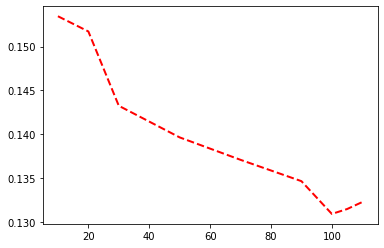

[<matplotlib.lines.Line2D at 0x7f1cec4c2250>]

In [ ]:
from pyspark.ml.feature import VectorAssembler, PCA
from pyspark.ml.linalg import Vectors
from pyspark.sql.functions import *
from pyspark.ml.regression import LinearRegression
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import CrossValidator
from sklearn.model_selection import KFold
from pyspark.ml import Pipeline 
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# For data with enrichment

# load the data
train = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML.csv")
test = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML.csv")

# transform string type data to double type
def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df
train = string_to_double(train,train.columns)
test = string_to_double(test,test.columns)

# specify the input columns' name and the combined output column's name
inputCols = train.columns[0:111]
assembler = VectorAssembler(
    inputCols = inputCols, outputCol = 'features')

# def PCA model functions
def pipeline_PCA(pc_numbers):
    pca_pattern = PCA(
        k = pc_numbers, 
        inputCol = 'features', 
        outputCol = 'pcaFeatures')
    pipeline_PCA = Pipeline(stages=[assembler,pca_pattern])
    return pipeline_PCA
def pipelineModel_PCA(pc_numbers,data):
    pipelineModel_PCA = pipeline_PCA(pc_numbers).fit(data)
    return pipelineModel_PCA

# def PCR model function
pcr_pattern = LinearRegression(featuresCol="pcaFeatures", labelCol="logSalePrice")
pipeline_PCR = Pipeline(stages=[pcr_pattern])
def pipelineModel_PCR(pc_numbers,data):
    train_pca = pipelineModel_PCA(pc_numbers,data).transform(data)
    pipelineModel_PCR = pipeline_PCR.fit(train_pca)
    return pipelineModel_PCR

# using CV to tune the best PC_number
regressionEvaluator = RegressionEvaluator(predictionCol="prediction", labelCol="logSalePrice", metricName="rmse")
KF=KFold(5,True,123) 
train_pd = train.toPandas()
def CV_rmse(pc_numbers):
    rmse_cv_list = []
    for train_index,test_index in KF.split(train_pd):
        train_cv_pd,test_cv_pd=train_pd.iloc[train_index],train_pd.iloc[test_index]
        train_cv = spark.createDataFrame(train_cv_pd)
        pcrModel_cv = pipelineModel_PCR(pc_numbers,train_cv)
        test_cv = spark.createDataFrame(test_cv_pd)
        test_cv = pipelineModel_PCA(pc_numbers,train_cv).transform(test_cv)
        predDF_cv = pcrModel_cv.transform(test_cv)
        rmse_cv = regressionEvaluator.evaluate(predDF_cv)
        rmse_cv_list.append(rmse_cv)
    cv_rmse_sum = 0
    for i in rmse_cv_list:
        cv_rmse_sum = cv_rmse_sum + i
    rmse_cv_result = cv_rmse_sum/5
    return rmse_cv_result

# Briefly see the tuning effect
brief_view_list = [CV_rmse(10),CV_rmse(20),CV_rmse(30),CV_rmse(50),CV_rmse(70),CV_rmse(90),CV_rmse(100),CV_rmse(105),CV_rmse(110)]
PC_number_brief = [10,20,30,50,70,90,100,105,110]
plt.plot(PC_number_brief,brief_view_list,color='red',linewidth=2.0,linestyle='--')

Out[290]:

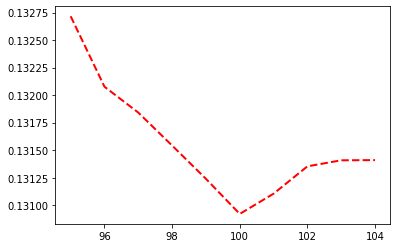

[<matplotlib.lines.Line2D at 0x7f1d09a775b0>]

In [ ]:
rmse_tuning_list = []
for i in range(95,105):
    rmse_tuning_list.append(CV_rmse(i))
rmse_tuning_list

# PC_number = 100 achieves the least cv rmse, so choose it to be 100
PC_number_2 = [95,96,97,98,99,100,101,102,103,104]
plt.plot(PC_number_2,rmse_tuning_list,color='red',linewidth=2.0,linestyle='--')

In [ ]:
# Train the model using CV_number = 100
PCA_model = pipelineModel_PCA(100,train)
PCR_model = pipelineModel_PCR(100,train)
train_pred = PCA_model.transform(train)
train_pred = PCR_model.transform(train_pred)
test_pred = PCA_model.transform(test)
test_pred = PCR_model.transform(test_pred)
training_rmse = regressionEvaluator.evaluate(train_pred)
CV_rmse = rmse_tuning_list[5]
test_pred_pd = test_pred.toPandas()
test_pred_pd['Id'] = np.array(range(1461, 2920))
test_pred_pd['prediction'] = np.exp(test_pred_pd['prediction'])
sub_PCR = spark.createDataFrame(test_pred_pd)
sub_PCR = sub_PCR.withColumnRenamed('prediction','SalePrice').select('Id','SalePrice')
display(sub_PCR)

/databricks/spark/python/pyspark/sql/pandas/conversion.py:92: UserWarning: toPandas attempted Arrow optimization because 'spark.sql.execution.arrow.pyspark.enabled' is set to true; however, failed by the reason below:
 Unable to convert the field features. If this column is not necessary, you may consider dropping it or converting to primitive type before the conversion.
Direct cause: Unsupported type in conversion to Arrow: VectorUDT
Attempting non-optimization as 'spark.sql.execution.arrow.pyspark.fallback.enabled' is set to true.
 warnings.warn(msg)
/databricks/spark/python/pyspark/sql/pandas/conversion.py:300: UserWarning: createDataFrame attempted Arrow optimization because 'spark.sql.execution.arrow.pyspark.enabled' is set to true; however, failed by the reason below:
 Could not convert SparseVector(111, {0: 0.3638, 1: -0.3612, 2: -0.7508, 3: 0.4006, 4: -0.3408, 5: -1.0725, 6: -0.6779, 7: -0.2234, 8: -0.4992, 9: 0.1643, 10: -0.5755, 11: -0.2534, 12: 0.6903, 13: -1.2108, 14: -0.775, 15: -1.2152, 16: -0.8178, 17: -0.2581, 18: -1.0284, 19: -0.7508, 20: -1.0292, 21: -0.2038, 22: -0.7614, 23: -0.918, 24: -0.8977, 25: -0.9498, 26: -0.794, 27: -0.9878, 28: 0.2939, 29: 0.2711, 30: 0.339, 31: -0.2388, 32: -0.3754, 33: -1.5639, 34: 0.6162, 35: -0.7967, 36: 0.6484, 37: 2.2337, 38: -0.0022, 39: -0.6127, 40: 0.9682, 41: -1.0932, 42: 1.0, 47: 1.0, 48: 1.0, 50: 1.0, 63: 1.0, 76: 1.0, 85: 1.0, 87: 1.0, 89: 1.0, 92: 1.0, 93: 1.0, 95: 1.0, 101: 1.0, 103: 1.0, 107: 1.0}) with type SparseVector: did not recognize Python value type when inferring an Arrow data type
Attempting non-optimization as 'spark.sql.execution.arrow.pyspark.fallback.enabled' is set to true.
 warnings.warn(msg)

Id,SalePrice
1461,113652.01204739066
1462,160345.6721975274
1463,177290.89160242345
1464,195109.61537599895
1465,198936.4143523363
1466,169038.67994362616
1467,184455.26292623612
1468,162946.8207362344
1469,200234.96844199518
1470,124055.04469695265


Out[292]:

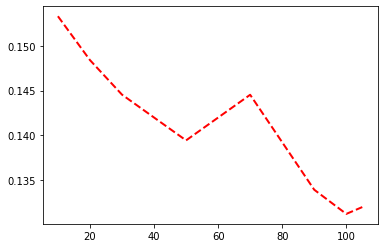

[<matplotlib.lines.Line2D at 0x7f1cc8d5fb50>]

In [ ]:
# For data without enrichment

# import data with enrichment
train_w = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML_w.csv")
test_w = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML_w.csv")
train_w = string_to_double(train_w,train_w.columns)
test_w = string_to_double(test_w,test_w.columns)

# define new assembler
inputCols_w = train_w.columns[0:108]
assembler_w = VectorAssembler(
    inputCols = inputCols_w, outputCol = 'features')

# def new pipelines
def pipeline_PCA_w(pc_numbers):
    pca_pattern = PCA(
        k = pc_numbers, 
        inputCol = 'features', 
        outputCol = 'pcaFeatures')
    pipeline_PCA_w = Pipeline(stages=[assembler_w,pca_pattern])
    return pipeline_PCA_w
def pipelineModel_PCA_w(pc_numbers,data):
    pipelineModel_PCA_w = pipeline_PCA_w(pc_numbers).fit(data)
    return pipelineModel_PCA_w
pcr_pattern = LinearRegression(featuresCol="pcaFeatures", labelCol="logSalePrice")
pipeline_PCR = Pipeline(stages=[pcr_pattern])
def pipelineModel_PCR_w(pc_numbers,data):
    train_pca = pipelineModel_PCA_w(pc_numbers,data).transform(data)
    pipelineModel_PCR_w = pipeline_PCR.fit(train_pca)
    return pipelineModel_PCR_w

# using CV to tune the best PC_number
train_w_pd = train_w.toPandas()
def CV_rmse_w(pc_numbers):
    rmse_cv_list_w = []
    for train_index,test_index in KF.split(train_w_pd):
        train_w_cv_pd,test_w_cv_pd=train_w_pd.iloc[train_index],train_w_pd.iloc[test_index]
        train_w_cv = spark.createDataFrame(train_w_cv_pd)
        pcrModel_cv_w = pipelineModel_PCR_w(pc_numbers,train_w_cv)
        test_w_cv = spark.createDataFrame(test_w_cv_pd)
        test_w_cv = pipelineModel_PCA_w(pc_numbers,train_w_cv).transform(test_w_cv)
        predDF_cv_w = pcrModel_cv_w.transform(test_w_cv)
        rmse_cv_w = regressionEvaluator.evaluate(predDF_cv_w)
        rmse_cv_list_w.append(rmse_cv_w)
    cv_rmse_sum = 0
    for i in rmse_cv_list_w:
        cv_rmse_sum = cv_rmse_sum + i
    rmse_cv_result = cv_rmse_sum/5
    return rmse_cv_result

# Briefly see the tuning effect
brief_view_list_w = [CV_rmse_w(10),CV_rmse_w(20),CV_rmse_w(30),CV_rmse_w(50),CV_rmse_w(70),CV_rmse_w(90),CV_rmse_w(100),CV_rmse_w(105)]
PC_number_brief_w = [10,20,30,50,70,90,100,105]
plt.plot(PC_number_brief_w,brief_view_list_w,color='red',linewidth=2.0,linestyle='--')

Out[293]:

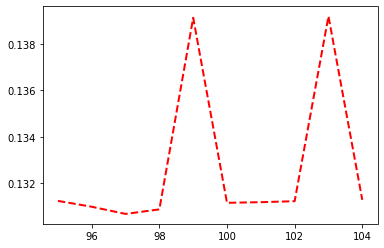

[<matplotlib.lines.Line2D at 0x7f1cc8a17eb0>]

In [ ]:
rmse_tuning_list_w = []
for i in range(95,105):
    rmse_tuning_list_w.append(CV_rmse_w(i))
rmse_tuning_list_w

# PC_number = 97 achieves the least cv rmse, so choose it to be 97
PC_number_2_w = [95,96,97,98,99,100,101,102,103,104]
plt.plot(PC_number_2_w,rmse_tuning_list_w,color='red',linewidth=2.0,linestyle='--')

In [ ]:
# Train the model using CV_number = 97
PCA_model_w = pipelineModel_PCA_w(97,train)
PCR_model_w = pipelineModel_PCR_w(97,train)
train_pred_w = PCA_model_w.transform(train_w)
train_pred_w = PCR_model_w.transform(train_pred_w)
test_pred_w = PCA_model_w.transform(test_w)
test_pred_w = PCR_model_w.transform(test_pred_w)
training_rmse_w = regressionEvaluator.evaluate(train_pred_w)
CV_rmse_w = rmse_tuning_list_w[2]
test_pred_w_pd = test_pred_w.toPandas()
test_pred_w_pd['Id'] = np.array(range(1461, 2920))
test_pred_w_pd['prediction'] = np.exp(test_pred_w_pd['prediction'])
sub_PCR_w = spark.createDataFrame(test_pred_w_pd)
sub_PCR_w = sub_PCR_w.withColumnRenamed('prediction','SalePrice').select('Id','SalePrice')
display(sub_PCR_w)

/databricks/spark/python/pyspark/sql/pandas/conversion.py:300: UserWarning: createDataFrame attempted Arrow optimization because 'spark.sql.execution.arrow.pyspark.enabled' is set to true; however, failed by the reason below:
 Could not convert SparseVector(108, {0: 0.3638, 1: -0.3612, 2: -0.7508, 3: 0.4006, 4: -0.3408, 5: -1.0725, 6: -0.6779, 7: -0.2234, 8: -0.4992, 9: 0.1643, 10: -0.5755, 11: -0.2534, 12: 0.6903, 13: -1.2108, 14: -0.775, 15: -1.2152, 16: -0.8178, 17: -0.2581, 18: -1.0284, 19: -0.7508, 20: -1.0292, 21: -0.2038, 22: -0.7614, 23: -0.918, 24: -0.8977, 25: -0.9498, 26: -0.794, 27: -0.9878, 28: 0.2939, 29: 0.2711, 30: 0.339, 31: 0.6162, 32: -0.7967, 33: 0.6484, 34: 2.2337, 35: -0.0022, 36: -0.6127, 37: 0.9682, 38: -1.0932, 39: 1.0, 44: 1.0, 45: 1.0, 47: 1.0, 60: 1.0, 73: 1.0, 82: 1.0, 84: 1.0, 86: 1.0, 89: 1.0, 90: 1.0, 92: 1.0, 98: 1.0, 100: 1.0, 104: 1.0}) with type SparseVector: did not recognize Python value type when inferring an Arrow data type
Attempting non-optimization as 'spark.sql.execution.arrow.pyspark.fallback.enabled' is set to true.
 warnings.warn(msg)

Id,SalePrice
1461,114631.85719537686
1462,161874.8849208355
1463,178652.45101504202
1464,197342.4821417045
1465,201312.07950189503
1466,170672.85742607052
1467,185699.23075336093
1468,164763.12517559683
1469,201462.6554098687
1470,124779.98707819662


# Random Forest

In [ ]:
from pyspark.ml.feature import *
import pandas as pd
from pyspark.ml.regression import DecisionTreeRegressor
from pyspark.ml import Pipeline
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import ParamGridBuilder
from pyspark.ml.tuning import CrossValidator
from pyspark.sql.types import *
from pyspark.sql.functions import *

In [ ]:
# With data enrichment

df_train = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML.csv")
df_test = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML.csv")
# transform from "HouseStyle_1.5Story" to "HouseStyle_1p5Story"
df_train = df_train.withColumnRenamed("HouseStyle_1.5Story", "HouseStyle_1p5Story")
df_test = df_test.withColumnRenamed("HouseStyle_1.5Story", "HouseStyle_1p5Story")

# transform to double type
def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df
df_train = string_to_double(df_train,df_train.columns)
df_test = string_to_double(df_test,df_test.columns)

# combine to 'vector_assembler'
from pyspark.ml.feature import VectorAssembler
numeric_cols = [field for (field, data_type) in df_train.dtypes if ((data_type == "double") & (field not in ["logSalePrice"]))]
vector_assembler = VectorAssembler(inputCols=numeric_cols, outputCol="features")

# Tune Hypers

from pyspark.ml.regression import RandomForestRegressor
from pyspark.ml import Pipeline

rf = RandomForestRegressor(labelCol="logSalePrice", maxBins=40, seed=123)
pipeline = Pipeline(stages = [vector_assembler, rf])

from pyspark.ml.tuning import ParamGridBuilder
paramGrid = (ParamGridBuilder()
            .addGrid(rf.maxDepth, [2, 4, 8,10])
            .addGrid(rf.numTrees, [10,50,100])
            .build())

from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import CrossValidator
 
evaluator = RegressionEvaluator(labelCol="logSalePrice", 
                                predictionCol="prediction", 
                                metricName="rmse")
 
cv = CrossValidator(estimator=pipeline, 
                    evaluator=evaluator, 
                    estimatorParamMaps=paramGrid, 
                    numFolds=5, 
                    seed=123)

cvModel = cv.fit(df_train)

pd.set_option('display.max_colwidth', None) # no truncate option for Pandas dataframe  
pd.DataFrame(list(zip(cvModel.getEstimatorParamMaps(), cvModel.avgMetrics)))

MLlib will automatically track trials in MLflow. After your tuning fit() call has completed, view the MLflow UI to see logged runs.
Out[296]:

,0,1
0,"{RandomForestRegressor_a13eee1edf7a__maxDepth: 2, RandomForestRegressor_a13eee1edf7a__numTrees: 10}",0.220155
1,"{RandomForestRegressor_a13eee1edf7a__maxDepth: 2, RandomForestRegressor_a13eee1edf7a__numTrees: 50}",0.218937
2,"{RandomForestRegressor_a13eee1edf7a__maxDepth: 2, RandomForestRegressor_a13eee1edf7a__numTrees: 100}",0.216632
3,"{RandomForestRegressor_a13eee1edf7a__maxDepth: 4, RandomForestRegressor_a13eee1edf7a__numTrees: 10}",0.170336
4,"{RandomForestRegressor_a13eee1edf7a__maxDepth: 4, RandomForestRegressor_a13eee1edf7a__numTrees: 50}",0.170321
5,"{RandomForestRegressor_a13eee1edf7a__maxDepth: 4, RandomForestRegressor_a13eee1edf7a__numTrees: 100}",0.167402
6,"{RandomForestRegressor_a13eee1edf7a__maxDepth: 8, RandomForestRegressor_a13eee1edf7a__numTrees: 10}",0.148844
7,"{RandomForestRegressor_a13eee1edf7a__maxDepth: 8, RandomForestRegressor_a13eee1edf7a__numTrees: 50}",0.144978
8,"{RandomForestRegressor_a13eee1edf7a__maxDepth: 8, RandomForestRegressor_a13eee1edf7a__numTrees: 100}",0.141300
9,"{RandomForestRegressor_a13eee1edf7a__maxDepth: 10, RandomForestRegressor_a13eee1edf7a__numTrees: 10}",0.146743


In [ ]:
# Feature Importance
import pandas as pd
dtModel = cvModel.bestModel.stages[1]
featureImp = pd.DataFrame(
  list(zip(vector_assembler.getInputCols(), dtModel.featureImportances)),
  columns=["feature", "importance"])
featureImp.sort_values(by="importance", ascending=False).head(20)

Out[297]:

,feature,importance
2,OverallQual,0.259224
15,GrLivArea,0.129670
6,ExterQual,0.102645
22,KitchenQual,0.059877
4,YearBuilt,0.058965
27,GarageCars,0.050116
39,1stFlrSF_log,0.040917
0,LotArea,0.020192
36,BsmtFinSF1_log,0.019523
25,FireplaceQu,0.018228


In [ ]:
# Model Evaluation
predDF = cvModel.transform(df_train)
 
display(predDF.select("features", "logSalePrice", "prediction").orderBy("logSalePrice", ascending=False))

features,logSalePrice,prediction
"Map(vectorType -> sparse, length -> 111, indices -> List(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 44, 66, 77, 81, 91, 92, 93, 95, 101, 105, 107), values -> List(1.1038853284081613, -0.34746715749417756, 2.820458909096378, 0.38161195845158813, 0.7526492071363516, 0.4908717309245868, 2.793251231144376, -0.23803080185515874, 1.723897579805707, 0.11784386507247499, 2.2202382814966555, 1.1643125696414747, -0.27709436871876314, 0.8908741890386934, 3.4934895619123605, 5.329478301598964, -0.8196835076441235, 3.94745678471977, 2.6046294251774866, 1.2271648985501782, 1.3895466444242945, -0.21138115318786754, 2.2423112110198558, 2.1423687429955103, 2.15147916941042, 1.7531051232431751, 1.4383983336381023, 1.6497416693737514, 0.26245209586744456, 0.26552707357726174, 0.28964551787360143, -1.4814326213163, 1.7669304108387982, 0.6206137816899153, 1.3885395315368299, 1.8702639664526384, 1.0206095831806345, -0.35522069435058207, 0.6738476533929518, 2.4992756874909174, 1.3444700453480682, 0.7541787534607253, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0))",13.534473028231162,13.327011572149475
"Map(vectorType -> sparse, length -> 111, indices -> List(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 44, 66, 77, 79, 86, 87, 91, 92, 93, 95, 101, 103, 107, 110), values -> List(0.5115756321870424, -0.34746715749417756, 2.820458909096378, -0.5170226533860218, 0.8188680050765771, 0.5393086549006539, 1.0519417531466007, -0.23803080185515874, 1.723897579805707, 0.11784386507247499, 1.283374729188818, 1.1643125696414747, -0.27709436871876314, 0.8908741890386934, 3.9356142533042577, 5.6339615992583205, 1.107430697123059, -0.24097846650905572, 2.6046294251774866, 1.2271648985501782, 1.3895466444242945, -0.21138115318786754, 2.2423112110198558, 2.1423687429955103, 2.15147916941042, 0.6486678071978522, 1.4383983336381023, 1.6497416693737514, 0.26245209586744456, 0.26552707357726174, 0.28964551787360143, -1.073391187448523, -0.7948241234512545, 1.1532727662289888, 2.7467364276060624, -0.8156768013993335, 1.1425375318197035, -0.35522069435058207, 0.03167847559799789, 2.456466892937779, 1.0361470393504864, 0.9574982080891954, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0))",13.521139497361697,13.281715660466778
"Map(vectorType -> sparse, length -> 111, indices -> List(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 44, 49, 66, 77, 79, 81, 91, 92, 93, 95, 101, 105, 107), values -> List(2.5290553941634757, -0.34746715749417756, 2.820458909096378, -0.5170226533860218, 0.7857586061064643, 0.5393086549006539, 1.0519417531466007, 2.6105345318213335, 1.723897579805707, 0.11784386507247499, 2.2202382814966555, 1.1643125696414747, -0.27709436871876314, 0.8908741890386934, 3.3193886471673646, 4.018297101053359, 1.107430697123059, -0.24097846650905572, 2.6046294251774866, 1.2271648985501782, 1.3895466444242945, -0.21138115318786754, 0.7357422427322396, 2.1423687429955103, 0.6002892497367345, 0.6486678071978522, 1.4383983336381023, 1.6497416693737514, 0.26245209586744456, 0.26552707357726174, 0.28964551787360143, 1.3748574157581406, -0.7651906146590567, 1.1964613325429667, 1.7862435263657852, 1.932417480103019, 1.0046242050846468, -0.35522069435058207, 0.3508977358788429, 1.589985990620632, 1.3227515017940592, 0.9455847247868221, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0))",13.345506928718539,13.26185226986913
"Map(vectorType -> sparse, length -> 111, indices -> List(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 50, 67, 76, 79, 85, 88, 91, 92,

In [ ]:
from pyspark.ml.evaluation import RegressionEvaluator
 
regressionEvaluator = RegressionEvaluator(predictionCol="prediction", 
                                          labelCol="logSalePrice", 
                                          metricName="rmse")
 
rmse = regressionEvaluator.evaluate(predDF)
r2 = regressionEvaluator.setMetricName("r2").evaluate(predDF)
print(f"RMSE is {rmse}")
print(f"R2 is {r2}")

RMSE is 0.06539725728528203
R2 is 0.9731782123497212

In [ ]:
#df_test = df_test.replace('NaN', '0')
test_pred = cvModel.transform(df_test)
sub_RF = test_pred.withColumn('SalePrice', exp(col("prediction")))
sub_RF = sub_RF.toPandas()
sub_RF['Id'] = np.array(range(1461,2920))
sub_RF = spark.createDataFrame(sub_RF)
sub_RF = sub_RF.select('Id','SalePrice')
display(sub_RF)

/databricks/spark/python/pyspark/sql/pandas/conversion.py:92: UserWarning: toPandas attempted Arrow optimization because 'spark.sql.execution.arrow.pyspark.enabled' is set to true; however, failed by the reason below:
 Unable to convert the field features. If this column is not necessary, you may consider dropping it or converting to primitive type before the conversion.
Direct cause: Unsupported type in conversion to Arrow: VectorUDT
Attempting non-optimization as 'spark.sql.execution.arrow.pyspark.fallback.enabled' is set to true.
 warnings.warn(msg)
/databricks/spark/python/pyspark/sql/pandas/conversion.py:300: UserWarning: createDataFrame attempted Arrow optimization because 'spark.sql.execution.arrow.pyspark.enabled' is set to true; however, failed by the reason below:
 Could not convert SparseVector(111, {0: 0.3638, 1: -0.3612, 2: -0.7508, 3: 0.4006, 4: -0.3408, 5: -1.0725, 6: -0.6779, 7: -0.2234, 8: -0.4992, 9: 0.1643, 10: -0.5755, 11: -0.2534, 12: 0.6903, 13: -1.2108, 14: -0.775, 15: -1.2152, 16: -0.8178, 17: -0.2581, 18: -1.0284, 19: -0.7508, 20: -1.0292, 21: -0.2038, 22: -0.7614, 23: -0.918, 24: -0.8977, 25: -0.9498, 26: -0.794, 27: -0.9878, 28: 0.2939, 29: 0.2711, 30: 0.339, 31: -0.2388, 32: -0.3754, 33: -1.5639, 34: 0.6162, 35: -0.7967, 36: 0.6484, 37: 2.2337, 38: -0.0022, 39: -0.6127, 40: 0.9682, 41: -1.0932, 42: 1.0, 47: 1.0, 48: 1.0, 50: 1.0, 63: 1.0, 76: 1.0, 85: 1.0, 87: 1.0, 89: 1.0, 92: 1.0, 93: 1.0, 95: 1.0, 101: 1.0, 103: 1.0, 107: 1.0}) with type SparseVector: did not recognize Python value type when inferring an Arrow data type
Attempting non-optimization as 'spark.sql.execution.arrow.pyspark.fallback.enabled' is set to true.
 warnings.warn(msg)

Id,SalePrice
1461,120230.52700408373
1462,149745.14063912162
1463,182766.77074287058
1464,188022.56692631805
1465,190587.93833550048
1466,185189.95801165368
1467,169307.08712953946
1468,176354.48375301054
1469,177622.5878375455
1470,125295.565941066


In [ ]:
# Without Enrichment

df_train_w = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML_w.csv")
df_test_w = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML_w.csv")

# transform from "HouseStyle_1.5Story" to "HouseStyle_1p5Story"
df_train_w = df_train_w.withColumnRenamed("HouseStyle_1.5Story", "HouseStyle_1p5Story")
df_test_w = df_test_w.withColumnRenamed("HouseStyle_1.5Story", "HouseStyle_1p5Story")

# transform to double type
def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df
df_train_w = string_to_double(df_train_w,df_train_w.columns)
df_test_w = string_to_double(df_test_w,df_test_w.columns)

# combine to 'vector_assembler'
from pyspark.ml.feature import VectorAssembler
numeric_cols_w = [field for (field, data_type) in df_train_w.dtypes if ((data_type == "double") & (field not in ["logSalePrice"]))]
vector_assembler_w = VectorAssembler(inputCols=numeric_cols_w, outputCol="features")

# Tune Hypers
from pyspark.ml.regression import RandomForestRegressor
from pyspark.ml import Pipeline

rf = RandomForestRegressor(labelCol="logSalePrice", maxBins=40, seed=123)
pipeline = Pipeline(stages = [vector_assembler_w, rf])

from pyspark.ml.tuning import ParamGridBuilder
 
paramGrid = (ParamGridBuilder()
            .addGrid(rf.maxDepth, [2, 4, 8,10])
            .addGrid(rf.numTrees, [10,50,100])
            .build())

from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import CrossValidator
 
evaluator = RegressionEvaluator(labelCol="logSalePrice", 
                                predictionCol="prediction", 
                                metricName="rmse")
 
cv = CrossValidator(estimator=pipeline, 
                    evaluator=evaluator, 
                    estimatorParamMaps=paramGrid, 
                    numFolds=5, 
                    seed=123)

cvModel = cv.fit(df_train_w)

pd.set_option('display.max_colwidth', None) # no truncate option for Pandas dataframe  
pd.DataFrame(list(zip(cvModel.getEstimatorParamMaps(), cvModel.avgMetrics)))

MLlib will automatically track trials in MLflow. After your tuning fit() call has completed, view the MLflow UI to see logged runs.
Out[301]:

,0,1
0,"{RandomForestRegressor_1993b6b71e13__maxDepth: 2, RandomForestRegressor_1993b6b71e13__numTrees: 10}",0.215677
1,"{RandomForestRegressor_1993b6b71e13__maxDepth: 2, RandomForestRegressor_1993b6b71e13__numTrees: 50}",0.217591
2,"{RandomForestRegressor_1993b6b71e13__maxDepth: 2, RandomForestRegressor_1993b6b71e13__numTrees: 100}",0.215960
3,"{RandomForestRegressor_1993b6b71e13__maxDepth: 4, RandomForestRegressor_1993b6b71e13__numTrees: 10}",0.175417
4,"{RandomForestRegressor_1993b6b71e13__maxDepth: 4, RandomForestRegressor_1993b6b71e13__numTrees: 50}",0.170415
5,"{RandomForestRegressor_1993b6b71e13__maxDepth: 4, RandomForestRegressor_1993b6b71e13__numTrees: 100}",0.167487
6,"{RandomForestRegressor_1993b6b71e13__maxDepth: 8, RandomForestRegressor_1993b6b71e13__numTrees: 10}",0.151869
7,"{RandomForestRegressor_1993b6b71e13__maxDepth: 8, RandomForestRegressor_1993b6b71e13__numTrees: 50}",0.142671
8,"{RandomForestRegressor_1993b6b71e13__maxDepth: 8, RandomForestRegressor_1993b6b71e13__numTrees: 100}",0.140307
9,"{RandomForestRegressor_1993b6b71e13__maxDepth: 10, RandomForestRegressor_1993b6b71e13__numTrees: 10}",0.150203


In [ ]:
# Feature Importance
import pandas as pd
dtModel = cvModel.bestModel.stages[1]
featureImp = pd.DataFrame(
  list(zip(vector_assembler_w .getInputCols(), dtModel.featureImportances)),
  columns=["feature", "importance"])
featureImp.sort_values(by="importance", ascending=False).head(20)

Out[302]:

,feature,importance
2,OverallQual,0.263314
15,GrLivArea,0.133071
6,ExterQual,0.098673
4,YearBuilt,0.059487
27,GarageCars,0.049769
36,1stFlrSF_log,0.044358
22,KitchenQual,0.037745
8,BsmtQual,0.024743
33,BsmtFinSF1_log,0.021478
25,FireplaceQu,0.021218


In [ ]:
# Model Evaluation

predDF = cvModel.transform(df_train_w)
 
display(predDF.select("features", "logSalePrice", "prediction").orderBy("logSalePrice", ascending=False))

features,logSalePrice,prediction
"Map(vectorType -> sparse, length -> 108, indices -> List(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 41, 63, 74, 78, 88, 89, 90, 92, 98, 102, 104), values -> List(1.1038853284081613, -0.34746715749417756, 2.820458909096378, 0.38161195845158813, 0.7526492071363516, 0.4908717309245868, 2.793251231144376, -0.23803080185515874, 1.723897579805707, 0.11784386507247499, 2.2202382814966555, 1.1643125696414747, -0.27709436871876314, 0.8908741890386934, 3.4934895619123605, 5.329478301598964, -0.8196835076441235, 3.94745678471977, 2.6046294251774866, 1.2271648985501782, 1.3895466444242945, -0.21138115318786754, 2.2423112110198558, 2.1423687429955103, 2.15147916941042, 1.7531051232431751, 1.4383983336381023, 1.6497416693737514, 0.26245209586744456, 0.26552707357726174, 0.28964551787360143, 1.3885395315368299, 1.8702639664526384, 1.0206095831806345, -0.35522069435058207, 0.6738476533929518, 2.4992756874909174, 1.3444700453480682, 0.7541787534607253, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0))",13.534473028231162,13.388192326975219
"Map(vectorType -> sparse, length -> 108, indices -> List(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 41, 63, 74, 76, 83, 84, 88, 89, 90, 92, 98, 100, 104, 107), values -> List(0.5115756321870424, -0.34746715749417756, 2.820458909096378, -0.5170226533860218, 0.8188680050765771, 0.5393086549006539, 1.0519417531466007, -0.23803080185515874, 1.723897579805707, 0.11784386507247499, 1.283374729188818, 1.1643125696414747, -0.27709436871876314, 0.8908741890386934, 3.9356142533042577, 5.6339615992583205, 1.107430697123059, -0.24097846650905572, 2.6046294251774866, 1.2271648985501782, 1.3895466444242945, -0.21138115318786754, 2.2423112110198558, 2.1423687429955103, 2.15147916941042, 0.6486678071978522, 1.4383983336381023, 1.6497416693737514, 0.26245209586744456, 0.26552707357726174, 0.28964551787360143, 2.7467364276060624, -0.8156768013993335, 1.1425375318197035, -0.35522069435058207, 0.03167847559799789, 2.456466892937779, 1.0361470393504864, 0.9574982080891954, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0))",13.521139497361697,13.30093546834572
"Map(vectorType -> sparse, length -> 108, indices -> List(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 41, 46, 63, 74, 76, 78, 88, 89, 90, 92, 98, 102, 104), values -> List(2.5290553941634757, -0.34746715749417756, 2.820458909096378, -0.5170226533860218, 0.7857586061064643, 0.5393086549006539, 1.0519417531466007, 2.6105345318213335, 1.723897579805707, 0.11784386507247499, 2.2202382814966555, 1.1643125696414747, -0.27709436871876314, 0.8908741890386934, 3.3193886471673646, 4.018297101053359, 1.107430697123059, -0.24097846650905572, 2.6046294251774866, 1.2271648985501782, 1.3895466444242945, -0.21138115318786754, 0.7357422427322396, 2.1423687429955103, 0.6002892497367345, 0.6486678071978522, 1.4383983336381023, 1.6497416693737514, 0.26245209586744456, 0.26552707357726174, 0.28964551787360143, 1.7862435263657852, 1.932417480103019, 1.0046242050846468, -0.35522069435058207, 0.3508977358788429, 1.589985990620632, 1.3227515017940592, 0.9455847247868221, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0))",13.345506928718539,13.259285100084925
"Map(vectorType -> sparse, length -> 108, indices -> List(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 47, 64, 73, 76, 82, 85, 88, 89, 90, 92, 98, 102, 103, 106), values -> List(0.2406680850656104, -0.34746715749417756, 2.0973913046572714, -0.5170226533860218, 1.2492901916880428, 1.2174255905655946, 2.793251231144376, -0.23803080185515874, 1.723897579805707, 0.11

In [ ]:
from pyspark.ml.evaluation import RegressionEvaluator
 
regressionEvaluator = RegressionEvaluator(predictionCol="prediction", 
                                          labelCol="logSalePrice", 
                                          metricName="rmse")
 
rmse = regressionEvaluator.evaluate(predDF)
r2 = regressionEvaluator.setMetricName("r2").evaluate(predDF)
print(f"RMSE is {rmse}")
print(f"R2 is {r2}")

RMSE is 0.0651053263573241
R2 is 0.9734171408009697

In [ ]:
#df_test = df_test.replace('NaN', '0')
test_pred = cvModel.transform(df_test_w)
sub_RF_w = test_pred.withColumn('SalePrice', exp(col("prediction")))
sub_RF_w = sub_RF_w.toPandas()
sub_RF_w['Id'] = np.array(range(1461,2920))
sub_RF_w = spark.createDataFrame(sub_RF_w)
sub_RF_w = sub_RF_w.select('Id','SalePrice')
display(sub_RF_w)

/databricks/spark/python/pyspark/sql/pandas/conversion.py:92: UserWarning: toPandas attempted Arrow optimization because 'spark.sql.execution.arrow.pyspark.enabled' is set to true; however, failed by the reason below:
 Unable to convert the field features. If this column is not necessary, you may consider dropping it or converting to primitive type before the conversion.
Direct cause: Unsupported type in conversion to Arrow: VectorUDT
Attempting non-optimization as 'spark.sql.execution.arrow.pyspark.fallback.enabled' is set to true.
 warnings.warn(msg)
/databricks/spark/python/pyspark/sql/pandas/conversion.py:300: UserWarning: createDataFrame attempted Arrow optimization because 'spark.sql.execution.arrow.pyspark.enabled' is set to true; however, failed by the reason below:
 Could not convert SparseVector(108, {0: 0.3638, 1: -0.3612, 2: -0.7508, 3: 0.4006, 4: -0.3408, 5: -1.0725, 6: -0.6779, 7: -0.2234, 8: -0.4992, 9: 0.1643, 10: -0.5755, 11: -0.2534, 12: 0.6903, 13: -1.2108, 14: -0.775, 15: -1.2152, 16: -0.8178, 17: -0.2581, 18: -1.0284, 19: -0.7508, 20: -1.0292, 21: -0.2038, 22: -0.7614, 23: -0.918, 24: -0.8977, 25: -0.9498, 26: -0.794, 27: -0.9878, 28: 0.2939, 29: 0.2711, 30: 0.339, 31: 0.6162, 32: -0.7967, 33: 0.6484, 34: 2.2337, 35: -0.0022, 36: -0.6127, 37: 0.9682, 38: -1.0932, 39: 1.0, 44: 1.0, 45: 1.0, 47: 1.0, 60: 1.0, 73: 1.0, 82: 1.0, 84: 1.0, 86: 1.0, 89: 1.0, 90: 1.0, 92: 1.0, 98: 1.0, 100: 1.0, 104: 1.0}) with type SparseVector: did not recognize Python value type when inferring an Arrow data type
Attempting non-optimization as 'spark.sql.execution.arrow.pyspark.fallback.enabled' is set to true.
 warnings.warn(msg)

Id,SalePrice
1461,124692.64117643455
1462,147717.93980868516
1463,186266.60299542654
1464,185755.77064812562
1465,190088.48686871585
1466,185561.17157959822
1467,172916.32812076417
1468,177676.19051493937
1469,179905.66234730993
1470,126450.78620409739


# GBM

In [ ]:
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import CrossValidator
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.regression import GBTRegressor
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder

# with enrichment

train_ML = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML.csv")
test_ML = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML.csv")
def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df
train_ML = string_to_double(train_ML,train_ML.columns)
test_ML = string_to_double(test_ML,test_ML.columns)

featuresCols = [field for (field, dataType) in train_ML.dtypes 
               if (field != "logSalePrice")]
vecAssembler = VectorAssembler(inputCols=featuresCols, outputCol="features")
# train_vec = vecAssembler.transform(train_final)

gbt = GBTRegressor(labelCol="logSalePrice")

paramGrid = ParamGridBuilder()\
  .addGrid(gbt.maxDepth, [2])\
  .addGrid(gbt.maxBins, [16,32])\
  .addGrid(gbt.maxIter, [180,220])\
  .build()

evaluator = RegressionEvaluator(labelCol="logSalePrice", 
                                predictionCol="prediction", 
                                metricName="rmse")


cv = CrossValidator(estimator=gbt, 
                    evaluator=evaluator, 
                    estimatorParamMaps=paramGrid, 
                    numFolds=5, 
                    parallelism=4, 
                    seed=123)

pipeline = Pipeline(stages=[vecAssembler,cv])

pipelineModel = pipeline.fit(train_ML)

predDF = pipelineModel.transform(test_ML)

from pyspark.sql.functions import exp
exp_predictions = predDF.withColumn("SalePrice", exp(col("prediction")))
sub_GBM = exp_predictions.toPandas()
sub_GBM['Id'] = np.array(range(1461,2920))
sub_GBM = spark.createDataFrame(sub_GBM)
sub_GBM = sub_GBM.select('Id','SalePrice')
display(sub_GBM)

MLlib will automatically track trials in MLflow. After your tuning fit() call has completed, view the MLflow UI to see logged runs.
/databricks/spark/python/pyspark/sql/pandas/conversion.py:300: UserWarning: createDataFrame attempted Arrow optimization because 'spark.sql.execution.arrow.pyspark.enabled' is set to true; however, failed by the reason below:
 Could not convert SparseVector(111, {0: 0.3638, 1: -0.3612, 2: -0.7508, 3: 0.4006, 4: -0.3408, 5: -1.0725, 6: -0.6779, 7: -0.2234, 8: -0.4992, 9: 0.1643, 10: -0.5755, 11: -0.2534, 12: 0.6903, 13: -1.2108, 14: -0.775, 15: -1.2152, 16: -0.8178, 17: -0.2581, 18: -1.0284, 19: -0.7508, 20: -1.0292, 21: -0.2038, 22: -0.7614, 23: -0.918, 24: -0.8977, 25: -0.9498, 26: -0.794, 27: -0.9878, 28: 0.2939, 29: 0.2711, 30: 0.339, 31: -0.2388, 32: -0.3754, 33: -1.5639, 34: 0.6162, 35: -0.7967, 36: 0.6484, 37: 2.2337, 38: -0.0022, 39: -0.6127, 40: 0.9682, 41: -1.0932, 42: 1.0, 47: 1.0, 48: 1.0, 50: 1.0, 63: 1.0, 76: 1.0, 85: 1.0, 87: 1.0, 89: 1.0, 92: 1.0, 93: 1.0, 95: 1.0, 101: 1.0, 103: 1.0, 107: 1.0}) with type SparseVector: did not recognize Python value type when inferring an Arrow data type
Attempting non-optimization as 'spark.sql.execution.arrow.pyspark.fallback.enabled' is set to true.
 warnings.warn(msg)

Id,SalePrice
1461,119861.44652074597
1462,156547.9226583945
1463,196510.1683241108
1464,191095.55194101777
1465,192377.35300300695
1466,175993.76436199105
1467,162458.92571521553
1468,172872.8341207985
1469,201311.1533228242
1470,132514.16147302667


In [ ]:
va = pipelineModel.stages[-2]
gbmModel = pipelineModel.stages[-1].bestModel
feature_importance = spark.createDataFrame(pd.DataFrame(list(zip(va.getInputCols(), gbmModel.featureImportances)),columns = ['feature', 'importance'])) 
display(feature_importance.select('feature','importance').orderBy('importance',ascending=False))

feature,importance
OverallQual,0.2715998570247702
GrLivArea,0.11672266772154503
BsmtFinSF1_log,0.09955621937587188
LotArea,0.054829604887127334
OverallCond,0.05016959711692045
YearBuilt,0.046651483887070376
1stFlrSF_log,0.04123880665449733
CentralAir_Y,0.037513441478638866
GarageCond,0.033605622970252984
YearRemodAdd,0.024874764961617158


In [ ]:
# without enrichment

train_ML_w = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML_w.csv")
test_ML_w = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML_w.csv")
def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df
train_ML_w = string_to_double(train_ML_w,train_ML_w.columns)
test_ML_w = string_to_double(test_ML_w,test_ML_w.columns)

featuresCols_w = [field for (field, dataType) in train_ML_w.dtypes 
               if (field != "logSalePrice")]
vecAssembler_w = VectorAssembler(inputCols=featuresCols_w, outputCol="features")

gbt_w = GBTRegressor(labelCol="logSalePrice")
paramGrid_w = ParamGridBuilder()\
  .addGrid(gbt_w.maxDepth, [2])\
  .addGrid(gbt_w.maxBins, [16,32])\
  .addGrid(gbt_w.maxIter, [180,200,220])\
  .build()

evaluator_w = RegressionEvaluator(labelCol="logSalePrice", 
                                predictionCol="prediction", 
                                metricName="rmse")


cv_w = CrossValidator(estimator=gbt_w, 
                    evaluator=evaluator_w, 
                    estimatorParamMaps=paramGrid_w, 
                    numFolds=5, 
                    parallelism=4, 
                    seed=123)

pipeline_w = Pipeline(stages=[vecAssembler_w,cv_w])

pipelineModel_w = pipeline_w.fit(train_ML_w)

predDF_w = pipelineModel_w.transform(test_ML_w)


exp_predictions_w = predDF_w.withColumn("SalePrice", exp(col("prediction")))
sub_GBM_w = exp_predictions_w.toPandas()
sub_GBM_w['Id'] = np.array(range(1461,2920))
sub_GBM_w = spark.createDataFrame(sub_GBM_w)
sub_GBM_w = sub_GBM_w.select('Id','SalePrice')
display(sub_GBM_w)

MLlib will automatically track trials in MLflow. After your tuning fit() call has completed, view the MLflow UI to see logged runs.

Id,SalePrice
1461,121094.52469384907
1462,161148.2740409962
1463,199633.86961845815
1464,197104.14354883257
1465,191422.6331368647
1466,174463.20493564656
1467,166372.71267096073
1468,170762.48985367836
1469,196385.99490850617
1470,132134.54249125315


In [ ]:
va_w = pipelineModel_w.stages[-2]
gbmModel_w = pipelineModel_w.stages[-1].bestModel
feature_importance_w = spark.createDataFrame(pd.DataFrame(list(zip(va_w.getInputCols(), gbmModel_w.featureImportances)),columns = ['feature', 'importance'])) 
display(feature_importance_w.select('feature','importance').orderBy('importance',ascending=False))

feature,importance
OverallQual,0.2714806593225459
GrLivArea,0.11873074970873326
BsmtFinSF1_log,0.1012520184016567
LotArea,0.05462783270834409
YearBuilt,0.050171061003221926
OverallCond,0.050126390370337684
1stFlrSF_log,0.03768059770080002
CentralAir_Y,0.037533210444256275
GarageCond,0.03319371046888878
YearRemodAdd,0.024836565335408244


# XGBoost

In [ ]:
# with enrichment

df_train = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML.csv")
df_test = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML.csv")
# transform to double type
def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df
df_train = string_to_double(df_train,df_train.columns)
df_test = string_to_double(df_test,df_test.columns)

# combine to 'vector_assembler'
from pyspark.ml.feature import VectorAssembler
numeric_cols = [field for (field, data_type) in df_train.dtypes if ((data_type == "double") & (field not in ["logSalePrice"]))]
vector_assembler = VectorAssembler(inputCols=numeric_cols, outputCol="features")

# 2. Construct Xgboost Model and MLPipeline

from sparkdl.xgboost import XgboostRegressor
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml import Pipeline 

xgb_regressor = XgboostRegressor(num_workers=1, labelCol="logSalePrice", missing=0.0)

# tune the hyperparameters
paramGrid = (ParamGridBuilder()
             .addGrid(xgb_regressor.gamma,[0, 0.1])
             .addGrid(xgb_regressor.learning_rate,[0.1])
             .addGrid(xgb_regressor.max_depth, [1, 2, 3])
             .addGrid(xgb_regressor.n_estimators, [500, 700])
             .addGrid(xgb_regressor.reg_alpha,[0.1, 0.5, 1])
             .addGrid(xgb_regressor.reg_lambda,[0.01, 0.1, 1])
             .build())

evaluator = RegressionEvaluator(metricName="rmse", labelCol=xgb_regressor.getLabelCol(), predictionCol=xgb_regressor.getPredictionCol())

cross_validator = CrossValidator(estimator=xgb_regressor, evaluator=evaluator, estimatorParamMaps=paramGrid, numFolds=5, seed=123)

pipeline = Pipeline(stages=[vector_assembler, cross_validator])

# 3. Train the model
# best model, Kaggle: 0.12759

xgb_regressor = XgboostRegressor(num_workers=1, labelCol="logSalePrice", missing=0.0)

paramGrid = (ParamGridBuilder()
             .addGrid(xgb_regressor.gamma,[0])
             .addGrid(xgb_regressor.learning_rate,[0.1])
             .addGrid(xgb_regressor.max_depth, [2])
             .addGrid(xgb_regressor.n_estimators, [700])
             .addGrid(xgb_regressor.reg_alpha,[0.5])
             .addGrid(xgb_regressor.reg_lambda,[1])
             .build())


evaluator = RegressionEvaluator(metricName="rmse", labelCol=xgb_regressor.getLabelCol(), predictionCol=xgb_regressor.getPredictionCol())

cross_validator = CrossValidator(estimator=xgb_regressor, evaluator=evaluator, estimatorParamMaps=paramGrid, numFolds=5, seed=123)

pipeline = Pipeline(stages=[vector_assembler, cross_validator])

pipeline_model = pipeline.fit(df_train)

MLlib will automatically track trials in MLflow. After your tuning fit() call has completed, view the MLflow UI to see logged runs.

In [ ]:
# 4. Model interpretation - Feature importance

import pandas as pd
va = pipeline_model.stages[-2]
xgbModel = pipeline_model.stages[-1].bestModel

# get feature importance
dict_imp = xgbModel.get_feature_importances()
df_imp = pd.DataFrame(list(zip(dict_imp,dict_imp.values())),columns = ['fid', 'importance'])

# get name of attributes
id_attr = []
len_attr = len(va.getInputCols())-1

for i in range(0,len_attr):
    fid = 'f' + str(i)
    id_attr.append(fid)
    
df_attr = pd.DataFrame(list(zip(va.getInputCols(), id_attr)),columns = ['feature', 'fid'])

# merge and sort
feature_imp = pd.merge(df_attr,df_imp,on='fid',how='inner').sort_values(by='importance',ascending=False)
display(feature_imp.head(20))

feature,fid,importance
LotArea,f0,162
GrLivArea,f15,144
OverallQual,f2,126
YearBuilt,f4,123
1stFlrSF_log,f39,103
BsmtUnfSF_log,f38,103
LotFrontage_log,f34,75
BsmtFinSF1_log,f36,73
Unemio,f32,66
Sentiment_t-1,f31,64


In [ ]:
# 5. Predict the test data

from pyspark.sql.functions import exp, col

predictions = pipeline_model.transform(df_test)
exp_predictions = predictions.withColumn("SalePrice", exp(col("prediction")))
sub_XGB = exp_predictions.toPandas()
sub_XGB['Id'] = np.array(range(1461,2920))
sub_XGB = spark.createDataFrame(sub_XGB)
sub_XGB = sub_XGB.select('Id','SalePrice')
display(sub_XGB)

Id,SalePrice
1461,116036.07112203851
1462,152900.53873295034
1463,177044.94349939443
1464,190043.1458323769
1465,186193.45848261262
1466,171843.6554616653
1467,168908.78988194742
1468,169769.39137547658
1469,179523.01582580397
1470,121935.61003969307


In [ ]:
# without enrichment

df_train = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML_w.csv")
df_test = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML_w.csv")
# transform to double type
def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df
df_train = string_to_double(df_train,df_train.columns)
df_test = string_to_double(df_test,df_test.columns)

# combine to 'vector_assembler'
from pyspark.ml.feature import VectorAssembler
numeric_cols = [field for (field, data_type) in df_train.dtypes if ((data_type == "double") & (field not in ["logSalePrice"]))]
vector_assembler = VectorAssembler(inputCols=numeric_cols, outputCol="features")

# 2. Construct Xgboost Model and MLPipeline

from sparkdl.xgboost import XgboostRegressor
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml import Pipeline 

xgb_regressor = XgboostRegressor(num_workers=1, labelCol="logSalePrice", missing=0.0)

# tune the hyperparameters
paramGrid = (ParamGridBuilder()
             .addGrid(xgb_regressor.gamma,[0, 0.1])
             .addGrid(xgb_regressor.learning_rate,[0.1])
             .addGrid(xgb_regressor.max_depth, [1, 2, 3])
             .addGrid(xgb_regressor.n_estimators, [500, 700])
             .addGrid(xgb_regressor.reg_alpha,[0.1, 0.5, 1])
             .addGrid(xgb_regressor.reg_lambda,[0.01, 0.1, 1])
             .build())

evaluator = RegressionEvaluator(metricName="rmse", labelCol=xgb_regressor.getLabelCol(), predictionCol=xgb_regressor.getPredictionCol())

cross_validator = CrossValidator(estimator=xgb_regressor, evaluator=evaluator, estimatorParamMaps=paramGrid, numFolds=5, seed=123)

pipeline = Pipeline(stages=[vector_assembler, cross_validator])

# 3. Train the model
# best model, Kaggle: 0.12759

xgb_regressor = XgboostRegressor(num_workers=1, labelCol="logSalePrice", missing=0.0)

paramGrid = (ParamGridBuilder()
             .addGrid(xgb_regressor.gamma,[0])
             .addGrid(xgb_regressor.learning_rate,[0.1])
             .addGrid(xgb_regressor.max_depth, [2])
             .addGrid(xgb_regressor.n_estimators, [700])
             .addGrid(xgb_regressor.reg_alpha,[0.5])
             .addGrid(xgb_regressor.reg_lambda,[1])
             .build())


evaluator = RegressionEvaluator(metricName="rmse", labelCol=xgb_regressor.getLabelCol(), predictionCol=xgb_regressor.getPredictionCol())

cross_validator = CrossValidator(estimator=xgb_regressor, evaluator=evaluator, estimatorParamMaps=paramGrid, numFolds=5, seed=123)

pipeline = Pipeline(stages=[vector_assembler, cross_validator])

pipeline_model = pipeline.fit(df_train)

MLlib will automatically track trials in MLflow. After your tuning fit() call has completed, view the MLflow UI to see logged runs.

In [ ]:
# 4. Model interpretation - Feature importance

import pandas as pd
va = pipeline_model.stages[-2]
xgbModel = pipeline_model.stages[-1].bestModel

# get feature importance
dict_imp = xgbModel.get_feature_importances()
df_imp = pd.DataFrame(list(zip(dict_imp,dict_imp.values())),columns = ['fid', 'importance'])

# get name of attributes
id_attr = []
len_attr = len(va.getInputCols())-1

for i in range(0,len_attr):
    fid = 'f' + str(i)
    id_attr.append(fid)
    
df_attr = pd.DataFrame(list(zip(va.getInputCols(), id_attr)),columns = ['feature', 'fid'])

# merge and sort
feature_imp = pd.merge(df_attr,df_imp,on='fid',how='inner').sort_values(by='importance',ascending=False)
display(feature_imp.head(20))

feature,fid,importance
LotArea,f0,166
GrLivArea,f15,136
1stFlrSF_log,f36,126
YearBuilt,f4,124
OverallQual,f2,124
BsmtUnfSF_log,f35,116
LotFrontage_log,f31,91
BsmtFinSF1_log,f33,83
OverallCond,f3,75
2ndFlrSF,f14,68


In [ ]:
# 5. Predict the test data

from pyspark.sql.functions import exp, col

predictions = pipeline_model.transform(df_test)
exp_predictions = predictions.withColumn("SalePrice", exp(col("prediction")))
sub_XGB_w = exp_predictions.toPandas()
sub_XGB_w['Id'] = np.array(range(1461,2920))
sub_XGB_w = spark.createDataFrame(sub_XGB_w)
sub_XGB_w = sub_XGB_w.select('Id','SalePrice')
display(sub_XGB_w)

Id,SalePrice
1461,116657.6508310351
1462,159456.36117142907
1463,179790.81110602673
1464,198387.23109582724
1465,187639.117681136
1466,173052.09605698852
1467,170943.84426451058
1468,169588.47837420716
1469,181829.12976349596
1470,123561.81565317485


# SVM-RBF

In [ ]:
# with enrichment

train_ML = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML.csv")
test_ML = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML.csv")
# transform to double type
def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df
train_ML = string_to_double(train_ML,train_ML.columns)
test_ML = string_to_double(test_ML,test_ML.columns)

#transform Spark DataFrame to Pandas DataFrame
train_final_pd = train_ML.toPandas()
test_final_pd = test_ML.toPandas()

import numpy as np
from numpy import mean
from numpy import absolute
from numpy import sqrt
from sklearn import svm
from sklearn.svm import SVR
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
import random

#define predictor and response variables
X = train_final_pd.iloc[:,0:-1]
y = train_final_pd['logSalePrice']

#define cross-validation method to use
cv = KFold(n_splits=5, random_state=123, shuffle=True)

#tune hyperparameters for model
def svr_param_selection_rbf(X, y):
    random.seed(123)
    Cs = [0.001, 0.01, 0.1, 1, 10]
    gammas = [0.001, 0.01, 0.1, 1]
    param_grid = {'C': Cs, 'gamma' : gammas}
    grid_search = GridSearchCV(svm.SVR(kernel='rbf'), param_grid, cv=cv)
    grid_search.fit(X, y)
    grid_search.best_params_
    return grid_search.best_params_

svr_param_selection_rbf(X, y)

Out[316]: {'C': 10, 'gamma': 0.001}

In [ ]:
# Fit regression model
random.seed(123)
svr_rbf = SVR(kernel="rbf", C=10, gamma=0.001, epsilon=0.1)

#use k-fold-CV to evaluate model
scores_rbf = cross_val_score(svr_rbf, X, y, scoring='neg_mean_squared_error',cv=cv, n_jobs=-1)

#view RMSE
RMSE_rbf = sqrt(mean(absolute(scores_rbf)))
RMSE_rbf

Out[317]: 0.13127230083900754

In [ ]:
svr_rbf.fit(X,y)
svr_rbf_pred_y = np.exp(svr_rbf.predict(test_final_pd))
svr_rbf_pred_y = svr_rbf_pred_y.tolist()

test_final_pd['SalePrice'] = svr_rbf_pred_y
test_final_pd['Id'] = np.array(range(1461,2920))
sub_SVR = spark.createDataFrame(test_final_pd)
sub_SVR = sub_SVR.select('Id','SalePrice')
display(sub_SVR)

Id,SalePrice
1461,112960.09544320362
1462,157619.79748242314
1463,178928.2981135707
1464,190851.48936682104
1465,182529.5715606296
1466,171817.79295945886
1467,171255.31807531902
1468,162287.31545714056
1469,194653.9109806205
1470,123823.83577007498


In [ ]:
# without enrichment
train_ML_w = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML_w.csv")
test_ML_w = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML_w.csv")
def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df
train_ML_w = string_to_double(train_ML_w,train_ML_w.columns)
test_ML_w = string_to_double(test_ML_w,test_ML_w.columns)

#transform Spark DataFrame to Pandas DataFrame
train_final_pd = train_ML_w.toPandas()
test_final_pd = test_ML_w.toPandas()

#define predictor and response variables
X = train_final_pd.iloc[:,0:-1]
y = train_final_pd['logSalePrice']

#define cross-validation method to use
cv = KFold(n_splits=5, random_state=123, shuffle=True)

#tune hyperparameters for model
def svr_param_selection_rbf(X, y):
    random.seed(123)
    Cs = [0.001, 0.01, 0.1, 1, 10]
    gammas = [0.001, 0.01, 0.1, 1]
    param_grid = {'C': Cs, 'gamma' : gammas}
    grid_search = GridSearchCV(svm.SVR(kernel='rbf'), param_grid, cv=cv)
    grid_search.fit(X, y)
    grid_search.best_params_
    return grid_search.best_params_

svr_param_selection_rbf(X, y)

Out[319]: {'C': 1, 'gamma': 0.01}

In [ ]:
# Fit regression model
random.seed(123)
svr_rbf = SVR(kernel="rbf", C=1, gamma=0.01, epsilon=0.1)

#use k-fold-CV to evaluate model
scores_rbf = cross_val_score(svr_rbf, X, y, scoring='neg_mean_squared_error',cv=cv, n_jobs=-1)

#view RMSE
RMSE_rbf = sqrt(mean(absolute(scores_rbf)))
RMSE_rbf

Out[320]: 0.13056358373451787

In [ ]:
svr_rbf.fit(X,y)
svr_rbf_pred_y = np.exp(svr_rbf.predict(test_final_pd))
svr_rbf_pred_y = svr_rbf_pred_y.tolist()

test_final_pd['SalePrice'] = svr_rbf_pred_y
test_final_pd['Id'] = np.array(range(1461,2920))
sub_SVR_w = spark.createDataFrame(test_final_pd)
sub_SVR_w = sub_SVR_w.select('Id','SalePrice')
display(sub_SVR_w)

Id,SalePrice
1461,119866.8364521032
1462,169367.51321809058
1463,189408.2667913093
1464,193752.7820647268
1465,179203.38751934198
1466,174494.55296317185
1467,178356.79652397198
1468,163444.18282975213
1469,196667.28008876715
1470,123759.67121072098


# Multiple Linear Regression

In [ ]:
# with data enrichment

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from pyspark.sql.functions import *
from pyspark.sql.types import *
from pyspark.ml.feature import *
from functools import reduce
from pyspark.ml import *
from sklearn import preprocessing
from pyspark.ml.regression import LinearRegression
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder, CrossValidatorModel
from pyspark.ml import Pipeline
from sklearn import datasets, linear_model
import statsmodels.api as sm
from scipy import stats

train_ML = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML.csv")
test_ML = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML.csv")

def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df
train_ML = string_to_double(train_ML,list(train_ML.columns))
test_ML = string_to_double(test_ML,list(test_ML.columns))

input_col=list(train_ML.columns)[:-1]
vecAssembler = VectorAssembler(inputCols=input_col, outputCol="features")
vecTrainDF = vecAssembler.transform(train_ML)

mlr = LinearRegression(featuresCol="features", labelCol="logSalePrice")
pipeline_mlr = Pipeline(stages=[vecAssembler, mlr]) 
pipelineModel_mlr = pipeline_mlr.fit(train_ML)

evaluator = RegressionEvaluator(labelCol="logSalePrice", 
                                predictionCol="prediction", 
                                metricName="rmse")
grid = ParamGridBuilder().addGrid(mlr.maxIter, [1,10,100]).build()

cv_mlr = CrossValidator(estimator=pipeline_mlr, 
                       estimatorParamMaps=grid,
                       evaluator=evaluator, 
                       numFolds=5, 
                       seed=123)

cvModel_mlr = cv_mlr.fit(train_ML)

pd.DataFrame(list(zip(cvModel_mlr.getEstimatorParamMaps(), cvModel_mlr.avgMetrics)))

MLlib will automatically track trials in MLflow. After your tuning fit() call has completed, view the MLflow UI to see logged runs.
Out[322]:

,0,1
0,{LinearRegression_73fd9f0c6068__maxIter: 1},0.165657
1,{LinearRegression_73fd9f0c6068__maxIter: 10},0.136702
2,{LinearRegression_73fd9f0c6068__maxIter: 100},0.137030


In [ ]:
cvModel_mlr.getEstimatorParamMaps()[ np.argmin(cvModel_mlr.avgMetrics) ]

Out[323]: {Param(parent='LinearRegression_73fd9f0c6068', name='maxIter', doc='max number of iterations (>= 0).'): 10}

In [ ]:
mlr = LinearRegression(featuresCol="features", labelCol="logSalePrice",maxIter=10)
lrModel = mlr.fit(vecTrainDF)

pd.set_option('display.max_rows', 500)
data={
    'features':list(train_ML.columns)[:-1],
    'coefficients':list(lrModel.coefficients)
}

mlr_results=pd.DataFrame(data)
mlr_results.head(20)

Out[324]:

,features,coefficients
0,LotArea,0.012300
1,BldgType,-0.011942
2,OverallQual,0.075297
3,OverallCond,0.043129
4,YearBuilt,0.019741
5,YearRemodAdd,0.007703
6,ExterQual,0.002702
7,ExterCond,-0.002087
8,BsmtQual,0.023155
9,BsmtCond,0.007920


In [ ]:
vecAssembler = VectorAssembler(inputCols=list(train_ML.columns)[:-1], outputCol="features")
vecTrainDF = vecAssembler.transform(train_ML)
lr_reg = LinearRegression(featuresCol="features", labelCol="logSalePrice", maxIter=1)
pipeline_lr_reg = Pipeline(stages=[vecAssembler, lr_reg]) 
pipelineModel_lr_reg = pipeline_lr_reg.fit(train_ML)

evaluator = RegressionEvaluator(labelCol="logSalePrice", 
                                predictionCol="prediction", 
                                metricName="rmse")

grid = ParamGridBuilder().addGrid(lr_reg.maxIter, [1,10]).addGrid(lr_reg.regParam, [0.01,0.1,1,10,100,1000]).addGrid(lr_reg.elasticNetParam, [0.0, 0.25, 0.5, 0.75,1.0]).build()

cv_lr_reg = CrossValidator(estimator=pipeline_lr_reg, 
                       estimatorParamMaps=grid,
                       evaluator=evaluator, 
                       numFolds=5, 
                       seed=123)

cvModel_lr_reg = cv_lr_reg.fit(train_ML)

pd.DataFrame(list(zip(cvModel_lr_reg.getEstimatorParamMaps(), cvModel_lr_reg.avgMetrics)))

MLlib will automatically track trials in MLflow. After your tuning fit() call has completed, view the MLflow UI to see logged runs.
Out[325]:

,0,1
0,"{LinearRegression_d58086fbe598__maxIter: 1, LinearRegression_d58086fbe598__regParam: 0.01, LinearRegression_d58086fbe598__elasticNetParam: 0.0}",0.135020
1,"{LinearRegression_d58086fbe598__maxIter: 1, LinearRegression_d58086fbe598__regParam: 0.01, LinearRegression_d58086fbe598__elasticNetParam: 0.25}",0.336376
2,"{LinearRegression_d58086fbe598__maxIter: 1, LinearRegression_d58086fbe598__regParam: 0.01, LinearRegression_d58086fbe598__elasticNetParam: 0.5}",0.337358
3,"{LinearRegression_d58086fbe598__maxIter: 1, LinearRegression_d58086fbe598__regParam: 0.01, LinearRegression_d58086fbe598__elasticNetParam: 0.75}",0.338340
4,"{LinearRegression_d58086fbe598__maxIter: 1, LinearRegression_d58086fbe598__regParam: 0.01, LinearRegression_d58086fbe598__elasticNetParam: 1.0}",0.339320
5,"{LinearRegression_d58086fbe598__maxIter: 1, LinearRegression_d58086fbe598__regParam: 0.1, LinearRegression_d58086fbe598__elasticNetParam: 0.0}",0.134310
6,"{LinearRegression_d58086fbe598__maxIter: 1, LinearRegression_d58086fbe598__regParam: 0.1, LinearRegression_d58086fbe598__elasticNetParam: 0.25}",0.345169
7,"{LinearRegression_d58086fbe598__maxIter: 1, LinearRegression_d58086fbe598__regParam: 0.1, LinearRegression_d58086fbe598__elasticNetParam: 0.5}",0.354705
8,"{LinearRegression_d58086fbe598__maxIter: 1, LinearRegression_d58086fbe598__regParam: 0.1, LinearRegression_d58086fbe598__elasticNetParam: 0.75}",0.363723
9,"{LinearRegression_d58086fbe598__maxIter: 1, LinearRegression_d58086fbe598__regParam: 0.1, LinearRegression_d58086fbe598__elasticNetParam: 1.0}",0.371738


In [ ]:
cvModel_lr_reg.getEstimatorParamMaps()[ np.argmin(cvModel_lr_reg.avgMetrics) ]

Out[326]: {Param(parent='LinearRegression_d58086fbe598', name='maxIter', doc='max number of iterations (>= 0).'): 10,
 Param(parent='LinearRegression_d58086fbe598', name='regParam', doc='regularization parameter (>= 0).'): 0.01,
 Param(parent='LinearRegression_d58086fbe598', name='elasticNetParam', doc='the ElasticNet mixing parameter, in range [0, 1]. For alpha = 0, the penalty is an L2 penalty. For alpha = 1, it is an L1 penalty.'): 0.5}

In [ ]:
vecAssembler = VectorAssembler(inputCols=list(train_ML.columns)[:-1], outputCol="features")
vecTrainDF = vecAssembler.transform(train_ML)
lr_reg = LinearRegression(featuresCol="features", labelCol="logSalePrice", maxIter=10,regParam=0.01 ,elasticNetParam=0.5)
lrModel_reg = lr_reg.fit(vecTrainDF)

pipeline_lr_reg = Pipeline(stages=[vecAssembler, lr_reg]) 
pipelineModel_lr_reg = pipeline_lr_reg.fit(train_ML)

data={
    'features':list(train_ML.columns)[:-1],
    'coefficients':list(lrModel_reg .coefficients)
}

lr_reg_results=pd.DataFrame(data)
lr_reg_results.head(20)

Out[327]:

,features,coefficients
0,LotArea,0.013039
1,BldgType,-0.006995
2,OverallQual,0.085530
3,OverallCond,0.031953
4,YearBuilt,0.013982
5,YearRemodAdd,0.011898
6,ExterQual,0.012427
7,ExterCond,0.000000
8,BsmtQual,0.020564
9,BsmtCond,0.000000


In [ ]:
lr_reg_results['abs_co']=lr_reg_results['coefficients'].abs()
lr_reg_results.sort_values(by='abs_co',ascending=False)

Out[328]:

,features,coefficients,abs_co
73,Neighborhood_StoneBr,0.123141,0.123141
57,Neighborhood_Crawfor,0.106497,0.106497
66,Neighborhood_NoRidge,0.093168,0.093168
67,Neighborhood_NridgHt,0.091135,0.091135
61,Neighborhood_MeadowV,-0.086196,0.086196
2,OverallQual,0.085530,0.085530
93,CentralAir_Y,0.072236,0.072236
60,Neighborhood_IDOTRR,-0.068919,0.068919
110,SaleCondition_other,-0.062816,0.062816
58,Neighborhood_Edwards,-0.054760,0.054760


In [ ]:
test_ML_pd=test_ML.toPandas()
test_ML_pd['Sentiment_t-1_sqrt']=test_ML_pd['Sentiment_t-1']**2
test_ML_pd['Sentiment_t-1_cube']=test_ML_pd['Sentiment_t-1']**3
spark.conf.set("spark.sql.execution.arrow.pyspark.fallback.enabled", "true")
test_ML_poly = spark.createDataFrame(test_ML_pd)

from pyspark.ml import Pipeline 
predDF = pipelineModel_lr_reg.transform(test_ML_poly)
submission=predDF.select("prediction")
sub_pd=submission.toPandas()

import math
sub_pd['SalePrice']=np.exp(sub_pd['prediction'])
sub_pd['Id'] = np.array(range(1461,2920))

spark.conf.set("spark.sql.execution.arrow.pyspark.fallback.enabled", "true")
sub_MLR = spark.createDataFrame(sub_pd)
sub_MLR = sub_MLR.select('Id','SalePrice')
sub_MLR.display()

Id,SalePrice
1461,119811.72672774819
1462,156042.26091631973
1463,173337.33119710133
1464,194694.51247256863
1465,206118.8424620707
1466,170872.7037356026
1467,179920.78516689103
1468,167774.31852666673
1469,198998.16888449108
1470,119027.40646124308


In [ ]:
# without enrichment

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from pyspark.sql.functions import *
from pyspark.sql.types import *
from pyspark.ml.feature import *
from functools import reduce
from pyspark.ml import *
from sklearn import preprocessing
from pyspark.ml.regression import LinearRegression
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder, CrossValidatorModel
from pyspark.ml import Pipeline
from sklearn import datasets, linear_model
import statsmodels.api as sm
from scipy import stats

train_ML = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML_w.csv")
test_ML = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML_w.csv")
def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df
train_ML = string_to_double(train_ML,list(train_ML.columns))
test_ML = string_to_double(test_ML,list(test_ML.columns))

input_col=list(train_ML.columns)[:-1]
vecAssembler = VectorAssembler(inputCols=input_col, outputCol="features")
vecTrainDF = vecAssembler.transform(train_ML)

mlr = LinearRegression(featuresCol="features", labelCol="logSalePrice")
pipeline_mlr = Pipeline(stages=[vecAssembler, mlr]) 
pipelineModel_mlr = pipeline_mlr.fit(train_ML)

evaluator = RegressionEvaluator(labelCol="logSalePrice", 
                                predictionCol="prediction", 
                                metricName="rmse")
grid = ParamGridBuilder().addGrid(mlr.maxIter, [1,10,100]).build()

cv_mlr = CrossValidator(estimator=pipeline_mlr, 
                       estimatorParamMaps=grid,
                       evaluator=evaluator, 
                       numFolds=5, 
                       seed=123)

cvModel_mlr = cv_mlr.fit(train_ML)

pd.DataFrame(list(zip(cvModel_mlr.getEstimatorParamMaps(), cvModel_mlr.avgMetrics)))

MLlib will automatically track trials in MLflow. After your tuning fit() call has completed, view the MLflow UI to see logged runs.
Out[330]:

,0,1
0,{LinearRegression_524887daa025__maxIter: 1},0.144917
1,{LinearRegression_524887daa025__maxIter: 10},0.135533
2,{LinearRegression_524887daa025__maxIter: 100},0.136741


In [ ]:
cvModel_mlr.getEstimatorParamMaps()[ np.argmin(cvModel_mlr.avgMetrics) ]

Out[331]: {Param(parent='LinearRegression_524887daa025', name='maxIter', doc='max number of iterations (>= 0).'): 10}

In [ ]:
mlr = LinearRegression(featuresCol="features", labelCol="logSalePrice",maxIter=10)
lrModel = mlr.fit(vecTrainDF)

In [ ]:
pd.set_option('display.max_rows', 500)
data={
    'features':list(train_ML.columns)[:-1],
    'coefficients':list(lrModel.coefficients)
}

mlr_results=pd.DataFrame(data)
mlr_results.head(20)

Out[333]:

,features,coefficients
0,LotArea,0.015512
1,BldgType,-0.014468
2,OverallQual,0.077631
3,OverallCond,0.042689
4,YearBuilt,0.022765
5,YearRemodAdd,0.006046
6,ExterQual,0.003799
7,ExterCond,-0.003615
8,BsmtQual,0.019088
9,BsmtCond,0.007048


In [ ]:
vecAssembler = VectorAssembler(inputCols=list(train_ML.columns)[:-1], outputCol="features")
vecTrainDF = vecAssembler.transform(train_ML)
lr_reg = LinearRegression(featuresCol="features", labelCol="logSalePrice", maxIter=1)
pipeline_lr_reg = Pipeline(stages=[vecAssembler, lr_reg]) 
pipelineModel_lr_reg = pipeline_lr_reg.fit(train_ML)

evaluator = RegressionEvaluator(labelCol="logSalePrice", 
                                predictionCol="prediction", 
                                metricName="rmse")

grid = ParamGridBuilder().addGrid(lr_reg.maxIter, [1,10]).addGrid(lr_reg.regParam, [0.01,0.1,1,10,100,1000]).addGrid(lr_reg.elasticNetParam, [0.0, 0.25, 0.5, 0.75,1.0]).build()

cv_lr_reg = CrossValidator(estimator=pipeline_lr_reg, 
                       estimatorParamMaps=grid,
                       evaluator=evaluator, 
                       numFolds=5, 
                       seed=123)

cvModel_lr_reg = cv_lr_reg.fit(train_ML)

pd.DataFrame(list(zip(cvModel_lr_reg.getEstimatorParamMaps(), cvModel_lr_reg.avgMetrics)))

MLlib will automatically track trials in MLflow. After your tuning fit() call has completed, view the MLflow UI to see logged runs.
Out[334]:

,0,1
0,"{LinearRegression_31fbcb634314__maxIter: 1, LinearRegression_31fbcb634314__regParam: 0.01, LinearRegression_31fbcb634314__elasticNetParam: 0.0}",0.134797
1,"{LinearRegression_31fbcb634314__maxIter: 1, LinearRegression_31fbcb634314__regParam: 0.01, LinearRegression_31fbcb634314__elasticNetParam: 0.25}",0.336363
2,"{LinearRegression_31fbcb634314__maxIter: 1, LinearRegression_31fbcb634314__regParam: 0.01, LinearRegression_31fbcb634314__elasticNetParam: 0.5}",0.337344
3,"{LinearRegression_31fbcb634314__maxIter: 1, LinearRegression_31fbcb634314__regParam: 0.01, LinearRegression_31fbcb634314__elasticNetParam: 0.75}",0.338325
4,"{LinearRegression_31fbcb634314__maxIter: 1, LinearRegression_31fbcb634314__regParam: 0.01, LinearRegression_31fbcb634314__elasticNetParam: 1.0}",0.339304
5,"{LinearRegression_31fbcb634314__maxIter: 1, LinearRegression_31fbcb634314__regParam: 0.1, LinearRegression_31fbcb634314__elasticNetParam: 0.0}",0.134110
6,"{LinearRegression_31fbcb634314__maxIter: 1, LinearRegression_31fbcb634314__regParam: 0.1, LinearRegression_31fbcb634314__elasticNetParam: 0.25}",0.345159
7,"{LinearRegression_31fbcb634314__maxIter: 1, LinearRegression_31fbcb634314__regParam: 0.1, LinearRegression_31fbcb634314__elasticNetParam: 0.5}",0.354698
8,"{LinearRegression_31fbcb634314__maxIter: 1, LinearRegression_31fbcb634314__regParam: 0.1, LinearRegression_31fbcb634314__elasticNetParam: 0.75}",0.363717
9,"{LinearRegression_31fbcb634314__maxIter: 1, LinearRegression_31fbcb634314__regParam: 0.1, LinearRegression_31fbcb634314__elasticNetParam: 1.0}",0.371733


In [ ]:
cvModel_lr_reg.getEstimatorParamMaps()[ np.argmin(cvModel_lr_reg.avgMetrics) ]

Out[335]: {Param(parent='LinearRegression_31fbcb634314', name='maxIter', doc='max number of iterations (>= 0).'): 1,
 Param(parent='LinearRegression_31fbcb634314', name='regParam', doc='regularization parameter (>= 0).'): 0.1,
 Param(parent='LinearRegression_31fbcb634314', name='elasticNetParam', doc='the ElasticNet mixing parameter, in range [0, 1]. For alpha = 0, the penalty is an L2 penalty. For alpha = 1, it is an L1 penalty.'): 0.0}

In [ ]:
vecAssembler = VectorAssembler(inputCols=list(train_ML.columns)[:-1], outputCol="features")
vecTrainDF = vecAssembler.transform(train_ML)
lr_reg = LinearRegression(featuresCol="features", labelCol="logSalePrice", maxIter=1,regParam=0.1 ,elasticNetParam=0.0)
lrModel_reg = lr_reg.fit(vecTrainDF)

pipeline_lr_reg = Pipeline(stages=[vecAssembler, lr_reg]) 
pipelineModel_lr_reg = pipeline_lr_reg.fit(train_ML)

In [ ]:
from pyspark.ml import Pipeline 
predDF = pipelineModel_lr_reg.transform(test_ML)

submission=predDF.select("prediction")
sub_pd=submission.toPandas()

import math
sub_pd['SalePrice']=np.exp(sub_pd['prediction'])
sub_pd['Id'] = np.array(range(1461,2920))

In [ ]:
spark.conf.set("spark.sql.execution.arrow.pyspark.fallback.enabled", "true")
sub_MLR_w = spark.createDataFrame(sub_pd)
sub_MLR_w = sub_MLR_w.select('Id','SalePrice')
display(sub_MLR_w)

Id,SalePrice
1461,116873.52254980452
1462,159352.5425336828
1463,179425.64774470107
1464,199795.4373822662
1465,197267.10552927016
1466,172646.80503921706
1467,179607.65167458655
1468,169116.6590983994
1469,187081.6258816507
1470,124262.46079340648


# MLP

In [ ]:
# with enrichment

import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error
import math
from sklearn.model_selection import GridSearchCV
import pandas as pd

raw_train = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML.csv")
raw_test = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML.csv")

Y = raw_train.select('logSalePrice').toPandas()
X = raw_train.drop('logSalePrice').toPandas()
test = raw_test.toPandas()

# reshape Y
Y = np.array(Y).reshape(len(Y),1)

estimator = MLPRegressor()

param_grid = {'hidden_layer_sizes': [(32, 16), (128, 64), (64, 32)],
          'activation': ['relu','tanh'],
          'alpha': [0.001, 0.01, 0.1],
          'learning_rate': ['constant','adaptive'],
          'solver': ['adam', 'sgd'],
          'max_iter': [1000]}

gsc = GridSearchCV( estimator,
                    param_grid,
                    cv = 5, 
                    scoring = 'neg_root_mean_squared_error', 
                    verbose = 0, 
                    n_jobs = -1)

grid_result = gsc.fit(X, Y.ravel())

best_params = grid_result.best_params_

best_mlp = MLPRegressor(hidden_layer_sizes = best_params["hidden_layer_sizes"], 
                        activation = best_params["activation"],
                        solver = best_params["solver"],
                        learning_rate = best_params["learning_rate"],
                        max_iter = 2000, 
                        n_iter_no_change = 200
              )
best_params

Out[339]: {'activation': 'tanh',
 'alpha': 0.1,
 'hidden_layer_sizes': (128, 64),
 'learning_rate': 'constant',
 'max_iter': 1000,
 'solver': 'adam'}

In [ ]:
best_mlp.fit(X, Y.ravel())
pred2_train = best_mlp.predict(X)
# calculate RMSE for training data
mse_2 = mean_squared_error(pred2_train,Y.ravel())
print ("Train RMSE = ", math.sqrt(mse_2))

Train RMSE = 0.09146533251312489

In [ ]:
# make prediction
pred_test = best_mlp.predict(test)

sub_file = pd.DataFrame(columns = ['Id', 'prediction', 'SalePrice'])
sub_file['prediction'] = pred_test
sub_file['SalePrice'] = np.exp(pred_test)
sub_file['Id'] = np.array(range(1461, 2920))

sub_file[['Id', 'SalePrice']]

Out[341]:

,Id,SalePrice
0,1461,125394.267367
1,1462,173463.033212
2,1463,184117.633591
3,1464,188000.086963
4,1465,189144.785089
...,...,...
1454,2915,81861.549278
1455,2916,70641.347956
1456,2917,168146.630013
1457,2918,114291.120642


In [ ]:
sub_MLP = spark.createDataFrame(sub_file[['Id', 'SalePrice']])
sub_MLP.display()

Id,SalePrice
1461,125394.26736718373
1462,173463.03321215505
1463,184117.63359059242
1464,188000.08696257445
1465,189144.78508939449
1466,180041.4004823308
1467,165515.1771820266
1468,158455.3245492339
1469,184161.2001188377
1470,129957.99863030654


In [ ]:
# without enrichment

import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error
import math
from sklearn.model_selection import GridSearchCV
import pandas as pd

raw_train = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML_w.csv")
raw_test = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML_w.csv")

Y = raw_train.select('logSalePrice').toPandas()
X = raw_train.drop('logSalePrice').toPandas()
test = raw_test.toPandas()

# reshape Y
Y = np.array(Y).reshape(len(Y),1)

estimator = MLPRegressor()

param_grid = {'hidden_layer_sizes': [(32, 16), (128, 64), (64, 32)],
          'activation': ['relu','tanh'],
          'alpha': [0.001, 0.01, 0.1],
          'learning_rate': ['constant','adaptive'],
          'solver': ['adam', 'sgd'],
          'max_iter': [1000]}

gsc = GridSearchCV( estimator,
                    param_grid,
                    cv = 5, 
                    scoring = 'neg_root_mean_squared_error', 
                    verbose = 0, 
                    n_jobs = -1)

grid_result = gsc.fit(X, Y.ravel())

best_params = grid_result.best_params_

best_mlp = MLPRegressor(hidden_layer_sizes = best_params["hidden_layer_sizes"], 
                        activation = best_params["activation"],
                        solver = best_params["solver"],
                        learning_rate = best_params["learning_rate"],
                        max_iter = 2000, 
                        n_iter_no_change = 200
              )

best_params

Out[343]: {'activation': 'tanh',
 'alpha': 0.1,
 'hidden_layer_sizes': (128, 64),
 'learning_rate': 'constant',
 'max_iter': 1000,
 'solver': 'adam'}

In [ ]:
best_mlp.fit(X, Y.ravel())
pred2_train = best_mlp.predict(X)
# calculate RMSE for training data
mse_2 = mean_squared_error(pred2_train,Y.ravel())
print ("Train RMSE = ", math.sqrt(mse_2))

Train RMSE = 0.09507235525200382

In [ ]:
# make prediction
pred_test = best_mlp.predict(test)

sub_file = pd.DataFrame(columns = ['Id', 'prediction', 'SalePrice'])
sub_file['prediction'] = pred_test
sub_file['SalePrice'] = np.exp(pred_test)
sub_file['Id'] = np.array(range(1461, 2920))

sub_file[['Id', 'SalePrice']]

Out[345]:

,Id,SalePrice
0,1461,130045.482274
1,1462,174326.694942
2,1463,177364.662830
3,1464,181952.678282
4,1465,190208.344208
...,...,...
1454,2915,80976.523899
1455,2916,80056.887657
1456,2917,161658.286575
1457,2918,123153.645436


In [ ]:
sub_MLP_w = spark.createDataFrame(sub_file[['Id', 'SalePrice']])
sub_MLP_w.display()

Id,SalePrice
1461,130045.48227399189
1462,174326.69494243417
1463,177364.6628304589
1464,181952.6782822297
1465,190208.3442080171
1466,170037.78788229742
1467,160918.31948902778
1468,166935.3132683637
1469,196860.18629398898
1470,132822.6130395724


# KNN

In [ ]:
# with enrichment

#import required packages
from sklearn import neighbors
from sklearn.metrics import mean_squared_error 
from sklearn.model_selection import KFold
import math
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.model_selection import train_test_split
import pandas as pd
import numpy as np
from pyspark.ml.feature import VectorAssembler, PCA
from pyspark.ml.linalg import Vectors
from pyspark.sql.functions import *
from pyspark.ml.regression import LinearRegression
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import CrossValidator
from sklearn.model_selection import KFold
from pyspark.ml import Pipeline 
import matplotlib.pyplot as plt
from pyspark.ml.evaluation import ClusteringEvaluator
from pyspark.ml.clustering import KMeans
import seaborn as sns
from scipy import stats

train = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML.csv")
test = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML.csv")
# transform string type data to double type
def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df
train = string_to_double(train,train.columns)
test = string_to_double(test,test.columns)

df = train.toPandas()
df2 = test.toPandas()

In [ ]:
#tune number of K (the K denoting the number of nearest neighbors) using training data
import builtins as p # to avoid overlapping with Spark language

kf = KFold(n_splits = 5, shuffle = True, random_state = 123)
kNN_max = 20
lst_cvrmse=[]
for K in range(kNN_max): # let K+1 be the number of nearest neighbors
    rmse_val = 0
    randomIter = kf.split(df)
    for result in randomIter:
        dftrain = df.iloc[result[0]]
        dftest =  df.iloc[result[1]]
        x_train = dftrain.drop('logSalePrice', axis=1)
        y_train = dftrain['logSalePrice']
        x_test = dftest.drop('logSalePrice', axis=1)
        y_test = dftest['logSalePrice']
        model = neighbors.KNeighborsRegressor(n_neighbors = K+1)
        model.fit(x_train, y_train)  #fit the model
        pred = model.predict(x_test) #make prediction on test set
        error = math.sqrt(mean_squared_error(y_test, pred)) #calculate rmse
        rmse_val += error #store rmse values
    cv_rmse = rmse_val / 5
    lst_cvrmse.append(cv_rmse)
print('The smallest CV RMSE is', p.min(lst_cvrmse), 'at K =', lst_cvrmse.index(p.min(lst_cvrmse))+1)

# result optimal K=8 which returns the smallest CV RMSE

The smallest CV RMSE is 0.1705140515727659 at K = 8

In [ ]:
#fit model again, using K=8
dftrain = df
dftest =  df2
x_train = dftrain.drop('logSalePrice', axis=1)
y_train = dftrain['logSalePrice']
x_test = dftest
model = neighbors.KNeighborsRegressor(n_neighbors = 8)
model.fit(x_train, y_train)  #fit the model
pred = model.predict(x_test) #make prediction on test set
pred

#predictions
df_pred=pd.DataFrame(pred, columns=['SalePriceLog']) 
df_pred['Id'] = range(1461,2920)
df_pred['SalePrice'] = np.exp(df_pred['SalePriceLog'])
df_pred = df_pred.drop(['SalePriceLog'], axis=1)
sub_KNN = spark.createDataFrame(df_pred)
display(sub_KNN)

Id,SalePrice
1461,121759.84347583949
1462,147886.69600952792
1463,180476.51979052566
1464,205849.95340511954
1465,199378.86615480873
1466,181477.9676548151
1467,179859.06898639566
1468,178330.57231636404
1469,182758.5672517976
1470,125528.05007703017


In [ ]:
# without enrichment

#import required packages
from sklearn import neighbors
from sklearn.metrics import mean_squared_error 
from sklearn.model_selection import KFold
import math
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.model_selection import train_test_split
import pandas as pd
import numpy as np
from pyspark.ml.feature import VectorAssembler, PCA
from pyspark.ml.linalg import Vectors
from pyspark.sql.functions import *
from pyspark.ml.regression import LinearRegression
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import CrossValidator
from sklearn.model_selection import KFold
from pyspark.ml import Pipeline 
import matplotlib.pyplot as plt
from pyspark.ml.evaluation import ClusteringEvaluator
from pyspark.ml.clustering import KMeans
import seaborn as sns
from scipy import stats

train = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML_w.csv")
test = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML_w.csv")
# transform string type data to double type
def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df
train = string_to_double(train,train.columns)
test = string_to_double(test,test.columns)

df = train.toPandas()
df2 = test.toPandas()

In [ ]:
#tune number of K (the K denoting the number of nearest neighbors) using training data
import builtins as p # to avoid overlapping with Spark language

kf = KFold(n_splits = 5, shuffle = True, random_state = 123)
kNN_max = 20
lst_cvrmse=[]
for K in range(kNN_max): # let K+1 be the number of nearest neighbors
    rmse_val = 0
    randomIter = kf.split(df)
    for result in randomIter:
        dftrain = df.iloc[result[0]]
        dftest =  df.iloc[result[1]]
        x_train = dftrain.drop('logSalePrice', axis=1)
        y_train = dftrain['logSalePrice']
        x_test = dftest.drop('logSalePrice', axis=1)
        y_test = dftest['logSalePrice']
        model = neighbors.KNeighborsRegressor(n_neighbors = K+1)
        model.fit(x_train, y_train)  #fit the model
        pred = model.predict(x_test) #make prediction on test set
        error = math.sqrt(mean_squared_error(y_test, pred)) #calculate rmse
        rmse_val += error #store rmse values
    cv_rmse = rmse_val / 5
    lst_cvrmse.append(cv_rmse)
print('The smallest CV RMSE is', p.min(lst_cvrmse), 'at K =', lst_cvrmse.index(p.min(lst_cvrmse))+1)

# result optimal K=7 which returns the smallest CV RMSE

The smallest CV RMSE is 0.1670302406449529 at K = 7

In [ ]:
#fit model again, using K=7
dftrain = df
dftest =  df2
x_train = dftrain.drop('logSalePrice', axis=1)
y_train = dftrain['logSalePrice']
x_test = dftest
model = neighbors.KNeighborsRegressor(n_neighbors = 7)
model.fit(x_train, y_train)  #fit the model
pred = model.predict(x_test) #make prediction on test set
pred

#predictions
df_pred=pd.DataFrame(pred, columns=['SalePriceLog']) 
df_pred['Id'] = range(1461,2920)
df_pred['SalePrice'] = np.exp(df_pred['SalePriceLog'])
df_pred = df_pred.drop(['SalePriceLog'], axis=1)
sub_KNN_w = spark.createDataFrame(df_pred)
display(sub_KNN_w)

Id,SalePrice
1461,120313.30704480446
1462,149491.967657198
1463,181965.30114389272
1464,192792.07305031302
1465,198936.93433460334
1466,176290.5597707009
1467,174481.66303216398
1468,175909.7195296386
1469,176750.08247435046
1470,123281.31248593831


# Decision Tree

In [ ]:
# with enrichment

from pyspark.ml.feature import *
import pandas as pd
from pyspark.ml.regression import DecisionTreeRegressor
from pyspark.ml import Pipeline
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import ParamGridBuilder
from pyspark.ml.tuning import CrossValidator
from pyspark.sql.types import *
from pyspark.sql.functions import *
import numpy as np

raw_train = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML.csv")
raw_test = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML.csv")

# correct double variables
def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df

train_final = string_to_double(raw_train, raw_train.columns)
test_final = string_to_double(raw_test, raw_test.columns)

categoricalCols = [field for (field, dataType) in train_final.dtypes if dataType == "string"]
indexOutputCols = [x + "Index" for x in categoricalCols]

stringIndexer = StringIndexer(inputCols=categoricalCols, outputCols=indexOutputCols, handleInvalid="skip")

# Filter for just numeric columns (and exclude price, since it is the target label)
numericCols = [field for (field, dataType) in train_final.dtypes 
               if ((dataType == "double") & (field != "logSalePrice"))]
# Combine output of StringIndexer defined above and numeric columns
assemblerInputs = indexOutputCols + numericCols
vecAssembler = VectorAssembler(inputCols=assemblerInputs, outputCol="features")

dt = DecisionTreeRegressor(labelCol="logSalePrice")

paramGrid = (ParamGridBuilder()
            .addGrid(dt.maxDepth, [4, 5, 6, 7, 8])
            .addGrid(dt.maxBins, [30, 31, 32, 33, 34])
            .build())

evaluator = RegressionEvaluator(labelCol="logSalePrice", 
                                predictionCol="prediction", 
                                metricName="rmse")

cv = CrossValidator(estimator=dt, 
                    evaluator=evaluator, 
                    estimatorParamMaps=paramGrid, 
                    numFolds=5, 
                    parallelism=4,
                    seed=123)

pipelineDT = Pipeline(stages=[vecAssembler, cv])

pipelineModel_DT = pipelineDT.fit(train_final)

pd.set_option('display.max_colwidth', None)
pd.DataFrame(list(zip(pipelineModel_DT.stages[-1].getEstimatorParamMaps(), pipelineModel_DT.stages[-1].avgMetrics))).sort_values(by=1)

MLlib will automatically track trials in MLflow. After your tuning fit() call has completed, view the MLflow UI to see logged runs.
Out[353]:

,0,1
9,"{DecisionTreeRegressor_06f103b5f328__maxDepth: 5, DecisionTreeRegressor_06f103b5f328__maxBins: 34}",0.198486
6,"{DecisionTreeRegressor_06f103b5f328__maxDepth: 5, DecisionTreeRegressor_06f103b5f328__maxBins: 31}",0.198603
7,"{DecisionTreeRegressor_06f103b5f328__maxDepth: 5, DecisionTreeRegressor_06f103b5f328__maxBins: 32}",0.199461
15,"{DecisionTreeRegressor_06f103b5f328__maxDepth: 7, DecisionTreeRegressor_06f103b5f328__maxBins: 30}",0.199803
5,"{DecisionTreeRegressor_06f103b5f328__maxDepth: 5, DecisionTreeRegressor_06f103b5f328__maxBins: 30}",0.199855
12,"{DecisionTreeRegressor_06f103b5f328__maxDepth: 6, DecisionTreeRegressor_06f103b5f328__maxBins: 32}",0.200106
14,"{DecisionTreeRegressor_06f103b5f328__maxDepth: 6, DecisionTreeRegressor_06f103b5f328__maxBins: 34}",0.200297
10,"{DecisionTreeRegressor_06f103b5f328__maxDepth: 6, DecisionTreeRegressor_06f103b5f328__maxBins: 30}",0.201695
8,"{DecisionTreeRegressor_06f103b5f328__maxDepth: 5, DecisionTreeRegressor_06f103b5f328__maxBins: 33}",0.201758
11,"{DecisionTreeRegressor_06f103b5f328__maxDepth: 6, DecisionTreeRegressor_06f103b5f328__maxBins: 31}",0.202895


In [ ]:
dt_final = DecisionTreeRegressor(labelCol="logSalePrice", maxBins=34, maxDepth=5)

# Combine stages into pipeline
stages = [vecAssembler, dt_final]
pipeline_final = Pipeline(stages=stages)

pipelineModelFinal = pipeline_final.fit(train_final)

pred_final = pipelineModelFinal.transform(test_final)

tree = pipelineModelFinal.stages[-1]
va = pipelineModelFinal.stages[-2]
featureImp = pd.DataFrame(
  list(zip(va.getInputCols(), tree.featureImportances)),
  columns=["feature", "importance"])
featureImp.sort_values(by="importance", ascending=False).head(20)

Out[354]:

,feature,importance
2,OverallQual,0.691558
15,GrLivArea,0.127650
93,CentralAir_Y,0.053756
39,1stFlrSF_log,0.038137
27,GarageCars,0.024030
3,OverallCond,0.012663
21,KitchenAbvGr,0.011600
99,GarageType_Detchd,0.010700
36,BsmtFinSF1_log,0.008881
46,MSZoning_RM,0.005276


In [ ]:
SalePrice = pred_final.select(col("prediction"))
sub_file = SalePrice.toPandas()
sub_file['Id'] = np.array(range(1461, 2920))
sub_file['SalePrice'] = np.exp(sub_file['prediction'])

sub_DT = spark.createDataFrame(sub_file[['Id', 'SalePrice']])
sub_DT.display()

Id,SalePrice
1461,120811.38615380702
1462,142300.64049238485
1463,175399.44828506166
1464,175399.44828506166
1465,206792.8471888403
1466,175399.44828506166
1467,142300.64049238485
1468,175399.44828506166
1469,190144.88526188998
1470,98925.17507144854


In [ ]:
# without enrichment

from pyspark.ml.feature import *
import pandas as pd
from pyspark.ml.regression import DecisionTreeRegressor
from pyspark.ml import Pipeline
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import ParamGridBuilder
from pyspark.ml.tuning import CrossValidator
from pyspark.sql.types import *
from pyspark.sql.functions import *
import numpy as np

raw_train = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/train_ML_w.csv")
raw_test = spark.read.option("header", "true").csv("dbfs:/FileStore/house-prices-advanced-regression-techniques/test_ML_w.csv")

# correct double variables
def string_to_double(df, columns):
    for c in columns:
        df = df.withColumn(c, df[c].cast("double"))
    return df

train_final = string_to_double(raw_train, raw_train.columns)
test_final = string_to_double(raw_test, raw_test.columns)

categoricalCols = [field for (field, dataType) in train_final.dtypes if dataType == "string"]
indexOutputCols = [x + "Index" for x in categoricalCols]

stringIndexer = StringIndexer(inputCols=categoricalCols, outputCols=indexOutputCols, handleInvalid="skip")

# Filter for just numeric columns (and exclude price, since it is the target label)
numericCols = [field for (field, dataType) in train_final.dtypes 
               if ((dataType == "double") & (field != "logSalePrice"))]
# Combine output of StringIndexer defined above and numeric columns
assemblerInputs = indexOutputCols + numericCols
vecAssembler = VectorAssembler(inputCols=assemblerInputs, outputCol="features")

dt = DecisionTreeRegressor(labelCol="logSalePrice")

paramGrid = (ParamGridBuilder()
            .addGrid(dt.maxDepth, [4, 5, 6, 7, 8])
            .addGrid(dt.maxBins, [30, 31, 32, 33, 34])
            .build())

evaluator = RegressionEvaluator(labelCol="logSalePrice", 
                                predictionCol="prediction", 
                                metricName="rmse")

cv = CrossValidator(estimator=dt, 
                    evaluator=evaluator, 
                    estimatorParamMaps=paramGrid, 
                    numFolds=5, 
                    parallelism=4,
                    seed=123)

pipelineDT = Pipeline(stages=[vecAssembler, cv])

pipelineModel_DT = pipelineDT.fit(train_final)

pd.set_option('display.max_colwidth', None)
pd.DataFrame(list(zip(pipelineModel_DT.stages[-1].getEstimatorParamMaps(), pipelineModel_DT.stages[-1].avgMetrics))).sort_values(by=1)

MLlib will automatically track trials in MLflow. After your tuning fit() call has completed, view the MLflow UI to see logged runs.
Out[356]:

,0,1
15,"{DecisionTreeRegressor_d6529513a7e5__maxDepth: 7, DecisionTreeRegressor_d6529513a7e5__maxBins: 30}",0.197279
9,"{DecisionTreeRegressor_d6529513a7e5__maxDepth: 5, DecisionTreeRegressor_d6529513a7e5__maxBins: 34}",0.198486
6,"{DecisionTreeRegressor_d6529513a7e5__maxDepth: 5, DecisionTreeRegressor_d6529513a7e5__maxBins: 31}",0.198499
7,"{DecisionTreeRegressor_d6529513a7e5__maxDepth: 5, DecisionTreeRegressor_d6529513a7e5__maxBins: 32}",0.199462
10,"{DecisionTreeRegressor_d6529513a7e5__maxDepth: 6, DecisionTreeRegressor_d6529513a7e5__maxBins: 30}",0.199515
5,"{DecisionTreeRegressor_d6529513a7e5__maxDepth: 5, DecisionTreeRegressor_d6529513a7e5__maxBins: 30}",0.199855
14,"{DecisionTreeRegressor_d6529513a7e5__maxDepth: 6, DecisionTreeRegressor_d6529513a7e5__maxBins: 34}",0.199878
20,"{DecisionTreeRegressor_d6529513a7e5__maxDepth: 8, DecisionTreeRegressor_d6529513a7e5__maxBins: 30}",0.200392
12,"{DecisionTreeRegressor_d6529513a7e5__maxDepth: 6, DecisionTreeRegressor_d6529513a7e5__maxBins: 32}",0.200490
8,"{DecisionTreeRegressor_d6529513a7e5__maxDepth: 5, DecisionTreeRegressor_d6529513a7e5__maxBins: 33}",0.201758


In [ ]:
dt_final = DecisionTreeRegressor(labelCol="logSalePrice", maxBins=30, maxDepth=7)

# Combine stages into pipeline
stages = [vecAssembler, dt_final]
pipeline_final = Pipeline(stages=stages)

pipelineModelFinal = pipeline_final.fit(train_final)

pred_final = pipelineModelFinal.transform(test_final)

tree = pipelineModelFinal.stages[-1]
va = pipelineModelFinal.stages[-2]
featureImp = pd.DataFrame(
  list(zip(va.getInputCols(), tree.featureImportances)),
  columns=["feature", "importance"])
featureImp.sort_values(by="importance", ascending=False).head(20)

Out[357]:

,feature,importance
2,OverallQual,0.633156
15,GrLivArea,0.121243
90,CentralAir_Y,0.048423
36,1stFlrSF_log,0.032155
27,GarageCars,0.028491
4,YearBuilt,0.018145
3,OverallCond,0.017283
33,BsmtFinSF1_log,0.016492
21,KitchenAbvGr,0.010328
0,LotArea,0.010195


In [ ]:
SalePrice = pred_final.select(col("prediction"))
sub_file = SalePrice.toPandas()
sub_file['Id'] = np.array(range(1461, 2920))
sub_file['SalePrice'] = np.exp(sub_file['prediction'])

sub_DT_w = spark.createDataFrame(sub_file[['Id', 'SalePrice']])
sub_DT_w.display()

Id,SalePrice
1461,118554.46932121423
1462,157355.24781314112
1463,195056.8081568399
1464,195056.8081568399
1465,175979.85376962528
1466,167067.92083544805
1467,157355.24781314112
1468,173744.20994734185
1469,190580.45130562637
1470,112934.31064485731


#Display all test predicting results for downloading and Kaggle submission

## Benchmark Model 1 (Saler)

In [ ]:
# saler1's kaggle rmse = 0.30612
# saler2's kaggle rmse = 0.23985
# saler3's kaggle rmse = 0.22062
# saler4's kaggle rmse = 0.24452
# saler4's kaggle rmse = 0.29292

# The calculation of Kaggle score of this model is weighted average: 0.05*saler1's score + 0.15*saler2's score + 0.6*saler3's score + 0.15*saler4's score + 0.05*saler5's score = 0.2349795

display(sub_saler1)
display(sub_saler2)
display(sub_saler3)
display(sub_saler4)
display(sub_saler5)

Id,SalePrice
1461,84789.43752403883
1462,125764.69025607992
1463,154926.5706779314
1464,152548.93761043707
1465,150468.26765649868
1466,157399.30906812553
1467,112890.01804463142
1468,139329.29775516852
1469,127536.23774039658
1470,83464.60256272573


Id,SalePrice
1461,95388.11721454369
1462,141485.2765380899
1463,174292.39201267282
1464,171617.55481174172
1465,169276.80111356103
1466,177074.2227016412
1467,127001.27030021035
1468,156745.45997456458
1469,143478.26745794615
1470,93897.67788306646


Id,SalePrice
1461,105986.79690504854
1462,157205.8628200999
1463,193658.21334741425
1464,190686.17201304634
1465,188085.33457062335
1466,196749.1363351569
1467,141112.52255578927
1468,174161.62219396065
1469,159420.2971754957
1470,104330.75320340716


Id,SalePrice
1461,116585.47659555341
1462,172926.4491021099
1463,213024.03468215567
1464,209754.78921435098
1465,206893.8680276857
1466,216424.0499686726
1467,155223.7748113682
1468,191577.78441335674
1469,175362.3268930453
1470,114763.82852374788


Id,SalePrice
1461,127184.15628605825
1462,188647.03538411987
1463,232389.8560168971
1464,228823.4064156556
1465,225702.40148474803
1466,236098.96360218825
1467,169335.0270669471
1468,208993.94663275278
1469,191304.35661059484
1470,125196.90384408859


##Benchmark Model 2 (House Agent)

In [ ]:
# Kaggle Score: 0.20002
display(sub_benchmark2)

Id,SalePrice
1461,117440.58150219082
1462,145922.54209278824
1463,197295.55001964525
1464,188188.76917421873
1465,190153.76498256158
1466,175655.2866857664
1467,189181.42887610957
1468,175275.8188242298
1469,195224.2982084133
1470,122837.06124639613


## PCR

In [ ]:
# with data enrichment
# kaggle score = 0.13226

display(sub_PCR)

Id,SalePrice
1461,113652.01204739066
1462,160345.6721975274
1463,177290.89160242345
1464,195109.61537599895
1465,198936.4143523363
1466,169038.67994362616
1467,184455.26292623612
1468,162946.8207362344
1469,200234.96844199518
1470,124055.04469695265


In [ ]:
# without data enrichment
# kaggle score = 0.13232

display(sub_PCR_w)

Id,SalePrice
1461,114631.85719537686
1462,161874.8849208355
1463,178652.45101504202
1464,197342.4821417045
1465,201312.07950189503
1466,170672.85742607052
1467,185699.23075336093
1468,164763.12517559683
1469,201462.6554098687
1470,124779.98707819662


## Random Forest

In [ ]:
# with data enrichment
# kaggle score = 0.14207

display(sub_RF)

Id,SalePrice
1461,120230.52700408373
1462,149745.14063912162
1463,182766.77074287058
1464,188022.56692631805
1465,190587.93833550048
1466,185189.95801165368
1467,169307.08712953946
1468,176354.48375301054
1469,177622.5878375455
1470,125295.565941066


In [ ]:
# without data enrichment
# kaggle score = 0.14168

display(sub_RF_w)

Id,SalePrice
1461,124692.64117643455
1462,147717.93980868516
1463,186266.60299542654
1464,185755.77064812562
1465,190088.48686871585
1466,185561.17157959822
1467,172916.32812076417
1468,177676.19051493937
1469,179905.66234730993
1470,126450.78620409739


## GBM

In [ ]:
# with data enrichment
# kaggle score = 0.13086

display(sub_GBM)

Id,SalePrice
1461,119861.44652074597
1462,156547.9226583945
1463,196510.1683241108
1464,191095.55194101777
1465,192377.35300300695
1466,175993.76436199105
1467,162458.92571521553
1468,172872.8341207985
1469,201311.1533228242
1470,132514.16147302667


In [ ]:
# without data enrichment
# kaggle score = 0.13042

display(sub_GBM_w)

Id,SalePrice
1461,121094.52469384907
1462,161148.2740409962
1463,199633.86961845815
1464,197104.14354883257
1465,191422.6331368647
1466,174463.20493564656
1467,166372.71267096073
1468,170762.48985367836
1469,196385.99490850617
1470,132134.54249125315


## XGBoost

In [ ]:
# with data enrichment
# kaggle score = 0.12759

display(sub_XGB)

Id,SalePrice
1461,116036.07112203851
1462,152900.53873295034
1463,177044.94349939443
1464,190043.1458323769
1465,186193.45848261262
1466,171843.6554616653
1467,168908.78988194742
1468,169769.39137547658
1469,179523.01582580397
1470,121935.61003969307


In [ ]:
# without data enrichment
# kaggle score = 0.12727

display(sub_XGB_w)

Id,SalePrice
1461,116657.6508310351
1462,159456.36117142907
1463,179790.81110602673
1464,198387.23109582724
1465,187639.117681136
1466,173052.09605698852
1467,170943.84426451058
1468,169588.47837420716
1469,181829.12976349596
1470,123561.81565317485


## SVM-RBF

In [ ]:
# with data enrichment
# kaggle score = 0.12821

display(sub_SVR)

Id,SalePrice
1461,112960.09544320362
1462,157619.79748242314
1463,178928.2981135707
1464,190851.48936682104
1465,182529.5715606296
1466,171817.79295945886
1467,171255.31807531902
1468,162287.31545714056
1469,194653.9109806205
1470,123823.83577007498


In [ ]:
# without data enrichment
# kaggle score = 0.13197

display(sub_SVR_w)

Id,SalePrice
1461,119866.8364521032
1462,169367.51321809058
1463,189408.2667913093
1464,193752.7820647268
1465,179203.38751934198
1466,174494.55296317185
1467,178356.79652397198
1468,163444.18282975213
1469,196667.28008876715
1470,123759.67121072098


## Multiple Linear Regression

In [ ]:
# with data enrichment
# kaggle score = 0.13232

display(sub_MLR)

Id,SalePrice
1461,119811.72672774819
1462,156042.26091631973
1463,173337.33119710133
1464,194694.51247256863
1465,206118.8424620707
1466,170872.7037356026
1467,179920.78516689103
1468,167774.31852666673
1469,198998.16888449108
1470,119027.40646124308


In [ ]:
# without data enrichment
# kaggle score = 0.13555

display(sub_MLR_w)

Id,SalePrice
1461,116873.52254980452
1462,159352.5425336828
1463,179425.64774470107
1464,199795.4373822662
1465,197267.10552927016
1466,172646.80503921706
1467,179607.65167458655
1468,169116.6590983994
1469,187081.6258816507
1470,124262.46079340648


## MLP

In [ ]:
# with data enrichment
# kaggle score = 0.14479

display(sub_MLP)

Id,SalePrice
1461,125394.26736718373
1462,173463.03321215505
1463,184117.63359059242
1464,188000.08696257445
1465,189144.78508939449
1466,180041.4004823308
1467,165515.1771820266
1468,158455.3245492339
1469,184161.2001188377
1470,129957.99863030654


In [ ]:
# without data enrichment
# kaggle score = 0.13564

display(sub_MLP_w)

Id,SalePrice
1461,130045.48227399189
1462,174326.69494243417
1463,177364.6628304589
1464,181952.6782822297
1465,190208.3442080171
1466,170037.78788229742
1467,160918.31948902778
1468,166935.3132683637
1469,196860.18629398898
1470,132822.6130395724


## KNN

In [ ]:
# with data enrichment
# kaggle score = 0.17275

display(sub_KNN)

Id,SalePrice
1461,121759.84347583949
1462,147886.69600952792
1463,180476.51979052566
1464,205849.95340511954
1465,199378.86615480873
1466,181477.9676548151
1467,179859.06898639566
1468,178330.57231636404
1469,182758.5672517976
1470,125528.05007703017


In [ ]:
# without data enrichment
# kaggle score = 0.17098

display(sub_KNN_w)

Id,SalePrice
1461,120313.30704480446
1462,149491.967657198
1463,181965.30114389272
1464,192792.07305031302
1465,198936.93433460334
1466,176290.5597707009
1467,174481.66303216398
1468,175909.7195296386
1469,176750.08247435046
1470,123281.31248593831


##Decision Tree

In [ ]:
# with data enrichment
# kaggle score = 0.19527

display(sub_DT)

Id,SalePrice
1461,120811.38615380702
1462,142300.64049238485
1463,175399.44828506166
1464,175399.44828506166
1465,206792.8471888403
1466,175399.44828506166
1467,142300.64049238485
1468,175399.44828506166
1469,190144.88526188998
1470,98925.17507144854


In [ ]:
# without data enrichment
# kaggle score = 0.2128

display(sub_DT_w)

Id,SalePrice
1461,118554.46932121423
1462,157355.24781314112
1463,195056.8081568399
1464,195056.8081568399
1465,175979.85376962528
1466,167067.92083544805
1467,157355.24781314112
1468,173744.20994734185
1469,190580.45130562637
1470,112934.31064485731


## Stacking

In [ ]:
# with data enrichment
# kaggle score = 0.12257

display(sub_stacking)

Id,SalePrice
1461,117812.63775279825
1462,159003.9599841056
1463,183845.13368897844
1464,191030.62376673974
1465,186170.06400665484
1466,173938.58513223677
1467,173488.53893770403
1468,170164.04473236066
1469,191799.69765479525
1470,125147.36278605704


In [ ]:
# without data enrichment
# kaggle score = 0.12471

display(sub_stacking_w)

Id,SalePrice
1461,117836.36552876484
1462,158812.81001044717
1463,183689.97191936043
1464,194793.28425918383
1465,180675.8785044428
1466,171354.7740471048
1467,174042.4727391641
1468,168375.52950384
1469,189566.0317221665
1470,122408.05136446234
